In [1]:
# don't reccomend but still getting some strange warnings...
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import astropy.units as u
%matplotlib inline
%config InlineBackend.figure_format = "retina"
from matplotlib import rcParams
rcParams['savefig.dpi'] = 550
rcParams['font.size'] = 20
plt.rc('font', family='serif')
import lsdb
from tqdm import tqdm
import dask
from dask.distributed import Client
dask.config.set({"temporary-directory" :'/epyc/ssd/users/atzanida/tmp'})
dask.config.set({"dataframe.shuffle-compression": 'Snappy'})

In [2]:
 # magic for real time editing of .py files
%load_ext autoreload
%autoreload 2

# Custom functions and tools 
import sys
sys.path.insert(1, '../../dipper')

import tools as my_tools
import dipper as dip_pipeline
import models as dip_models
from evaluate import evaluate as evaluate
from evaluate import evaluate_updated
from gpmcmc import model_gp
from evaluate import half_eval as half_eval

In [1]:
%%time
gaia = lsdb.read_hipscat("/data3/epyc/data3/hipscat/catalogs/gaia_dr3/gaia", 
                        columns=['ra', 'dec', 'parallax', 'parallax_over_error', 
                                'bp_rp', 'solution_id', 
                                'source_id', 
                                'pmra', 'pmra_error', 
                                'pmdec', 'pmdec_error', 
                                'parallax_error', 
                                'phot_g_mean_mag', 
                                'l', 'b', 'non_single_star', 
                                'classprob_dsc_combmod_galaxy', 
                                'classprob_dsc_combmod_star', 
                                 'in_qso_candidates'])

# load ZTF object table
ztf = lsdb.read_hipscat("/epyc/data3/hipscat/catalogs/ztf_axs/ztf_dr14")

# Load ZTF DR14 sources
ztf_sources = lsdb.read_hipscat("/epyc/data3/hipscat/catalogs/ztf_axs/ztf_source")
# change to ztf_zource

NameError: name 'lsdb' is not defined

In [5]:
from distributed import Client
client = Client()

In [6]:
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:35597/status,
Dashboard: http://127.0.0.1:35597/status,Workers: 12
Total threads: 96,Total memory: 0.98 TiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:40626,Workers: 12
Dashboard: http://127.0.0.1:35597/status,Total threads: 96
Started: Just now,Total memory: 0.98 TiB
Comm: tcp://127.0.0.1:36099,Total threads: 8
Dashboard: http://127.0.0.1:38950/status,Memory: 83.97 GiB
Nanny: tcp://127.0.0.1:41671,


In [41]:
import dask.dataframe as dd
from tape import Ensemble, ColumnMapper
pd.options.mode.chained_assignment = None

# Initialize an Ensemble
ens = Ensemble(client=client)

In [42]:
ens.client_info()

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:35597/status,
Dashboard: http://127.0.0.1:35597/status,Workers: 12
Total threads: 96,Total memory: 0.98 TiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:40626,Workers: 12
Dashboard: http://127.0.0.1:35597/status,Total threads: 96
Started: 44 minutes ago,Total memory: 0.98 TiB
Comm: tcp://127.0.0.1:36099,Total threads: 8
Dashboard: http://127.0.0.1:38950/status,Memory: 83.97 GiB
Nanny: tcp://127.0.0.1:41671,


In [23]:
%%time
fgk_object = lsdb.read_hipscat("/nvme/users/atzanida/tmp/sample_final_starhorse_hips")

CPU times: user 53.1 ms, sys: 19.5 ms, total: 72.6 ms
Wall time: 59.6 ms


In [24]:
qq = fgk_object.query("dist50_StarHorse < 0.2")

In [25]:
%%time
qq._ddf.shape[0].compute()

CPU times: user 2.63 s, sys: 1.3 s, total: 3.93 s
Wall time: 4.05 s


45867

In [26]:
fgk_object = qq 

In [27]:
%%time
_sources = fgk_object.join(
    ztf_sources, left_on="ps1_objid_ztf_dr14", right_on="ps1_objid")

CPU times: user 15.5 s, sys: 1.6 s, total: 17.1 s
Wall time: 16.1 s


In [15]:
fgk_object._ddf.shape[0].compute()

683

In [43]:
# ColumnMapper Establishes which table columns map to timeseries quantities
colmap = ColumnMapper(
        id_col='_hipscat_index',
        time_col='mjd',
        flux_col='mag',
        err_col='magerr',
        band_col='band',
      )

ens.from_dask_dataframe(
    source_frame=_sources._ddf,
    object_frame=fgk_object._ddf,
    column_mapper=colmap,
    sync_tables=False, # Avoid doing an initial sync
    sorted=True, # If the input data is already sorted by the chosen index
    sort=False,
)

In [11]:
%%time
lc = ens.source.loc[142306217119711232]
lc = lc.compute()

# should not pass: 36662723664150528
# SHOULD PASS: 214833630155898880

CPU times: user 29.5 s, sys: 7.48 s, total: 36.9 s
Wall time: 53.5 s


In [12]:
time, mag, magerr = my_tools.prepare_lc(lc['mjd_ztf_zource'].values,
                   lc['mag_ztf_zource'].values, 
                   lc['magerr_ztf_zource'].values, 
                   lc['catflags_ztf_zource'].values,
                   lc['band_ztf_zource'].values, band_of_study='r', flag_good=0)

timeg, magg, magerrg = my_tools.prepare_lc(lc['mjd_ztf_zource'].values,
                   lc['mag_ztf_zource'].values, 
                   lc['magerr_ztf_zource'].values, 
                   lc['catflags_ztf_zource'].values,
                   lc['band_ztf_zource'].values, band_of_study='g', flag_good=0)

(0.0, 55.0)

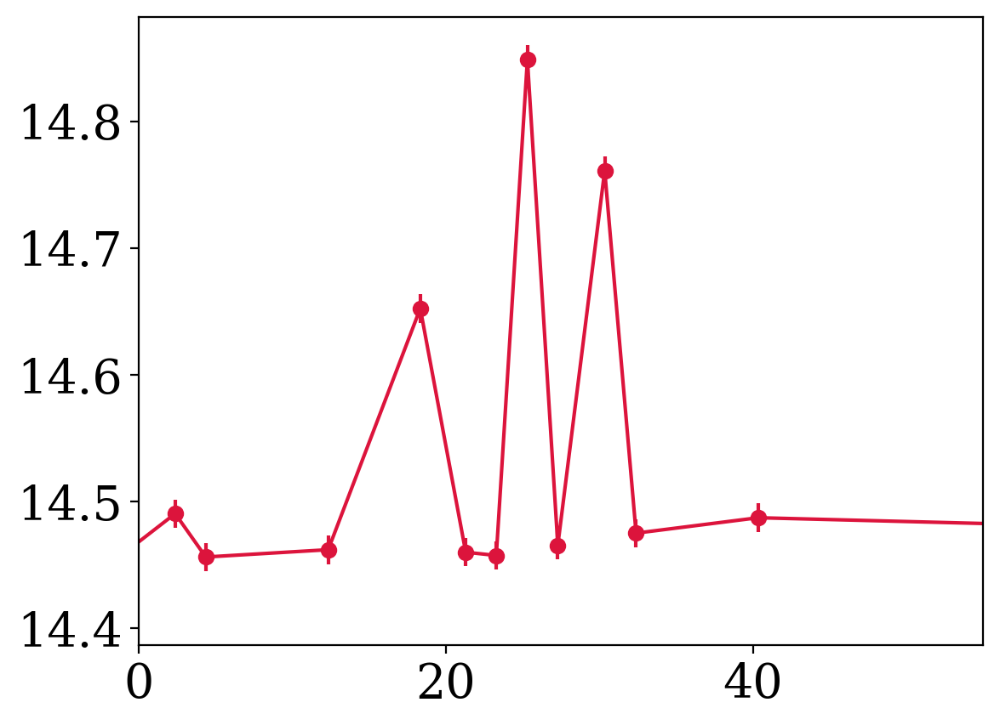

In [13]:
plt.errorbar(time-59_500, mag, magerr, fmt='-o', color='Crimson')
plt.xlim(0, 55)


(15.846122236084193, 14.341089595947414)

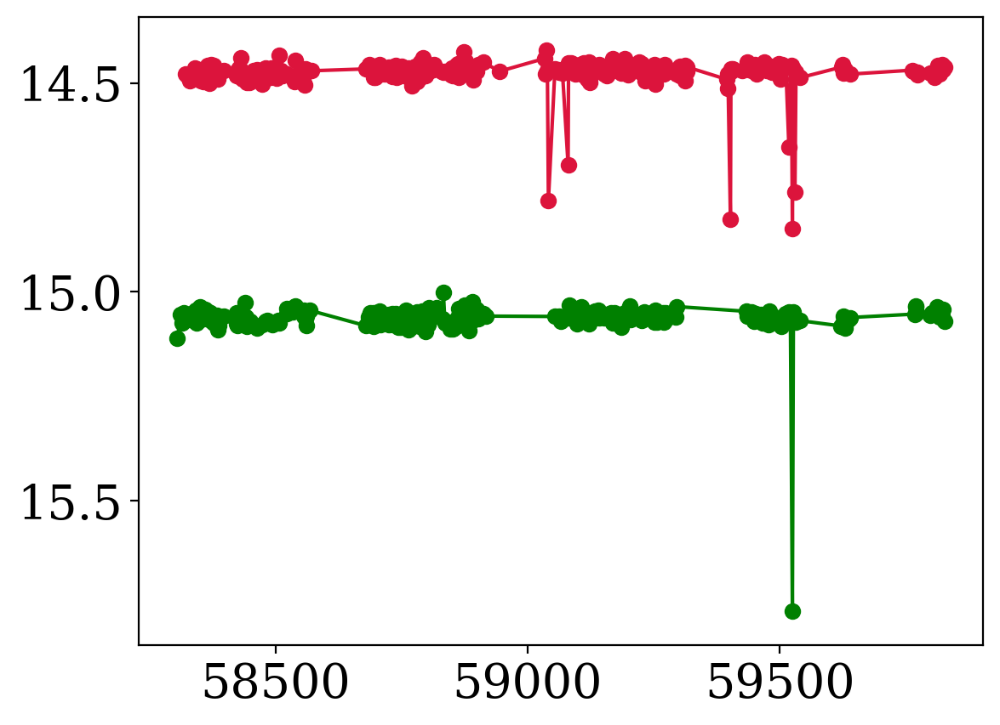

In [14]:
plt.errorbar(time, mag, magerr, fmt='-o', color='Crimson')
plt.errorbar(timeg, magg, magerrg, fmt='-o', color='green')


plt.ylim(plt.ylim()[::-1])

In [15]:
de = dip_pipeline.deviation(mag, magerr, np.mean(mag), np.std(mag))
deG = dip_pipeline.deviation(magg, magerrg, np.mean(magg), np.std(magg))

Text(0, 0.5, '$\\zeta$ [deviation]')

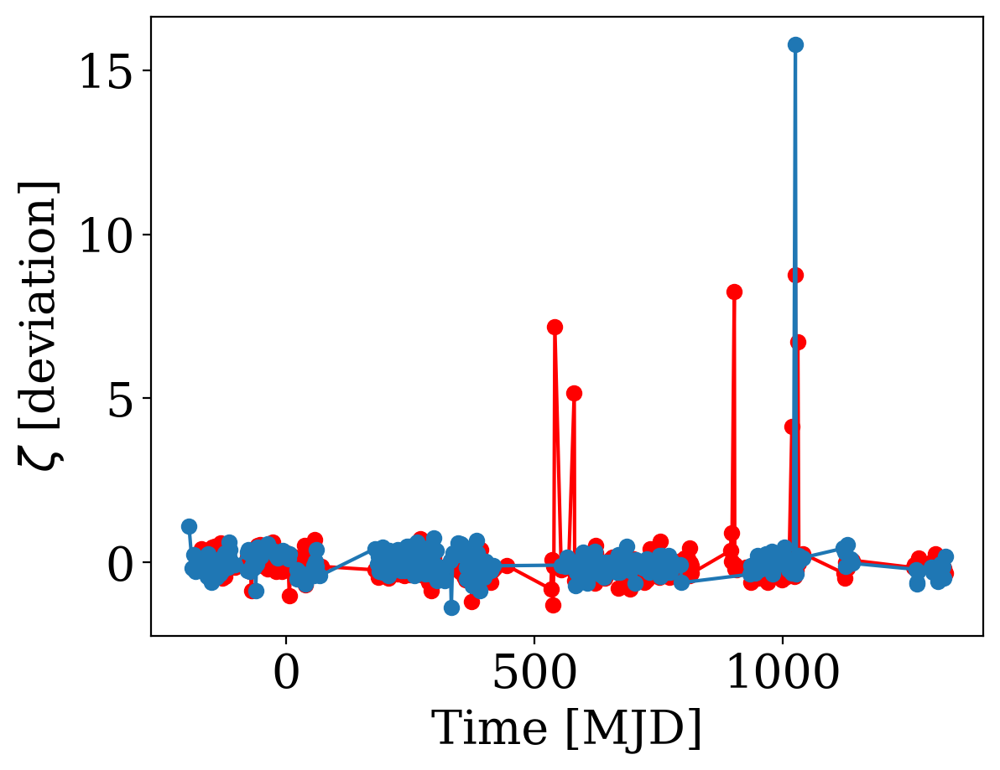

In [16]:
plt.plot(time-58_500, de, 'o-', color='red')
plt.plot(timeg-58_500, deG, 'o-')
plt.xlabel("Time [MJD]")
plt.ylabel("$\zeta$ [deviation]")

In [17]:
%%time
print (evaluate_updated(lc['mjd_ztf_zource'].values,
                   lc['mag_ztf_zource'].values, 
                   lc['magerr_ztf_zource'].values, 
                   lc['catflags_ztf_zource'].values,
                   lc['band_ztf_zource']))

Nphot                   349.000000
biweight_scale            0.013329
frac_above_2_sigma        0.017192
Ndips                     3.000000
rate                      0.001992
chi2dof                   1.016930
skew                      6.731864
kurtosis                 50.929596
mad                       0.009214
stetson_i                33.145760
stetson_j                63.922207
stetson_k                 0.374525
invNeumann                0.083675
best_dip_power           21.658335
best_dip_time_loc     59525.309570
best_dip_start        59521.291390
best_dip_end          59530.345690
best_dip_dt               0.000000
best_dip_ndet             3.000000
lc_score               3764.651826
dtype: float64
CPU times: user 7.66 s, sys: 694 ms, total: 8.35 s
Wall time: 439 ms


In [47]:
import astropy.stats as astro_stats
R, S = astro_stats.biweight.biweight_location(mag), astro_stats.biweight.biweight_scale(mag)
running_deviation = dip_pipeline.deviation(mag, magerr, R, S)
peak_detections = dip_pipeline.peak_detector(time, 
                                             running_deviation, 
                                             power_thresh=4, peak_close_rmv=20, pk_2_pk_cut=20)

    
my_tools.calc_sum_score(time, mag, peak_detections, R, S) # confirm that this is also consistent with the score we estimate

103289.82800918628

## Running Pipeline

In [44]:
# feature evaluation 
column_names = ['Nphot',
    'biweight_scale',
    'frac_above_2_sigma', # in deviation
    'Ndips',
    'rate',
    'chi2dof',
    'skew', 
    'kurtosis',
    'mad',
    'stetson_i',
    'stetson_j',
    'stetson_k',
    'invNeumann',    
    'best_dip_power',
    'best_dip_time_loc',
    'best_dip_start',
    'best_dip_end',
    'best_dip_dt',
    'best_dip_ndet',
    'lc_score']

# Define DataFrame with loc and scale as meta
my_meta = pd.DataFrame(columns=column_names, dtype=float)

In [45]:
%%time
# apply calc_biweight function
calc_ = ens.batch(
    evaluate_updated,
    'mjd_ztf_zource', 'mag_ztf_zource', 
    'magerr_ztf_zource', 'catflags_ztf_zource',
    'band_ztf_zource',
    meta=my_meta,
    use_map=True)

Using generated label, result_1, for a batch result.
CPU times: user 110 ms, sys: 16.4 ms, total: 127 ms
Wall time: 122 ms


In [50]:
%%time
calc_.head(1_000, npartitions=10)

CPU times: user 21 s, sys: 8.35 s, total: 29.4 s
Wall time: 33.2 s


,Nphot,biweight_scale,frac_above_2_sigma,Ndips,rate,chi2dof,skew,kurtosis,mad,stetson_i,stetson_j,stetson_k,invNeumann,best_dip_power,best_dip_time_loc,best_dip_start,best_dip_end,best_dip_dt,best_dip_ndet,lc_score
_hipscat_index,,,,,,,,,,,,,,,,,,,,
213961119105024,269.0,0.015609,0.018587,0.0,0.000000,1.003911,0.289721,0.743892,0.010347,95.148529,64.077812,0.794315,0.692493,NaN,NaN,NaN,NaN,NaN,NaN,NaN
572198062391296,268.0,0.014040,0.018657,0.0,0.000000,1.005126,-0.240236,0.024645,0.008913,23.233597,13.197321,0.779318,0.510219,NaN,NaN,NaN,NaN,NaN,NaN,NaN
471620435050496,217.0,0.013079,0.027650,0.0,0.000000,1.003753,0.198554,2.049891,0.008455,43.642849,35.884365,0.743563,0.602470,NaN,NaN,NaN,NaN,NaN,NaN,NaN
497394970001408,163.0,0.013869,0.000000,0.0,0.000000,1.012015,-4.228230,34.592444,0.008417,111.317398,54.295994,0.606832,0.501397,NaN,NaN,NaN,NaN,NaN,NaN,NaN
778339828629504,216.0,0.012959,0.032407,0.0,0.000000,1.000068,-0.114340,0.443450,0.008190,19.119101,20.018957,0.783205,0.582066,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30574627545677824,247.0,0.012867,0.032389,0.0,0.000000,1.014547,0.613241,1.640722,0.007657,66.591125,40.524063,0.746860,0.775567,NaN,NaN,NaN,NaN,NaN,NaN,NaN
30828687658057728,248.0,0.012120,0.016129,0.0,0.000000,1.004207,-0.329987,0.652126,0.007340,27.404694,21.355305,0.769521,0.558814,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31221926558957568,250.0,0.014558,0.012000,1.0,0.000662,1.000003,0.657509,4.212327,0.009738,36.517708,24.180901,0.755607,0.422658,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [33]:
%%time
ens.object.join(calc_).update_ensemble()

CPU times: user 2.94 s, sys: 217 ms, total: 3.16 s
Wall time: 3.08 s


In [34]:
ens.source.is_dirty()

False

In [ ]:
%%time
full_table = ens.object.compute() # full table compute
# ran on April 4 @ 3:26PM

2024-04-05 17:17:42,886 - distributed.worker - ERROR - Failed to communicate with scheduler during heartbeat.
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1252, in heartbeat
    response = await retry_operation(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils_comm.py", line 455, in retry_operation
    return await retry(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils_comm.py", line 434, in retry
    return await cor

2024-04-05 17:46:05,882 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 17:46:26,026 - distributed.worker.memory - WARNING - gc.collect() took 12.973s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 17:46:26,027 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 37.27 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 17:46:27,232 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 31.34 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 17:46:33,069 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 41.94 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 17:46:35,516 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold:

2024-04-05 17:46:46,457 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45341
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 17:48:39,548 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36932
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 17:49:47,740 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36932
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 546, in connect
    stream = await self.client.connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/tcpclient.py", line 279, in connect
    af, addr, stream = await connector.start(connect_timeout=timeout)
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 456, in wait_for
    return fut.result()
asyncio.exceptions.CancelledError

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_dem

2024-04-05 17:50:09,179 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 17:50:13,826 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 17:50:38,713 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 17:50:41,941 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 17:50:44,439 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 17:50:53,094 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 17:50:57,104 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 17:50:58,139 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 18:01:15,391 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 36.59 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:01:21,485 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 36.45 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:01:25,663 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 37.30 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:01:27,553 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 18:01:33,177 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 34.69 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:01:33,471 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https:/

2024-04-05 18:02:10,590 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39323
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 18:02:32,526 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33087
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 18:02:34,589 - distributed.diskutils - ERROR - Failed to remove '/epyc/ssd/users/atzanida/tmp/dask-scratch-space/worker-vd0xx98p/storage' (failed in <built-in function rmdir>): [Errno 2] No such file or directory: 'storage'
2024-04-05 18:02:34,589 - distributed.diskutils - ERROR - Failed to remove '/epyc/ssd/users/atzanida/tmp/dask-scratch-space/worker-vd0xx98p' (failed in <built-in function rmdir>): [Errno 2] No such file or directory: '/epyc/ssd/users/atzanida/tmp/dask-scratch-space/worker-vd0xx98p'
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/contextlib.py:142: UserWarning: Creating scratch directories is taking a surprisingly long time. (1.50s) This is often due to running workers on a network file system. Consider specifying a local-directory to point workers to write scratch data to a local disk.
  next(self.gen)
2024-04-05 18:02:38,288 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39323
Traceback (most rec

2024-04-05 18:02:47,260 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39323
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 18:03:57,534 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 18:04:02,403 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 18:04:07,971 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 38.76 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:04:14,839 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 33.54 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:04:19,992 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 29.65 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:04:24,360 - distributed.uti

2024-04-05 18:06:00,794 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33083
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 18:06:28,534 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 18:06:31,844 - distributed.worker.memory - WARNING - gc.collect() took 16.270s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 18:06:37,116 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 18:06:46,002 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 18:06:51,836 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 38.37 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:06:57,972 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 31.54 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:07:16,032 - distribute

2024-04-05 18:08:42,279 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34567
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 18:09:38,414 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 18:09:54,374 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 18:10:00,940 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 18:10:01,270 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 18:10:04,432 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 36.01 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:10:14,073 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 38.61 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:10:16,412 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 37.24 Gi

2024-04-05 18:11:06,898 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40864
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 18:11:16,014 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 33.68 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:11:34,388 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 18:11:35,484 - distributed.nanny - WARNING - Restarting worker
2024-04-05 18:11:49,107 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40864
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)


2024-04-05 18:11:59,891 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 41.84 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:12:01,285 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 18:12:08,258 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 18:12:20,855 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 36.88 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:12:27,976 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 18:12:33,784 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 18:12:36,584 - distributed.worker.memory - WARNING - Worker is at 91% memory usage. Pausing worker.  Process memory: 42.64 Gi

2024-04-05 18:13:21,084 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44539
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 18:13:34,956 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44539
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 297, in write
    raise StreamClosedError()
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1152, in send_recv
    await comm.write(msg, serial

2024-04-05 18:18:21,960 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 18:18:27,520 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 18:18:32,078 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 18:18:32,079 - distributed.worker.memory - WARNING - gc.collect() took 31.539s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 18:19:14,528 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 18:19:22,396 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 18:19:22,397 - distributed.worker.memory - WARNING - gc.collect() took 23.698s. This is usually a sign that s

2024-04-05 18:24:50,762 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 30.00 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:24:51,248 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 32.69 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 18:24:53,720 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 18:25:02,205 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 18:25:02,206 - distributed.worker.memory - WARNING - gc.collect() took 23.753s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller t

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_

2024-04-05 18:27:06,821 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 18:27:06,831 - distributed.worker.memory - WARNING - gc.collect() took 21.455s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 18:27:27,841 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 18:28:11,744 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 18:28:18,511 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 18:28:39,897 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 18:28:42,155 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (thresh

In [22]:
len(full_table)

2024-04-05 19:07:22,557 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38686
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2860, in get_data_fro

NameError: name 'full_table' is not defined

Exception ignored in: <bound method GCDiagnosis._gc_callback of <distributed.utils_perf.GCDiagnosis object at 0x7f065db1f7c0>>
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils_perf.py", line 176, in _gc_callback
    def _gc_callback(self, phase, info):
KeyboardInterrupt: 
2024-04-05 19:07:36,263 - distributed.worker.memory - WARNING - gc.collect() took 48.844s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 19:07:36,264 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 37.32 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 19:07:36,835 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#

2024-04-05 19:07:47,544 - distributed.nanny - WARNING - Worker process still alive after 3.1999990844726565 seconds, killing
2024-04-05 19:07:47,545 - distributed.nanny - WARNING - Worker process still alive after 3.199999389648438 seconds, killing
2024-04-05 19:07:47,546 - distributed.nanny - WARNING - Worker process still alive after 3.1999990844726565 seconds, killing
2024-04-05 19:07:50,632 - distributed.nanny - WARNING - Worker process still alive after 3.1999989318847657 seconds, killing
2024-04-05 19:07:52,556 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 35.37 GiB -- Worker memory limit: 46.57 GiB
2024-04-05 19:07:52,585 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 35.37 GiB -- Worke

In [38]:
%%time
demo = ens.object.head(50_000, npartitions=2_000)

2024-04-05 19:17:24,610 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 19:17:28,596 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 19:17:41,652 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 19:17:58,123 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 19:18:02,080 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 19:18:13,964 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 19:18:14,004 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 19:18:16,037 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 19:20:23,132 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 19:20:25,235 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 19:20:27,330 - distributed.utils_perf - WARNING - full garbage collections took 41% CPU time recently (threshold: 10%)
2024-04-05 19:20:30,266 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 19:20:30,662 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 19:20:32,205 - distributed.utils_perf - WARNING - full garbage collections took 39% CPU time recently (threshold: 10%)
2024-04-05 19:20:32,740 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 19:20:33,620 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 19:23:02,883 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 19:23:04,231 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 19:23:12,356 - distributed.utils_perf - WARNING - full garbage collections took 43% CPU time recently (threshold: 10%)
2024-04-05 19:23:14,886 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 19:23:17,783 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 19:23:19,731 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 19:23:24,960 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 19:23:30,315 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 19:27:55,713 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 19:28:13,013 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 19:28:17,682 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 19:28:20,321 - distributed.utils_perf - WARNING - full garbage collections took 40% CPU time recently (threshold: 10%)
2024-04-05 19:28:22,162 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 19:28:28,237 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 19:28:56,819 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 19:28:58,981 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 19:36:40,887 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 19:36:43,804 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 19:37:02,084 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 19:37:19,636 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 19:37:26,434 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 19:37:38,518 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 19:37:49,424 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 19:37:51,881 - distributed.utils_perf - WARNING - full garbage collections took

CPU times: user 27min 50s, sys: 4min 23s, total: 32min 14s
Wall time: 31min 48s


In [51]:
len(demo)

4574

In [ ]:
%%time
full_table = ens.object.compute() # full table compute
# ran on April 3 @ 8AM

2024-04-04 08:28:48,353 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 08:29:30,483 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 08:29:39,850 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 08:29:40,636 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 08:30:00,613 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 08:30:09,818 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 08:30:46,556 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 08:30:52,087 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 08:34:38,056 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 08:34:48,125 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 08:34:52,910 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-04 08:35:01,810 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 08:35:03,144 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 08:35:03,433 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 08:35:04,578 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 08:35:05,707 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 08:38:18,051 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 08:38:31,509 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 08:38:36,761 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 08:38:37,178 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 08:38:38,179 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 08:38:45,555 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 08:38:46,409 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 08:38:48,116 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 08:42:40,353 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 08:42:43,578 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 08:42:45,370 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 08:42:46,884 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 08:42:54,437 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 08:43:01,142 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 08:43:03,667 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 08:43:05,190 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 08:47:25,079 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 08:47:25,079 - distributed.worker.memory - WARNING - gc.collect() took 7.600s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 08:47:26,594 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 08:47:29,489 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 08:47:30,370 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 08:47:30,467 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 08:47:32,412 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (thresho

2024-04-04 08:51:42,651 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 08:51:52,621 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 08:51:56,681 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 08:51:59,765 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 08:52:05,074 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 08:52:10,512 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 08:52:15,439 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 08:52:16,062 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 08:57:44,070 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 08:57:44,226 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 08:57:46,068 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 08:57:56,547 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 08:58:02,811 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 08:58:12,086 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 08:58:17,975 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 08:58:21,456 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 09:05:48,501 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:05:49,874 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 09:05:51,992 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:05:54,087 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:06:07,141 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 09:06:39,915 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:06:40,058 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 09:06:40,689 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 09:13:43,051 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:13:43,980 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 09:13:44,607 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 09:13:44,949 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:13:50,052 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35875 (pid=67266) exceeded 95% memory budget. Restarting...
2024-04-04 09:13:51,308 - distributed.utils_perf - WARNING - full g

2024-04-04 09:13:56,370 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:13:57,626 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 09:13:57,795 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35875
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-package

2024-04-04 09:14:27,976 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:14:28,128 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:14:39,095 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:14:44,964 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 09:14:53,079 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:14:53,080 - distributed.worker.memory - WARNING - gc.collect() took 1

2024-04-04 09:15:04,156 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45140
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 09:16:58,056 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:17:02,709 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:17:02,726 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:17:07,015 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:17:21,517 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:17:21,896 - distributed.wor

2024-04-04 09:20:12,197 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:20:15,231 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:20:16,114 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:20:19,547 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:20:23,292 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 09:20:24,487 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 

2024-04-04 09:23:14,401 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:23:18,265 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:23:19,085 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:23:19,566 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 09:23:36,336 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 09:23:54,412 - distributed.uti

2024-04-04 09:26:41,150 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:26:42,572 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:26:42,806 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:26:42,973 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:26:43,844 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:26:44,020 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04

2024-04-04 09:28:46,438 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:28:46,635 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34095
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_de

2024-04-04 09:29:08,671 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:29:09,687 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.52 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:29:13,594 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:29:14,626 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:29:33,654 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:29:36,787 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:43009 (pid=67248) exceeded 95% memory budget. Restarting...
2024-04-04 09:29:41,635 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43009
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/py

2024-04-04 09:29:45,344 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:29:56,377 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:30:09,841 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:30:13,995 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43009
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/env

2024-04-04 09:31:38,826 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:31:38,827 - distributed.worker.memory - WARNING - gc.collect() took 21.397s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 09:31:38,934 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:31:39,760 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:31:40,871 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. P

2024-04-04 09:32:59,920 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37885
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 09:34:30,413 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:34:31,224 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:34:32,779 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:34:34,908 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 09:34:35,506 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-04 09:36:50,943 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:36:53,944 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:36:54,104 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:37:03,140 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:37:19,651 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:37:22,169 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 

2024-04-04 09:39:35,834 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:39:39,086 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:39:39,324 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:39:49,369 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:39:54,783 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:40:02,892 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 

2024-04-04 09:41:58,640 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:42:01,134 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:36739 -> tcp://127.0.0.1:36091
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/

2024-04-04 09:43:48,578 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 09:43:49,347 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:43:49,876 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:43:51,544 - distributed.worker.memory - WARNING - Worker is at 33% memory usage. Resuming worker. Process memory: 7.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:43:51,635 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:43:51,635 - distributed.work

2024-04-04 09:44:11,585 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 09:44:11,763 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43101
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-04 09:44:43,207 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:44:44,708 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:44:46,880 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:44:48,732 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:44:49,875 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 09:44:51,510 - distributed.uti

2024-04-04 09:46:56,097 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:47:01,978 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:45068 (pid=67301) exceeded 95% memory budget. Restarting...
2024-04-04 09:47:05,286 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45068
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = awai

2024-04-04 09:47:05,669 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45068
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 09:47:48,959 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42180
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 09:48:06,845 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42180
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 09:49:33,052 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:49:35,135 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:49:35,855 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 09:49:37,124 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:49:37,275 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:49:37,809 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 

2024-04-04 09:51:19,051 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:51:24,845 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:51:26,781 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:51:28,324 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:51:28,726 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 13.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:51:28,730 - distributed.wor

2024-04-04 09:52:17,779 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:52:18,080 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 09:52:21,339 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:52:27,401 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:52:30,183 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:52:30,791 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:52:32,561 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:52:33,212 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-04 09:54:23,802 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:54:29,174 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:54:29,791 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:54:30,070 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:54:32,556 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 09:54:32,837 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 

2024-04-04 09:55:23,745 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 15.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:55:24,327 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:55:28,678 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:55:29,309 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:55:31,166 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:55:33,503 - distributed.worker.memory - W

2024-04-04 09:56:09,801 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:56:11,231 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:56:11,444 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 09:56:13,294 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 09:56:15,370 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 09:56:16,281 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 

2024-04-04 09:56:39,972 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 09:56:40,299 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:56:42,094 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 09:56:43,246 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.52 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:56:44,284 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 09:56:44,541 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 09:56:44,730 - distributed.worker - ERRO

2024-04-04 09:57:24,651 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:57:26,721 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:57:29,895 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 09:57:30,922 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:57:39,580 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 09:57:40,526 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 

2024-04-04 09:57:49,455 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:57:49,522 - distributed.nanny - WARNING - Restarting worker
2024-04-04 09:57:53,426 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:57:53,428 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:57:54,520 - distributed.worker.memory - WARNING - Worker is at 48% memory usage. Resuming worker. Process memory: 10.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:57:55,012 - distributed.utils_perf - WARNING - full garbage collections took 31% CP

2024-04-04 09:58:33,889 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:58:34,041 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:58:35,764 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46154 (pid=67239) exceeded 95% memory budget. Restarting...
2024-04-04 09:58:35,871 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 09:58:37,031 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:58:37,154 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-releas

2024-04-04 09:58:38,170 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46154
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 09:59:09,844 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:59:10,125 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:59:10,212 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:59:11,776 - distributed.worker.memory - WARNING - Worker is at 55% memory usage. Resuming worker. Process memory: 12.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 09:59:17,509 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 09:59:19,662 - distributed.uti

2024-04-04 09:59:55,273 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40491
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/

2024-04-04 10:00:40,062 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:00:40,078 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:00:40,179 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:00:40,278 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:00:40,588 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:00:40,700 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-04

2024-04-04 10:02:04,060 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:02:06,190 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 10:02:07,207 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 10:02:09,415 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:02:12,703 - dist

2024-04-04 10:03:40,584 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:03:41,625 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:03:47,527 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 10:03:50,947 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released 

2024-04-04 10:04:39,722 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:04:42,901 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:04:44,763 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:04:45,390 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:04:46,181 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:04:49,325 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0

2024-04-04 10:05:05,889 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:40243 -> tcp://127.0.0.1:42844
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 962, in _handle_write
    num_bytes = self.write_to_fd(self._write_buffer.peek(size))
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1124, in write_to_fd
    return self.socket.send(data)  # type: ignore
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/di

2024-04-04 10:05:48,855 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:05:49,186 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:05:50,356 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:05:50,786 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.29 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:05:53,856 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 1

2024-04-04 10:06:42,477 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 10:06:43,848 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:06:43,848 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:06:45,221 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.70 GiB -- Worker memory limit

2024-04-04 10:07:07,986 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40149
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 10:08:25,104 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 10:08:28,944 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:08:32,758 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:08:34,216 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 10:08:36,395 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:08:36,676 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 

2024-04-04 10:08:44,863 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:08:45,255 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:08:45,354 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:08:45,455 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:08:46,597 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41733
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anac

2024-04-04 10:09:35,684 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:09:39,165 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:09:39,725 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:09:42,178 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit

2024-04-04 10:09:59,346 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 10:09:59,627 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40150
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-04 10:10:24,234 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40243
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 10:10:58,589 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40243
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 10:12:12,649 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37217
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 10:14:22,357 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:14:25,611 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 10:14:32,245 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:14:32,246 - distributed.worker.memory - WARNING - gc.collect() took 4.067s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 10:14:34,197 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:14:36,410 - 

2024-04-04 10:16:09,362 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:16:09,409 - distributed.nanny - WARNING - Restarting worker
2024-04-04 10:16:13,539 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 10:16:18,101 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:16:19,114 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 10:16:19,804 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:16:19,964 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34930
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227,

2024-04-04 10:17:24,954 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:17:25,212 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:17:27,324 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 10:17:30,377 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:17:37,464 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 10:17:50,767 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:17:54,045 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:17:55,540 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 10:20:01,497 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:20:01,650 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:20:15,433 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:20:16,301 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:20:17,971 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:20:19,433 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:20:19,496 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 10:20:19,497 - distributed.worker.memory - WARNING - gc.collect() took 5.150s. 

2024-04-04 10:22:26,798 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:22:28,770 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:22:29,608 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 10:22:33,635 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:22:36,514 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 10:22:38,031 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-04 10:25:26,168 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:25:29,266 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:25:30,378 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:25:36,970 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 10:25:47,164 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:25:47,676 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 10:25:49,341 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:25:53,134 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 10:27:34,404 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:27:34,405 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:27:34,456 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:27:34,463 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:27:34,556 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 142, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed) Ephemeral Worker->Worker for gather local=tcp://127.0.0.1:54698 remote=tcp://127.0.0.1:43182>: Stream is closed
2024-04-04 10:28:01,014 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43182
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/dist

2024-04-04 10:30:51,941 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:30:51,946 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 10:30:58,249 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 10:31:05,979 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 10:31:05,980 - distributed.worker.memory - WARNING - gc.collect() took 10.751s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 10:31:08,333 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:31:15,844 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (thresh

2024-04-04 10:34:56,442 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 10:35:01,204 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:35:05,591 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:35:09,269 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:35:10,985 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:35:14,168 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 10:35:20,112 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:35:24,478 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 10:39:40,076 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:39:42,237 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:39:46,697 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 16.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:39:48,994 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:39:50,910 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:39:51,157 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-mem

2024-04-04 10:39:57,074 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33457
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 10:41:13,932 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:41:18,213 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:41:21,117 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:41:24,712 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:41:25,759 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:41:25,969 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 10:41:25,969 - distributed.worker.memory - WARNING - gc.collect() took 22.633s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks mi

2024-04-04 10:42:54,084 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38627
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2860, in get_data_fro

2024-04-04 10:44:39,651 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 10:44:41,380 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 10:44:50,914 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:44:52,379 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:44:53,750 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:44:56,152 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memor

2024-04-04 10:45:52,981 - distributed.nanny - WARNING - Restarting worker
2024-04-04 10:45:55,431 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:46:03,998 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:46:04,586 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36050
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = awai

2024-04-04 10:47:43,209 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:47:44,453 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:47:45,801 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:47:50,180 - distributed.worker.memory - WARNING - Worker is at 91% memory usage. Pausing worker.  Process memory: 20.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:47:50,318 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 2

2024-04-04 10:47:53,775 - distributed.nanny - WARNING - Restarting worker
2024-04-04 10:47:54,085 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:47:54,095 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35707
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.Str

2024-04-04 10:49:43,641 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:49:43,642 - distributed.worker.memory - WARNING - gc.collect() took 14.199s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 10:49:46,797 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 10:49:50,255 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:49:50,688 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.37 GiB -- Worker memory 

2024-04-04 10:50:34,930 - distributed.nanny - WARNING - Restarting worker
2024-04-04 10:50:38,066 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:50:43,262 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 10:50:44,942 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 10:51:03,196 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42355
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 10:54:20,830 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:54:25,561 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:54:26,942 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. 

2024-04-04 10:55:09,796 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40546
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 10:55:40,445 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:55:48,588 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:55:50,197 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 10:55:51,702 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 10:55:51,717 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:55:51,811 - distributed.worker.memory - WARNING - Unmanaged memory us

2024-04-04 10:56:01,987 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:56:02,180 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:56:02,208 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:56:02,262 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:46534 -> tcp://127.0.0.1:43740
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buff

2024-04-04 10:56:27,576 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:56:32,488 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 10:56:37,271 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 10:56:42,624 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 10:56:47,495 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 10:56:50,759 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:56:53,138 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the mem

2024-04-04 10:58:20,247 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:58:20,546 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:58:20,658 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:58:20,747 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:58:21,972 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 16.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:58:24,220 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04

2024-04-04 10:58:44,973 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 10:58:45,993 - distributed.nanny - WARNING - Restarting worker
2024-04-04 10:58:47,177 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 10:58:47,262 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:39045 (pid=95639) exceeded 95% memory budget. Restarting...
2024-04-04 10:58:49,987 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39045
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    retur

2024-04-04 10:58:59,906 - distributed.nanny - WARNING - Restarting worker
2024-04-04 10:59:04,167 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:59:10,218 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 10:59:11,220 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 10:59:12,333 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:59:15,165 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 10:59:17,835 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 10:59:17,835 - distributed.worker.memory - WARNING - gc.collect() took 13.604s. This is usually a sign that some tasks handle too many 

2024-04-04 11:03:11,583 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:03:12,097 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:03:12,906 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 11:03:12,906 - distributed.worker.memory - WARNING - gc.collect() took 10.594s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 11:03:14,846 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:03:19,134 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:03:25,170 - distributed.utils_perf - WARNING - full garbage coll

2024-04-04 11:07:14,672 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 11:07:15,158 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:07:20,734 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:07:20,785 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:07:29,686 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.20 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 11:07:37,727 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 11:07:40,048 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:07:43,100 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:07:43,101 - distributed.worker.memory - WARNING - gc.collect() took 11.800s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 11:07:43,111 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:07:43,111 - distributed.worker - ERROR - Worker stream died during 

2024-04-04 11:10:18,815 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:10:18,912 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:10:21,653 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46831 (pid=96202) exceeded 95% memory budget. Restarting...
2024-04-04 11:10:23,095 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 11:10:24,433 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:10:24,572 - distributed.worker - ERROR - Worker strea

2024-04-04 11:12:32,973 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 11:12:33,936 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:12:40,120 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 11:12:55,038 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:12:55,717 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 11:12:55,718 - distributed.worker.memory - WARNING - gc.collect() took 6.456s. This is usually a sign that some ta

2024-04-04 11:13:05,812 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:13:13,938 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 11:13:26,087 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:13:28,789 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-04 11:13:32,779 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 11:13:33,030 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 11:13:36,668 - distributed.utils_perf - 

2024-04-04 11:16:37,572 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 11:16:37,676 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:16:39,523 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:16:41,235 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 11:16:48,364 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:16:53,426 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 11:16:54,195 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 11:16:55,056 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 11:19:29,424 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 11:19:30,902 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:19:34,928 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 11:19:42,996 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:19:48,811 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:19:51,856 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:19:57,332 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:19:59,793 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 11:22:03,630 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 11:22:04,183 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:22:05,271 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 11:22:06,516 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 11:22:08,883 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:22:10,209 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 

2024-04-04 11:23:30,702 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40807
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 11:25:44,012 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 11:25:45,430 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33924
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
 

2024-04-04 11:25:49,934 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:25:52,706 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:25:55,814 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:25:56,640 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 11:26:01,553 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:26:10,121 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 11:26:19,312 - distributed.utils_perf - 

2024-04-04 11:28:41,800 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:28:42,980 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 11:28:44,902 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 11:28:49,964 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 11:28:53,732 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:28:53,820 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-04 11:32:11,492 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 11:32:17,859 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:32:26,940 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:32:41,344 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 11:32:42,977 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 11:32:43,211 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:32:44,995 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 11:32:49,648 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 11:35:41,626 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:35:44,201 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:36095 (pid=95256) exceeded 95% memory budget. Restarting...
2024-04-04 11:35:47,426 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36095
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceba

2024-04-04 11:35:47,982 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36095
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 11:37:07,303 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:37:12,345 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:37:12,612 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 11:37:12,782 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34685
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.res

2024-04-04 11:39:36,689 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:39:43,155 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:39:44,095 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:39:47,777 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:39:47,900 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:39:48,917 - distributed.worker.memory - WARNING - Worker is at 77% me

2024-04-04 11:41:35,689 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:41:40,498 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 11:41:42,743 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:41:42,921 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:41:43,527 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.83 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 11:43:54,025 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:43:54,094 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 11:43:54,094 - distributed.worker.memory - WARNING - gc.collect() took 11.866s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 11:43:55,684 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 11:43:55,686 - distributed.worker.memory - WARNING - gc.collect() took 12.382s. This is usually a sign that some tasks handle too many Python ob

2024-04-04 11:45:52,051 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 11:45:52,051 - distributed.worker.memory - WARNING - gc.collect() took 11.532s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 11:45:57,931 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:45:59,501 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:45:59,811 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 15.91 GiB -- Worker memory 

2024-04-04 11:48:03,817 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:48:05,037 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:48:06,531 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 11:48:16,763 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 11:48:17,421 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 11:48:21,805 - distributed.worker.memory - WARNING - Unmanaged memory us

2024-04-04 11:49:43,854 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43076
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 11:50:45,135 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 11:50:49,628 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:50:50,038 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 13.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:50:50,922 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:50:51,070 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:50:53,033 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:50:58,301 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 11:50:59,413 - distributed.utils_perf

2024-04-04 11:51:57,198 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 11:51:59,118 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:51:59,626 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 11:52:01,626 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 11:52:06,683 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:52:07,411 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:52:07,519 - distributed.utils_perf - 

2024-04-04 11:53:08,381 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:53:09,164 - distributed.worker.memory - WARNING - Worker is at 43% memory usage. Resuming worker. Process memory: 9.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:53:18,673 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 11:53:19,836 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37412 (pid=105469) exceeded 95% memory budget. Restarting...
2024-04-04 11:53:20,462 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 11:53:21,436 - distributed.utils_perf - WARNING - full g

2024-04-04 11:53:26,638 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:53:27,658 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 11:53:29,703 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:53:32,670 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 11:53:32,981 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37412
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = se

2024-04-04 11:55:13,191 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:55:13,353 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:55:13,490 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:55:18,522 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 11:55:23,253 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 11:55:23,579 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-04 11:55:55,104 - distributed.nanny - WARNING - Restarting worker
2024-04-04 11:55:55,224 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38571
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-04 11:56:25,886 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44828
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 11:57:21,820 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:57:24,349 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 11:57:25,467 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:57:27,183 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:57:27,703 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 11:57:27,705 - distributed.wor

2024-04-04 11:58:24,234 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41690
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 11:58:40,349 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:58:48,818 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:58:51,430 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 11:58:51,434 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-04 11:59:35,135 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:32865
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 12:01:13,625 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:01:13,630 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:01:15,546 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:01:23,279 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 12:01:30,219 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:01:33,510 - distributed.worker.memory - WARNING - Worker is at 81% me

2024-04-04 12:02:19,096 - distributed.nanny - WARNING - Restarting worker
2024-04-04 12:02:19,264 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:02:22,569 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:02:22,569 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41183
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packa

2024-04-04 12:03:33,242 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 12:03:37,891 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:03:45,256 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:03:45,814 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 12:03:54,926 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-04 12:05:21,552 - distributed.nanny - WARNING - Restarting worker
2024-04-04 12:05:21,587 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41190
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last)

2024-04-04 12:06:45,443 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:06:45,443 - distributed.worker.memory - WARNING - gc.collect() took 15.814s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:06:45,443 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:06:45,553 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 12:06:47,168 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41517 (pid=108704) exceeded 95% memory budget. Restarting...
2024-04-04 12:06:50,526 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41517
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3

2024-04-04 12:07:50,354 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:07:51,238 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:07:55,248 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 12:08:00,773 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:08:01,833 - dist

2024-04-04 12:09:03,904 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34066
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 12:09:47,817 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 12:10:00,362 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:10:01,079 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 12:10:05,475 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 12:10:08,333 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 12:10:10,224 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-04 12:12:25,446 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:12:26,202 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:12:27,845 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:12:29,145 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:12:31,866 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:12:38,589 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 

2024-04-04 12:13:08,129 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 12:13:09,314 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 12:13:09,510 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 12:13:12,721 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:13:15,329 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:13:17,538 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.42 GiB -- Worker memory limit: 22.35

2024-04-04 12:14:43,200 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 12:14:43,201 - distributed.worker.memory - WARNING - gc.collect() took 2.796s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:14:43,202 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:14:44,838 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:14:45,436 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:14:47,265 - 

2024-04-04 12:14:59,357 - distributed.nanny - WARNING - Restarting worker
2024-04-04 12:15:00,537 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45374
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-04 12:15:53,204 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:15:53,247 - distributed.nanny - WARNING - Restarting worker
2024-04-04 12:15:55,335 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 12:15:56,516 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:16:00,305 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 12:16:01,867 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 12:16:09,702 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:16:09,707 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may i

2024-04-04 12:17:29,177 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:17:35,030 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:17:36,648 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35876 (pid=123207) exceeded 95% memory budget. Restarting...
2024-04-04 12:17:37,442 - distributed.worker.memory - WARNING - Worker is at 57% memory usage. Resuming worker. Process memory: 12.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:17:39,250 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35876
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/t

2024-04-04 12:17:59,782 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:18:02,155 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:18:03,452 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:18:03,882 - distributed.nanny - WARNING - Restarting worker
2024-04-04 12:18:07,923 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:18:08,608 - distributed.utils_perf - WARNING - full garbage collections took 26% CP

2024-04-04 12:18:31,599 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44854
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 12:19:50,758 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42393
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 12:21:09,999 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:21:25,059 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:21:25,062 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:21:26,820 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 12:21:27,058 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:21:27,458 - distributed.worker.memory - WARNING - Worker is at 78% me

2024-04-04 12:23:03,800 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:23:03,800 - distributed.worker.memory - WARNING - gc.collect() took 11.866s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:23:05,454 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.26 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:23:06,425 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 12:23:11,575 - distributed.worker.memory - WARNING - gc.collect() took 1.263s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:23:12,686 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:39202 (pid=124572) exce

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/

2024-04-04 12:24:41,887 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:24:42,068 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:24:45,657 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:24:50,208 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 12:24:57,021 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:24:57,914 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:24:58,316 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:24:59,512 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 12:27:24,699 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:27:26,870 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:27:31,845 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 12:27:36,046 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 12:27:36,081 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:27:36,614 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 12:27:41,282 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:27:43,168 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 12:30:11,058 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:30:13,484 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 12:30:30,276 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:30:34,151 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:30:36,064 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:30:37,966 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:30:39,302 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 12:30:40,184 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 12:32:00,908 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41123
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 12:34:18,533 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:34:18,718 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 12:34:23,443 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:34:24,096 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:34:26,020 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:34:32,345 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 12:34:35,078 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 12:34:55,343 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 12:38:07,920 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:38:22,487 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:38:22,487 - distributed.worker.memory - WARNING - gc.collect() took 5.444s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:38:22,487 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:38:22,844 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:38:35,096 - 

2024-04-04 12:41:31,685 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 12:41:32,200 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:41:48,112 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 12:41:49,914 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:41:50,901 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:41:51,273 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 12:42:00,972 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:42:03,506 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 12:47:09,389 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:47:12,311 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 12:47:12,312 - distributed.worker.memory - WARNING - gc.collect() took 12.598s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:47:12,837 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 13.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:47:22,756 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 12:47:22,756 - distributed.worker.memory - WARNING - gc.collect() took 11.545s. This is usually a sign that some tasks handle too many Python objects at th

2024-04-04 12:49:40,661 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:49:41,062 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 12:50:00,205 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 12:50:00,443 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 12:50:02,600 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 12:50:24,734 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 12:50:28,709 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:50:28,710 - distributed.worker.memory - WARNING - gc.collect() took 8.767s. 

2024-04-04 12:53:10,086 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:53:14,853 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 12:53:22,047 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 12:53:22,234 - distributed.worker.memory - WARNING - gc.collect() took 7.490s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:53:24,554 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be relea

2024-04-04 12:53:40,863 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40048
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 12:53:46,395 - distributed.nanny - WARNING - Restarting worker
2024-04-04 12:53:54,030 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 12:54:06,923 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:54:10,402 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:54:15,090 - distributed.worker.memory - WARNING - Worker is at 80% memor

2024-04-04 12:55:39,754 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:55:45,585 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 12:55:45,586 - distributed.worker.memory - WARNING - gc.collect() took 15.082s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 12:55:48,755 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:55:49,079 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  P

2024-04-04 12:56:10,571 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:56:11,666 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:56:12,953 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46500
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback

2024-04-04 12:56:54,575 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:56:55,717 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:56:56,552 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:56:56,816 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.17 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:56:59,926 - distributed.worker.memory - WARNING - Worker is at 55% memory usage. Resuming worker. Process memory: 1

2024-04-04 12:59:26,523 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 12:59:27,498 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:59:28,736 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 12:59:30,640 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:59:30,653 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 12:59:30,896 - distributed.uti

2024-04-04 13:02:13,075 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:02:17,145 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:02:24,796 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:02:26,643 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit

2024-04-04 13:02:49,584 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40775
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 13:03:42,729 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:03:43,017 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:03:43,430 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:03:50,874 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 13:03:54,316 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.07 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 13:04:06,359 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38807
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 13:05:24,242 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:05:28,430 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:05:30,014 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:05:31,599 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (thre

2024-04-04 13:07:11,501 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:07:11,502 - distributed.worker.memory - WARNING - gc.collect() took 16.840s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 13:07:15,024 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:07:21,354 - distributed.worker.memory - WARNING - Worker is at 91% memory usage. Pausing worker.  Process memory: 20.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:07:21,425 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:07:21,468 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/l

2024-04-04 13:07:28,425 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:07:29,701 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:07:32,496 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 13:07:37,035 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:07:38,941 - distributed.worker.memory - WARNING - Worker is at 80% memor

2024-04-04 13:08:53,160 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:08:53,742 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:08:53,842 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:08:53,951 - distributed.worker.memory - WARNING - Worker is at 41% memory usage. Resuming worker. Process memory: 9.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:08:58,939 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 13:09:00,177 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:09:01,554 - distributed.worker.memory -

2024-04-04 13:10:07,507 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:10:08,183 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:10:12,553 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:10:13,829 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:10:19,284 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 13:10:19,387 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40487
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_

2024-04-04 13:11:12,316 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:11:12,694 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34933
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/

2024-04-04 13:11:23,406 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 13:11:23,623 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:11:27,825 - distributed.worker.memory - WARNING - Worker is at 59% memory usage. Resuming worker. Process memory: 13.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:11:32,551 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:11:33,779 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:11:35,200 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 13:11:38,254 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.88 GiB -- Worker me

2024-04-04 13:13:24,347 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:13:27,680 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:13:28,177 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 13:13:32,273 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:13:33,668 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:13:34,787 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-04 13:14:28,053 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 13.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:14:32,234 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:14:35,452 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 13:14:35,702 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 13:14:37,869 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:14:43,153 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 13:16:57,086 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:17:07,414 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 13:17:14,088 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 13:17:15,912 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:17:18,121 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:17:19,334 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 13:17:19,959 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:17:20,234 - distributed.utils_perf

2024-04-04 13:19:39,021 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:19:41,177 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:19:43,233 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 13:19:44,822 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:19:48,401 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:19:51,237 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:19:52,733 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:19:55,773 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 13:22:06,825 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:22:09,335 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:22:09,872 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:22:10,739 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:22:14,814 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.71 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 13:22:22,063 - distributed.worker.memory - WARNING - Worker is at 43% memory usage. Resuming worker. Process memory: 9.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:22:23,070 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:22:25,860 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 13:22:27,952 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:22:30,719 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:22:31,504 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory 

2024-04-04 13:23:21,766 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:23:24,198 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:23:25,728 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:23:26,366 - distributed.worker.memory - WARNING - Worker is at 39% memory usage. Resuming worker. Process memory: 8.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:23:34,655 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:23:34,990 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04

2024-04-04 13:24:18,986 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:24:20,734 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:24:20,734 - distributed.worker.memory - WARNING - gc.collect() took 1.848s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 13:24:22,176 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:24:24,728 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:24:25,440 - distributed.ut

2024-04-04 13:25:07,096 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:25:07,207 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46326
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-04 13:26:42,494 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:26:45,250 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:26:45,598 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:26:47,546 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:26:47,921 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:26:51,897 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:26:52,131 - distributed.worker.memory - WARNING - Worker is at 70% memory usage.

2024-04-04 13:27:30,657 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:27:31,350 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41957
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-04 13:28:57,595 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:29:07,707 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:29:08,908 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:29:09,489 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:29:09,826 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:29:36,604 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:29:38,679 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:29:43,059 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 13:32:01,569 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:32:02,572 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:32:02,702 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:32:03,614 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:32:04,495 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:32:09,543 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:32:14,602 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:32:18,182 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 13:34:43,701 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:34:45,244 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 13:34:46,229 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:34:49,579 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:34:52,311 - distributed.worker.memory - WARNING - Worker is at 92% memory usage. Pausing worker.  Process memory: 20.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:34:53,978 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37075 (pid=124679) exceeded 95% memory budget. Restarting...
2024-04-04 13:34:54,444 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:34:55,638 - distr

2024-04-04 13:34:58,095 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:34:58,313 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:34:58,313 - distributed.worker.memory - WARNING - gc.collect() took 4.378s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 13:35:02,341 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37075
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]


2024-04-04 13:35:40,282 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39398
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 13:36:16,339 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:36:17,102 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:34776 (pid=5285) exceeded 95% memory budget. Restarting...
2024-04-04 13:36:19,213 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 13:36:20,238 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:36:20,613 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:36:21,326 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34776
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_

2024-04-04 13:37:18,912 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 15.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:37:28,166 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:37:37,526 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:37:37,526 - distributed.worker.memory - WARNING - gc.collect() took 23.276s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 13:37:37,527 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:37:39,028 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.27 GiB -- Worker memory limit: 22.3

2024-04-04 13:38:00,493 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:38:02,313 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35656
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-04 13:39:23,121 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 13:39:27,609 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 13:39:29,354 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:39:29,852 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:39:30,670 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:39:30,894 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-04 13:41:36,526 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 13:41:37,999 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 13:41:39,685 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:41:45,424 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 13:41:46,212 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:41:49,044 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:41:51,685 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:41:52,999 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-04 13:44:08,121 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 13:44:16,342 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:44:20,680 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:44:23,328 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:44:25,322 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:44:27,787 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.78 GiB -- Worker memory limit: 22.35

2024-04-04 13:46:48,039 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 13:46:48,522 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:33700 (pid=125535) exceeded 95% memory budget. Restarting...
2024-04-04 13:46:50,716 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:46:51,530 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33700
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream

2024-04-04 13:46:53,433 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:46:59,080 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:47:00,437 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:47:00,727 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 13:47:00,937 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:47:04,142 - distributed.utils_perf - WARNING - full garbage collections took 26% CP

2024-04-04 13:49:22,612 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:49:30,862 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 13:49:36,104 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:49:39,019 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 13:49:43,802 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 13:49:46,086 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:49:48,011 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:49:55,218 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-04 13:51:53,203 - distributed.worker.memory - WARNING - Worker is at 49% memory usage. Resuming worker. Process memory: 11.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:52:01,711 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:52:06,444 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:52:17,166 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:52:17,167 - distributed.worker.memory - WARNING - gc.collect() took 7.685s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 13:52:21,859 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:52:22,522 - distributed.utils_perf - WARNING - full garbage colle

2024-04-04 13:54:22,749 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 13:54:22,750 - distributed.worker.memory - WARNING - gc.collect() took 14.150s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 13:54:23,638 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:54:26,776 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:54:28,004 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 13:54:31,466 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 13:54:43,024 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (thresh

2024-04-04 13:56:49,817 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:56:54,077 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 13:56:58,008 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 13:57:05,599 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:57:08,895 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:57:10,365 - distributed.worker.memory - WARNING - Worker is at 55% memory usage. Resuming worker. Process memory: 12.38 GiB -

2024-04-04 13:58:28,283 - distributed.nanny - WARNING - Restarting worker
2024-04-04 13:58:36,859 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:58:47,305 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 13:58:50,844 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 13:58:51,133 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os f

2024-04-04 14:00:16,286 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36415
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 14:00:39,087 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44133
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 14:04:30,598 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 14:04:38,108 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 14:04:59,964 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 14:05:00,917 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:05:04,827 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:05:12,651 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 14:05:13,416 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:05:15,005 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 14:08:45,353 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:08:56,895 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 14:09:06,989 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 14:09:12,645 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:09:14,696 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:09:18,069 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 

2024-04-04 14:13:47,432 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 14:13:53,232 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 14:14:08,932 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:14:09,740 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 14:14:28,565 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:14:39,899 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.09 GiB -- Worker memory limit: 22.35

2024-04-04 14:17:24,499 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:17:25,173 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:43390 -> tcp://127.0.0.1:38437
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3

2024-04-04 14:17:42,219 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:17:45,839 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:17:45,907 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34182
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker

2024-04-04 14:19:04,741 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:19:06,272 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:19:06,945 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:19:08,503 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:19:09,373 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 1

2024-04-04 14:20:37,901 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:20:41,820 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:20:41,963 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:20:42,017 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:20:43,589 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-04 14:21:57,042 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:21:59,190 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:22:04,099 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 14:22:07,153 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:22:08,965 - dist

2024-04-04 14:22:35,361 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 14:22:37,059 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43390
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/

2024-04-04 14:23:56,891 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46147 (pid=5870) exceeded 95% memory budget. Restarting...
2024-04-04 14:23:57,995 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:24:00,269 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46147
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.

2024-04-04 14:24:03,130 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:24:07,376 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:24:08,331 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:24:11,811 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 8.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:24:14,178 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; s

2024-04-04 14:26:49,678 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:26:51,812 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:26:51,953 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:26:52,312 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:26:54,413 - distributed.worker.memory - WARNING - Worker is at 35% memory usage. Resuming worker. Process memory: 7.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:26:57,093 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 

2024-04-04 14:29:39,586 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:29:41,502 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 14:29:49,500 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.26 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:29:53,283 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:29:53,840 - dist

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_recv
    response = await comm.read(deserializers=deserializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 142, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed) Ephemeral Worker->Worker for gather local=tcp://127.0.0.1:40616 remote=tcp://127.0.0.1:36241>: Stream is closed
2024-04-04 14:31:24,622 - distributed.worker - ERROR - Worker stream died du

2024-04-04 14:32:58,941 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 14:32:59,633 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:33:00,370 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 14:33:10,710 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:33:10,718 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 14:33:12,109 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 14:33:39,011 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:33:39,011 - distributed.worker.memory - WARNING - gc.collect() took 16.711s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:33:40,899 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 14:33:46,006 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:33:46,114 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:33:46,366 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/l

2024-04-04 14:34:29,482 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:34:32,277 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:34:45,368 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 14:34:45,368 - distributed.worker.memory - WARNING - gc.collect() took 10.590s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:34:46,806 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 14:34:48,963 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged mem

2024-04-04 14:37:53,884 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:37:55,029 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:37:58,067 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:38:05,327 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:38:11,725 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:38:12,359 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 14:39:22,232 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 14:39:23,647 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:39:25,753 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 14:39:26,673 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:39:31,138 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:39:38,763 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:39:50,798 - distributed.utils_perf - 

2024-04-04 14:42:01,047 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:42:02,932 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:42:06,420 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:42:10,024 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:42:14,516 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:42:16,109 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-04 14:45:51,427 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:46:03,755 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:46:04,034 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 14:46:08,358 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:46:12,016 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 14:46:14,504 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 14:46:16,401 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:46:18,492 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 14:48:31,268 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:48:31,268 - distributed.worker.memory - WARNING - gc.collect() took 23.642s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:48:34,423 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 14:48:34,430 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:48:37,618 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 14:48:44,112 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 14:48:45,354 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory

2024-04-04 14:49:09,275 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:49:09,879 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36684
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-04 14:50:00,744 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:50:03,233 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:50:03,234 - distributed.worker.memory - WARNING - gc.collect() took 8.698s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:50:03,234 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:50:05,598 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:38894 -> tcp://127.0.0.1:41445
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_de

2024-04-04 14:50:32,459 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:50:36,130 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:50:37,320 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:40181 (pid=31133) exceeded 95% memory budget. Restarting...
2024-04-04 14:50:40,441 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40181
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, b

2024-04-04 14:50:48,445 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 14:50:48,470 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:50:50,041 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:50:54,368 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 14:50:54,368 - distributed.worker.memory - WARNING - gc.collect() took 17.881s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller t

2024-04-04 14:51:17,315 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:51:25,045 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:51:26,137 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 14:51:26,138 - distributed.worker.memory - WARNING - gc.collect() took 24.593s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:51:26,272 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:51:26,284 - distributed.worker - ERROR - Worker stream died during 

2024-04-04 14:52:46,569 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:52:58,862 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:52:59,034 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:52:59,672 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.38 GiB -- Worker memory limit

2024-04-04 14:53:40,731 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:53:41,791 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:53:41,791 - distributed.worker.memory - WARNING - gc.collect() took 7.617s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:53:41,872 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:53:42,011 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:53:42,171 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memor

2024-04-04 14:54:09,437 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 14:54:09,543 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35598
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-04 14:54:48,730 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:54:49,925 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-04 14:54:57,667 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 14:54:59,352 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:55:03,521 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:55:05,599 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 

2024-04-04 14:56:30,115 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 14:56:31,297 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:56:32,384 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:56:32,625 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:56:33,087 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:56:33,925 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pa

2024-04-04 14:57:24,996 - distributed.nanny - WARNING - Restarting worker
2024-04-04 14:57:26,874 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 14:57:31,041 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 14:57:36,741 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 14:57:36,920 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:57:41,063 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:57:41,936 - distributed.utils_perf - 

2024-04-04 14:58:02,125 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 11.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:58:04,264 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 14:58:04,265 - distributed.worker.memory - WARNING - gc.collect() took 3.133s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 14:58:05,732 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:58:06,442 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:58:07,315 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 14:58:18,174 - distributed.utils_perf - WARNING - full garbage colle

2024-04-04 14:59:25,161 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 14:59:26,514 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 14:59:26,846 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 14:59:27,239 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 14:59:29,851 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 14:59:30,331 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-04 15:00:07,007 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:00:07,573 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:00:07,702 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35078
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_d

2024-04-04 15:01:25,068 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 15:01:39,007 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:01:39,288 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:01:40,021 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 15:01:43,307 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:01:43,680 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:01:43,707 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:01:46,842 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 15:04:11,192 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:04:14,282 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:04:16,372 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:04:17,160 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 15:04:17,885 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:04:18,826 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memor

2024-04-04 15:05:17,845 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45636
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 15:08:14,867 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 15:08:16,206 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:08:19,359 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:08:19,359 - distributed.worker.memory - WARNING - gc.collect() took 15.701s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:08:24,590 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:08:33,576 -

2024-04-04 15:10:15,657 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37456
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 15:10:52,765 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:10:53,992 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:10:59,937 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:11:05,558 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:11:07,422 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 15:11:08,290 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 

2024-04-04 15:12:19,263 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:12:25,193 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:12:28,057 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:12:33,900 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:12:36,329 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 15:12:36,508 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 15:12:36,508 - distributed.worker.memory - WARNING - gc.collect() took 12.904s. This is usually a sign that some tasks handle

2024-04-04 15:15:02,417 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:15:03,620 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:15:03,691 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:15:04,645 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 15:15:04,645 - distributed.worker.memory - WARNING - gc.collect() took 5.055s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:15:04,646 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the 

2024-04-04 15:18:13,063 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 15:18:14,426 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:18:14,428 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:18:15,682 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 15:18:16,128 - distributed.worker.memory - WARNING - Worker is at 33% memory usage. Resuming worker. Process memory: 7.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:18:17,336 - distributed.util

2024-04-04 15:21:03,470 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:21:03,668 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:21:05,824 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:21:05,825 - distributed.worker.memory - WARNING - gc.collect() took 8.787s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:21:11,869 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 15:21:13,385 - 

2024-04-04 15:21:58,094 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 15:22:01,366 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 15:22:01,366 - distributed.worker.memory - WARNING - gc.collect() took 7.725s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:22:01,500 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:22:02,026 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:22:03,128 - distributed.worker.memory - WARNING - Worker is at 80% m

2024-04-04 15:22:14,491 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:22:17,132 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:22:17,431 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:22:19,836 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 15:22:22,411 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:22:29,758 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:22:34,638 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-0

2024-04-04 15:24:05,872 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:24:08,722 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:24:09,324 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:24:10,046 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:24:10,527 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:24:10,761 - distributed.uti

2024-04-04 15:25:14,723 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35105
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 15:26:08,643 - distributed.worker.memory - WARNING - Worker is at 52% memory usage. Resuming worker. Process memory: 11.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:26:12,197 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:26:12,455 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:26:19,772 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:26:21,286 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:26:22,230 - distributed.worker.memory - WARNING - Worker is at 80% me

2024-04-04 15:27:00,339 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 16.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:27:03,166 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 15:27:03,801 - distributed.worker.memory - WARNING - gc.collect() took 19.894s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:27:03,802 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:27:03,812 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unm

2024-04-04 15:27:29,933 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:27:30,048 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41425
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-04 15:27:38,189 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44386
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 15:29:24,922 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:29:26,913 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 15:29:26,913 - distributed.worker.memory - WARNING - gc.collect() took 9.539s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:29:26,921 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:29:27,442 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 20.22 GiB -- Worker memory l

2024-04-04 15:32:34,937 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 15:32:40,128 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:32:47,715 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:32:49,933 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 15:32:51,364 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:32:58,259 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:32:58,259 - distributed.worker.memory - WARNING - gc.collect() took 8.091s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks mig

2024-04-04 15:35:33,037 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:35:37,390 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 15:35:43,219 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:35:52,103 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 15:35:54,208 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:35:54,853 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 15:35:55,213 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-04 15:36:36,833 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 15:36:47,263 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 15:36:47,837 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 15:36:58,211 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:37:11,562 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:37:11,733 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 

2024-04-04 15:40:21,790 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:40:21,801 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:40:22,471 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:40:24,550 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:40:30,871 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 15:40:30,871 - distributed.wor

2024-04-04 15:43:35,581 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:43:35,851 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:43:37,564 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:43:38,155 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:43:41,413 - distributed.worker.memory - WARNING - Worker is at 47% memory usage. Resuming worker. Process memory: 10.59 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 15:45:04,780 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:45:05,510 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:45:07,040 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46012 (pid=34459) exceeded 95% memory budget. Restarting...
2024-04-04 15:45:11,085 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46012
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida

2024-04-04 15:45:11,943 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46012
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 15:46:05,691 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:46:09,921 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:46:11,797 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:46:14,022 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:46:19,097 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 15:46:21,394 - distributed.wor

2024-04-04 15:47:09,819 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:47:13,432 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:47:15,641 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:47:17,193 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:47:17,725 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:47:18,079 - distributed.utils_perf - WARNING - full garbage collections took 18% CP

2024-04-04 15:47:59,179 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:01,632 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:06,069 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:06,912 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Proces

2024-04-04 15:48:23,393 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:23,499 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:48:23,595 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:25,292 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:27,830 - distributed.utils_

2024-04-04 15:48:51,460 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:48:52,443 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:49:00,001 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:49:01,367 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41346
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, a

2024-04-04 15:49:15,567 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:49:18,120 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 15:49:18,444 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:32873
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3

2024-04-04 15:49:54,187 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:49:55,083 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:50:03,604 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:50:03,762 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:50:03,899 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 15:50:03,899 - distributed.wor

2024-04-04 15:50:56,227 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42736
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 15:51:23,383 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:51:29,482 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:51:36,932 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:51:39,831 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:51:39,831 - distributed.worker.memory - WARNING - gc.collect() took 6.948s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 15:51:48,763 - 

2024-04-04 15:53:11,687 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38557
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 15:54:01,405 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35023
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 15:55:36,261 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:55:36,475 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:55:38,103 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:55:41,380 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:55:44,374 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 15:55:47,078 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 15:56:31,486 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:56:31,525 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46640
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-04 15:56:55,881 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:56:56,358 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 15:56:57,136 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 15:56:57,619 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 15:57:01,479 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46640
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 546, in connect
    stream = await self

2024-04-04 15:57:36,253 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 15:57:36,958 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:57:38,252 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 15:57:39,542 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 15:57:39,645 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:34076 -> tcp://127.0.0.1:46408
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
Connect

2024-04-04 15:58:12,047 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 15:58:13,033 - distributed.nanny - WARNING - Restarting worker
2024-04-04 15:58:15,248 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 15:58:22,438 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 15:58:23,348 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 15:58:24,737 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 15:58:29,657 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 15:58:31,278 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 15:58

2024-04-04 16:01:02,717 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 16:01:03,267 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 16:01:03,393 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:01:08,169 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:01:08,169 - distributed.worker.memory - WARNING - gc.collect() took 5.420s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:01:10,316 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:01:13,983 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (thresho

2024-04-04 16:03:25,538 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:03:27,930 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 16:03:28,746 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:03:28,781 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:03:29,364 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:03:31,146 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:03:35,148 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:03:36,271 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 16:05:39,844 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 16:05:42,848 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:05:42,848 - distributed.worker.memory - WARNING - gc.collect() took 6.408s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:05:43,763 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 16:05:45,138 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:05:47,497 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:05:49,666 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (thresho

2024-04-04 16:06:47,763 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.52 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:06:51,043 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 11.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:06:54,134 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:06:59,147 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:06:59,393 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:07:09,458 - distributed.worker.memory - WARNING - Worker is at 95% me

2024-04-04 16:07:14,745 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:45703 -> tcp://127.0.0.1:45102
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 297, in write
    raise StreamClosedError()
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1782, in get_data
    compressed = await comm.write(msg, serializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 307, in write
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 142, in convert_strea

2024-04-04 16:08:56,426 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 16:08:56,427 - distributed.worker.memory - WARNING - gc.collect() took 2.466s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:08:57,374 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 16:08:57,400 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 16:08:57,452 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:08:57,577 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-release

2024-04-04 16:10:51,465 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:10:58,670 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:11:01,533 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:11:01,533 - distributed.worker.memory - WARNING - gc.collect() took 8.412s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:11:01,719 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be relea

2024-04-04 16:13:17,756 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:13:18,910 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:13:19,726 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:13:29,166 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:13:29,243 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:13:30,138 - distributed.worker.memory - WARNING - Worker is at 69% me

2024-04-04 16:15:10,463 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:15:12,253 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 16:15:12,952 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45703
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_d

2024-04-04 16:15:13,977 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45703
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 16:15:38,685 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 16:15:48,646 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:15:49,346 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:15:51,610 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:15:51,757 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45703
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3

2024-04-04 16:18:08,485 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:18:16,906 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:18:18,070 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:18:26,555 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 16:18:36,063 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:18:37,926 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 16:18:43,282 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 16:18:44,707 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 16:21:24,467 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:21:26,738 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:21:34,149 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:21:37,858 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 16.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:21:37,894 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:21:38,137 - distributed.uti

2024-04-04 16:23:41,932 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:23:43,831 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:23:43,975 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:23:46,604 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:23:46,604 - distributed.worker.memory - WARNING - gc.collect() took 10.757s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:23:48,430 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 16:23:52,121 - distribute

2024-04-04 16:24:34,675 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:24:35,249 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:24:38,286 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 16:24:38,286 - distributed.worker.memory - WARNING - gc.collect() took 12.719s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:24:38,287 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:24:44,932 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the

2024-04-04 16:26:21,206 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:26:21,660 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:26:21,735 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:26:22,173 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:26:29,129 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.39 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 16:27:38,365 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:27:42,000 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:27:43,091 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:27:43,559 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released 

2024-04-04 16:28:31,204 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34976
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 16:29:03,151 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:29:07,316 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 16:29:07,997 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:29:13,324 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:29:14,000 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:29:16,392 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:29:17,018 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:29:17,781 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 16:32:49,960 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:32:51,670 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:32:54,011 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:33:00,837 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:33:00,985 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 16:33:00,985 - distributed.worker.memory - WARNING - gc.collect() took 8.705s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:33:03,139 - distributed.utils_perf - WARNING - full garbage colle

2024-04-04 16:36:49,477 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:36:49,776 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:36:49,876 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:36:49,976 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:36:49,980 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:37:03,988 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https:/

2024-04-04 16:37:37,461 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:37:38,333 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:39724 -> tcp://127.0.0.1:40198
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/

2024-04-04 16:38:09,693 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34825
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 16:39:20,352 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:39:25,109 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:39:25,192 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41890
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-package

2024-04-04 16:40:28,660 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 16:40:28,973 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:40:30,049 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:40:41,538 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:40:44,152 - dist

2024-04-04 16:41:29,879 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40906
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 16:41:47,730 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:41:49,939 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:41:50,042 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:41:50,141 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:41:50,238 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 1

2024-04-04 16:42:15,077 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:42:16,748 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:42:24,671 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:42:24,716 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:42:32,238 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:42:32,536 - distributed.worker.memory - WARNING - Unmanaged memory us

2024-04-04 16:42:39,674 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:42:40,112 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:42:40,294 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39724
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most rece

2024-04-04 16:44:13,352 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:44:14,623 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:44:16,854 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:44:18,194 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:44:18,195 - distributed.worker.memory - WARNING - gc.collect() took 12.925s. This is usually a sign that some tasks handle too many Python objects at the sam

2024-04-04 16:45:24,944 - distributed.worker.memory - WARNING - gc.collect() took 2.216s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 16:45:27,252 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42146 (pid=37227) exceeded 95% memory budget. Restarting...
2024-04-04 16:45:29,501 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 16:45:29,723 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42146
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.rec

2024-04-04 16:46:00,546 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 16:46:01,564 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 16:46:02,180 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:46:02,969 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:46:08,719 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 16:46:10,776 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memor

2024-04-04 16:47:30,959 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:47:32,148 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 16:47:33,837 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-04 16:47:36,463 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:47:37,107 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:47:37,109 - distributed.wor

2024-04-04 16:47:57,423 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:47:57,590 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42259
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/

2024-04-04 16:48:09,086 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:48:12,971 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:48:13,925 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:48:16,387 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 16:48:17,717 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 16:48:19,027 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:48:24,504 - distributed.utils_perf - 

2024-04-04 16:48:36,775 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38369
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 16:49:14,601 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-04 16:49:14,863 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:49:15,713 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:49:16,130 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:49:26,069 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:49:36,724 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:49:37,691 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:49:41,896 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may no

2024-04-04 16:50:44,992 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:34778 (pid=44648) exceeded 95% memory budget. Restarting...
2024-04-04 16:50:46,208 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 16:50:47,421 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:50:47,830 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:46596 -> tcp://127.0.0.1:34778
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The a

2024-04-04 16:51:03,312 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 16:51:06,546 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:51:08,095 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:51:08,532 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 16:51:10,047 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 16.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:51:10,049 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-o

2024-04-04 16:53:02,001 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 16:53:02,215 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:53:02,997 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-04 16:53:04,517 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 16:53:06,244 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 16:53:12,594 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-04 16:53:13,706 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:53:14,570 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 16:54:42,639 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:54:42,784 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:54:42,928 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 16:54:43,351 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 16:54:45,406 - distributed.worker.memory - WARNING - Worker is at 54% memory usage. Resuming worker. Process memory: 12.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 16:54:46,803 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 16:54:49,507 - distributed.utils_perf - WARNING - full garbage collections took 26%

2024-04-04 16:55:59,606 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 16:56:04,131 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:56:04,376 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:56:06,971 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 16:56:10,024 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 16:56:13,737 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:56:17,576 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:56:17,720 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 16:56:47,980 - distributed.nanny - WARNING - Restarting worker
2024-04-04 16:56:50,236 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 16:56:52,943 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 16:57:01,920 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 16:57:08,790 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 16:57:16,741 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 16:57:17,903 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 16:57:20,143 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 16:57

2024-04-04 17:00:03,808 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:00:03,808 - distributed.worker.memory - WARNING - gc.collect() took 15.440s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:00:03,854 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:00:03,979 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:00:04,128 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:00:07,416 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 17:00:10,075 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (thresh

2024-04-04 17:01:32,481 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 17:01:37,732 - distributed.worker.memory - WARNING - Worker is at 52% memory usage. Resuming worker. Process memory: 11.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:01:42,960 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:01:43,211 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 17:01:47,572 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:01:48,721 - distributed.worker.memory - WARNING - Worker is at 80% me

2024-04-04 17:02:46,266 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:02:47,128 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:02:48,586 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:02:49,052 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 17:02:52,229 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:02:53,740 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 17:02:56,415 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46208 (p

2024-04-04 17:03:01,036 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:03:01,523 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:03:01,590 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46208
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_d

2024-04-04 17:03:33,856 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:03:38,462 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 17:03:46,474 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:03:46,729 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:03:48,149 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:03:49,013 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 

2024-04-04 17:05:18,447 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:05:25,435 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:05:26,646 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:05:26,736 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 17:05:28,472 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:05:31,456 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 17:06:07,667 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40190
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 17:07:00,429 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44883 (pid=49099) exceeded 95% memory budget. Restarting...
2024-04-04 17:07:00,751 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-04 17:07:00,806 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 17:07:02,880 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44883
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream 

2024-04-04 17:07:33,192 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 17:07:33,847 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44883
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 546, in connect
    stream = await self.client.connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/tcpclient.py", line 279, in connect
    af, addr, stream = await connector.start(connect_timeout=timeout)
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 456, in wait_for
    return fut.result()
asyncio.exceptions.CancelledError

The above exception was the

2024-04-04 17:08:37,988 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:08:39,047 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 17:08:39,355 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:08:40,629 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 17:08:45,338 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:08:47,060 - distributed.uti

2024-04-04 17:09:05,021 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:09:05,083 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37197
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-04 17:09:48,892 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:09:50,804 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:09:53,335 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 17:10:03,498 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 17:10:04,927 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:10:05,288 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 17:10:07,476 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:10:17,395 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 17:10:55,043 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45500
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 17:12:33,265 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:12:37,392 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:12:38,535 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:12:41,548 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:12:44,652 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:12:46,743 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 

2024-04-04 17:14:44,420 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 17:14:45,551 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:14:52,513 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 17:14:52,588 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 17:14:53,887 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:14:54,465 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:14:57,926 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-04 17:15:05,982 - distributed.nanny - WARNING - Restarting worker
2024-04-04 17:15:19,250 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:15:22,025 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:15:26,929 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:15:32,024 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:15:34,132 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:15:35,223 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:15:35,906 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 17:15

2024-04-04 17:18:49,794 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 17:18:50,606 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 17:19:06,096 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:19:06,096 - distributed.worker.memory - WARNING - gc.collect() took 1.746s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:19:07,128 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:19:11,542 - 

2024-04-04 17:19:59,402 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:20:00,652 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:20:01,238 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:20:04,377 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Proces

2024-04-04 17:21:40,797 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:21:43,077 - distributed.nanny - WARNING - Restarting worker
2024-04-04 17:21:43,445 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:21:45,542 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:21:49,119 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:21:52,049 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 17:22:00,474 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:22:04,649 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:22

2024-04-04 17:24:33,198 - distributed.nanny - WARNING - Restarting worker
2024-04-04 17:24:35,890 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:39929 -> tcp://127.0.0.1:43916
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/

2024-04-04 17:26:11,438 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:26:15,307 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:26:16,131 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:26:18,909 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:26:23,688 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:26:23,688 - distributed.worker.memory - WARNING - gc.collect() took 13.233s. This is usually a sign that some t

2024-04-04 17:27:16,736 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:27:20,501 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:27:28,048 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:27:30,918 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.17 GiB -- Worker memory limit

2024-04-04 17:28:00,728 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46596
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 17:28:05,352 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46596
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 17:28:15,796 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 17:28:23,061 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:28:30,400 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:28:35,435 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:28:39,805 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:28:40,465 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-04 17:30:00,516 - distributed.nanny - WARNING - Restarting worker
2024-04-04 17:30:00,694 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:30:12,316 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:30:12,316 - distributed.worker.memory - WARNING - gc.collect() took 10.045s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:30:13,662 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:30:23,560 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:30:29,478 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:30:32,412 - distributed.worker.m

2024-04-04 17:32:19,317 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:32:28,586 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:32:29,398 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:32:34,852 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:32:35,785 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:32:36,320 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:32:36,568 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 17:32:38,751 - distributed.utils_perf

2024-04-04 17:33:30,575 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:33:30,673 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43340
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 297, in write
    raise StreamClosedError()
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anacond

2024-04-04 17:34:40,763 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:34:46,916 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:34:49,235 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:34:51,321 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:34:59,473 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:35:05,072 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:35:07,006 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:35:08,838 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 17:36:37,039 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:36:42,519 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:36:43,708 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 17:36:45,118 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:36:45,374 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 17:36:50,875 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 17:36:50,875 - distributed.worker.memory - WARNING - gc.collect() took 10.509s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks mi

2024-04-04 17:37:04,723 - distributed.nanny - WARNING - Restarting worker
2024-04-04 17:37:11,861 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:37:15,057 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:37:15,814 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:37:19,837 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:37:27,780 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:37:28,262 - distributed.utils_perf - 

2024-04-04 17:38:09,620 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:38:10,302 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:38:11,599 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 17:38:17,994 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:38:19,480 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:38:20,461 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:38:27,969 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:38:30,652 - distributed.utils_perf

2024-04-04 17:40:20,874 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 17:40:22,628 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:40:23,435 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:40:24,077 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 17:40:29,000 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:40:29,000 - distributed.worker.memory - WARNING - gc.collect() took 19.061s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:40:31,729 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (thresh

2024-04-04 17:42:37,394 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 17:42:37,840 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:42:37,840 - distributed.worker.memory - WARNING - gc.collect() took 5.154s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:42:38,795 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:42:43,649 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:42:44,992 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:42:46,481 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (thresho

2024-04-04 17:43:29,595 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42916
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 17:44:37,591 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:44:41,299 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 17:44:42,439 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:44:46,950 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:44:50,679 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:44:52,737 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:44:56,722 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 17:44:57,069 - distributed.utils_perf

2024-04-04 17:45:18,540 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:32858
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 17:48:03,913 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:48:07,376 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:48:07,768 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 17:48:08,627 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 17:48:10,765 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:48:14,426 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:48:21,179 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:48:38,388 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 17:51:03,077 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 17:51:03,330 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:51:06,106 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:51:06,910 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:51:10,535 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:51:14,904 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 

2024-04-04 17:52:00,616 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 17:52:13,489 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:52:15,558 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:52:15,559 - distributed.worker.memory - WARNING - gc.collect() took 13.643s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:52:16,081 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:52:19,670 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:52:21,085 - distributed.worker.memory - WARNING - Unmanaged memo

2024-04-04 17:52:48,144 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35993
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 17:54:15,257 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:54:18,414 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:54:20,146 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 17:54:20,146 - distributed.worker.memory - WARNING - gc.collect() took 10.624s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 17:54:20,525 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.33 GiB -- Worker memory 

2024-04-04 17:54:58,669 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:54:59,282 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46335
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/

2024-04-04 17:55:50,701 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:55:52,953 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:55:53,883 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 17:55:54,217 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 17:55:55,029 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:55:55,039 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-o

2024-04-04 17:56:51,866 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:56:52,641 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:56:53,025 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:56:53,142 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:56:54,940 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 17:56:54,940 - distributed.worker.memory - WARNING - gc.collect() took 9.198s. This is usually a sign that some tasks handle too many Python objects at the same time. Rech

2024-04-04 17:58:07,918 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:58:07,921 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37386
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_de

2024-04-04 17:59:01,235 - distributed.nanny - WARNING - Restarting worker
2024-04-04 17:59:02,572 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 17:59:02,988 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 17:59:06,637 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-04 17:59:08,663 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:59:09,135 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 17:59:13,761 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 17:59:16,338 - distributed.utils_perf - WARNING - f

2024-04-04 17:59:37,446 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35475
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 17:59:57,113 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:00:01,201 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 18:00:01,478 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37627
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", li

2024-04-04 18:01:53,567 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 18:01:53,653 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-04 18:01:54,189 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 18:01:59,648 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:02:01,155 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 18:02:03,994 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 18:02:08,651 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:02:10,581 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 18:02:58,985 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:39319 (pid=58422) exceeded 95% memory budget. Restarting...
2024-04-04 18:02:59,841 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-04 18:03:03,494 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39319
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaco

2024-04-04 18:03:12,978 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:03:18,610 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39319
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last)

2024-04-04 18:04:24,981 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 18:04:28,214 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:04:29,576 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:04:33,784 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:04:34,726 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:04:35,746 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 

2024-04-04 18:06:18,515 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 18:06:19,787 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 18:06:21,980 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 18:06:24,849 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:06:25,109 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:06:26,098 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 18:08:36,670 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:08:47,349 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:08:50,277 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:08:51,875 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:08:52,420 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 18:08:53,272 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:08:53,564 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-0

2024-04-04 18:10:11,732 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:10:14,122 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:10:14,884 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:10:15,042 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:10:15,387 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:10:15,586 - distributed.worker.memory - WARNING - Worker is at 74% me

2024-04-04 18:10:56,159 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43679
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 18:10:56,415 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44290
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 18:11:27,793 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:11:30,582 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 18:11:31,188 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 18:11:32,110 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 18:11:33,093 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 18:11:39,054 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:11:39,054 - distributed.worker.memory - WARNING - gc.collect() took 13.638s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks mi

2024-04-04 18:13:00,457 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:13:02,362 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:13:03,236 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:13:03,237 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.55 GiB -- Worker memory limit

2024-04-04 18:14:03,353 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:14:03,474 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 11.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:14:04,258 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:14:04,842 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:14:06,258 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:14:09,592 - distributed.wor

2024-04-04 18:16:56,283 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:16:56,731 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:17:06,671 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:17:07,072 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:17:07,147 - dist

2024-04-04 18:18:26,705 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:18:31,448 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 18:18:31,833 - distributed.worker.memory - WARNING - Worker is at 48% memory usage. Resuming worker. Process memory: 10.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:18:34,594 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:18:35,157 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:18:36,378 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 18:19:29,681 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 18:19:29,814 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41384
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-04 18:19:53,452 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:19:54,653 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:19:59,052 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 18:20:06,352 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:20:11,261 - dist

2024-04-04 18:20:24,225 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33976
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 18:21:36,955 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:21:38,874 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:21:45,669 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 18:21:46,667 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:21:48,443 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-04 18:21:51,578 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-04 18:23:59,494 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38972
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 18:24:36,718 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-04 18:24:37,295 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:24:37,296 - distributed.worker.memory - WARNING - gc.collect() took 5.968s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 18:24:40,701 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:24:41,920 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:24:41,921 - distributed.worker.memory - WARNING - gc.collect() took 8.832s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 18:24:42,842 - distributed.worker.memory - WARNING - Unmanaged memo

2024-04-04 18:25:37,174 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33025
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.1

2024-04-04 18:27:01,024 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 18:27:03,993 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:27:04,978 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:27:07,474 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 18:27:07,724 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:27:14,159 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 18:27:35,277 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:27:35,298 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46468
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last)

2024-04-04 18:29:33,968 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:29:36,915 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:29:38,057 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 18:29:40,644 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:29:40,816 - distributed.worker.memory - WARNING - Worker is at 49% memory usage. Resuming worker. Process memory: 11.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:29:40,930 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:29:42,184 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-0

2024-04-04 18:30:29,016 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:30:29,657 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:30:29,952 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:30:30,038 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 18:30:33,185 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:30:33,592 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 

2024-04-04 18:31:23,263 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:31:23,532 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39988
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-04 18:32:24,966 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:32:28,548 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 18:32:35,190 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:32:39,159 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:32:39,933 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:32:40,431 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 18:32:41,253 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 18:32:50,728 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 18:33:12,530 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:33:12,673 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41559
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
 

2024-04-04 18:33:36,304 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:33:36,304 - distributed.worker.memory - WARNING - gc.collect() took 6.566s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 18:33:36,403 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:33:42,677 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 18:33:45,214 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:33:52,962 - 

2024-04-04 18:36:24,162 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 18:36:26,164 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:36:31,082 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:36:33,749 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 18:36:36,357 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:36:42,744 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:36:48,653 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:36:49,436 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-04 18:38:16,367 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:38:17,966 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:38:18,770 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:38:19,253 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:38:19,254 - distributed.worker - ERROR - failed during get data with tcp

2024-04-04 18:38:58,074 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:39:01,200 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:39:03,565 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 18:39:05,914 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:39:07,506 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:39:11,434 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-04 18:40:57,448 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:40:57,713 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:41:00,904 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 18:41:07,860 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:41:08,449 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-04 18:41:23,777 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:41:24,874 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:41:27,411 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:41:34,244 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:41:34,547 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39244
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(ch

2024-04-04 18:43:48,879 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:43:54,777 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 18:44:03,010 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:44:03,183 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 18:44:05,939 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:44:17,363 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:44:31,090 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:44:32,264 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 18:47:05,703 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:47:08,731 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:47:19,959 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:47:20,218 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 18:47:23,163 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 18:47:28,402 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:47:29,736 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:47:30,227 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 18:48:55,553 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 18:48:56,143 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 18:48:57,407 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:49:03,252 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:49:09,077 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:49:09,957 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 

2024-04-04 18:51:03,027 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:51:12,283 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:51:13,516 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:51:18,149 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:51:18,576 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:51:18,577 - distributed.worker.memory - WARNING - gc.collect() took 15.515s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 18:51:21,003 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (thresh

2024-04-04 18:53:22,226 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:53:24,776 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:53:26,903 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:53:30,589 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:53:36,397 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:53:38,012 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 18:54:09,360 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 18:54:18,712 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 18:54:26,432 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 18:54:31,247 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:54:32,170 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 18:54:38,797 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-04 18:56:57,345 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37580
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 18:58:20,566 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 18:58:30,950 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 18:58:37,983 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 18:58:46,186 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 18:58:48,887 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 18:58:49,433 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.87 GiB -- Worker memory limit: 22.35

2024-04-04 18:59:51,647 - distributed.nanny - WARNING - Restarting worker
2024-04-04 18:59:53,639 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:45367 -> tcp://127.0.0.1:45997
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/

2024-04-04 19:00:23,098 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45367
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 19:00:36,251 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:00:37,402 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:00:41,992 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:00:45,921 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:00:49,540 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:00:50,100 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-04 19:01:09,029 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:01:09,838 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 20.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:01:10,817 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:01:10,818 - distributed.worker.memory - WARNING - gc.collect() took 11.323s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:01:11,043 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:01:13,291 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37461
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py

2024-04-04 19:02:12,929 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:02:13,289 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:02:18,262 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:02:19,929 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:02:23,047 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:02:30,427 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:02:38,273 - distributed.utils_perf - 

2024-04-04 19:05:40,202 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:05:41,536 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:05:43,065 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:05:43,924 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:05:50,522 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.52 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:05:50,751 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memor

2024-04-04 19:07:25,405 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:07:28,493 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:07:31,479 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:07:34,739 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 19:07:39,166 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:07:40,871 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:07:45,049 - distributed.utils_perf - 

2024-04-04 19:08:58,049 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38850
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 19:09:46,664 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:09:48,199 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:10:01,031 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:10:01,902 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:10:01,907 - distributed.worker.memory - WARNING - gc.collect() took 3.091s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:10:03,517 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.80 GiB -- Worker memory limit: 22.35

2024-04-04 19:11:49,733 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:11:50,055 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:11:50,679 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:11:51,177 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:11:51,800 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:11:52,508 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:11:52,741 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 16.29 Gi

2024-04-04 19:12:48,115 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 19:12:50,161 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:12:50,830 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:12:51,772 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:12:51,821 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44595
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 19:13:18,798 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 19:13:21,647 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:13:21,778 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-04 19:13:28,005 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:13:32,107 - dist

2024-04-04 19:14:07,972 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:14:08,266 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:14:08,277 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:14:14,195 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 19:14:14,977 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 19:14:19,007 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-0

2024-04-04 19:15:41,962 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 19:15:42,520 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 19:15:49,018 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:15:59,829 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:16:01,824 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:16:03,107 - distributed.worker.memory - WARNING - Worker is at 79% me

2024-04-04 19:17:02,922 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 19:17:03,766 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 19:17:09,587 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:17:12,407 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 19:17:14,546 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 19:17:16,050 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 19:17:17,312 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:39495 (pid=64168) exceeded 95% memory budget. Restarting...
2024-04-04 19:17:19,767 - distributed.worker - ERROR - Worker stream died 

2024-04-04 19:17:21,917 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:17:23,394 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:17:33,177 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:17:34,252 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 19:17:34,731 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 19:17:34,949 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 19:17:35,416 - distributed.utils_perf - 

2024-04-04 19:18:55,124 - distributed.worker.memory - WARNING - Worker is at 51% memory usage. Resuming worker. Process memory: 11.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:19:00,104 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:19:00,414 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:19:00,855 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:19:01,256 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:19:01,295 - distributed.uti

2024-04-04 19:19:35,304 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:19:38,419 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 19:19:38,603 - distributed.worker.memory - WARNING - gc.collect() took 1.041s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:19:38,604 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:19:39,116 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.41 GiB -- Worker memory l

2024-04-04 19:19:45,417 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36271
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2860, in get_data_fro

2024-04-04 19:20:06,444 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:20:06,874 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:20:07,437 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:20:08,926 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:20:12,028 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:20:18,382 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 

2024-04-04 19:21:44,847 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33851
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 19:23:40,633 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 8.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:23:41,977 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:23:41,977 - distributed.worker.memory - WARNING - gc.collect() took 8.199s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:23:41,977 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:23:44,156 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:36478 (pid=69711) exceeded 95% memory budget. Restarting...
2024-04-04 19:23:44,563 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 19:23:46,35

2024-04-04 19:23:56,151 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 19:23:58,440 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 19:23:58,692 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36478
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/

2024-04-04 19:24:18,656 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 19:24:20,248 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:24:20,265 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 19:24:20,433 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:24:20,988 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:24:30,736 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 19:24:31,818 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:24:36,635 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:24

2024-04-04 19:26:28,803 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:26:29,624 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:26:29,772 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:26:31,612 - distributed.worker.memory - WARNING - Worker is at 32% memory usage. Resuming worker. Process memory: 7.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:26:33,257 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 19:26:34,984 - distributed.util

2024-04-04 19:28:53,654 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:28:54,423 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:28:55,353 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:28:55,417 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 19:28:55,417 - distributed.worker.memory - WARNING - gc.collect() took 7.779s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller ta

2024-04-04 19:31:13,570 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:31:14,428 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:31:15,870 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:31:16,436 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:31:17,772 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:31:31,866 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 

2024-04-04 19:32:57,165 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:32:58,708 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:33:00,654 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:33:00,744 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:33:02,104 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:33:02,104 - distributed.worker.memory - WARNING - gc.collect() took 1

2024-04-04 19:34:08,969 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 19:34:08,970 - distributed.worker.memory - WARNING - gc.collect() took 2.170s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:34:15,454 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:34:26,099 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:34:29,130 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:34:29,532 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-release

2024-04-04 19:36:59,291 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:36:59,809 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:36:59,972 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:37:00,079 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 19:37:00,080 - distributed.worker.memory - WARNING - gc.collect() took 5.384s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:37:06,970 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/la

2024-04-04 19:39:05,283 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:39:20,719 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:39:23,561 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:39:28,059 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:39:28,060 - distributed.worker.memory - WARNING - gc.collect() took 10.587s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:39:28,060 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:39:28,095 - distributed.worker.memory - WARNING - Unmanaged memo

2024-04-04 19:41:29,582 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:41:30,891 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:41:33,565 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:41:34,662 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:41:35,687 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:41:36,490 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41077 (pid=70037) exceeded 95% memory budget. Restarting...
2024-04-04 19:41:39,706 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:41:40,869 - distri

2024-04-04 19:41:42,431 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41077
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 19:42:31,329 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44273
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 19:43:29,329 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:43:29,329 - distributed.worker.memory - WARNING - gc.collect() took 11.003s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:43:32,260 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:43:35,864 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:43:36,416 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:43:36,680 -

2024-04-04 19:44:34,029 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 19:44:36,143 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:44:36,163 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 19:44:44,418 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:44:45,984 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:44:45,984 - distributed.worker.memory - WARNING - gc.collect() took 2

2024-04-04 19:44:59,480 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:44:59,994 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43875
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, anothe

2024-04-04 19:45:17,664 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:45:18,898 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:45:18,951 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42635
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", li

2024-04-04 19:46:54,968 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 19:46:55,388 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:46:55,535 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46806
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3

2024-04-04 19:49:32,607 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:49:37,368 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 19:49:38,409 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 19:49:38,409 - distributed.worker.memory - WARNING - gc.collect() took 10.135s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:49:45,795 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:49:47,362 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:49:47,363 - distribute

2024-04-04 19:50:29,162 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:50:29,866 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:38262 -> tcp://127.0.0.1:37909
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/

2024-04-04 19:50:51,440 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:50:54,947 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:50:55,312 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:50:55,554 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:50:56,442 - distributed.worker.memory - WARNING - Worker is at 55% memory usage. Resuming worker. Process memory: 12.33 GiB -- Worker memory limit: 22.35 GiB

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 140, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc.__class__.__name__}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed)  local=tcp://127.0.0.1:37416 remote=tcp://127.0.0.1:58606>: ConnectionResetError: [Errno 104] Connection reset by peer
2024-04-04 19:52:08,338 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:52:12,770 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 19:52:13,581 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.11 GiB -- Worker memory l

2024-04-04 19:53:32,490 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:53:35,924 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 19:53:36,716 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 19:53:38,164 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 19:53:42,652 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:53:45,806 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 

2024-04-04 19:55:30,589 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:55:35,354 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 19:55:36,424 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 19:55:36,523 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:55:37,706 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-04 19:57:09,979 - distributed.nanny - WARNING - Restarting worker
2024-04-04 19:57:11,929 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 19:57:11,929 - distributed.worker.memory - WARNING - gc.collect() took 13.851s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 19:57:21,076 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 19:57:22,257 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 19:57:24,455 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:57:24,459 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the m

2024-04-04 19:58:36,029 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:58:36,042 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:58:36,160 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 19:58:37,756 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 19:58:37,801 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 20:00:08,595 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:00:10,326 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:00:12,968 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:00:26,960 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 20:00:27,364 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:00:30,002 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 

2024-04-04 20:01:32,432 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:01:32,699 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 20:01:35,719 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:01:39,852 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:01:39,882 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:01:39,939 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 20:03:47,112 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:03:47,758 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 20:03:47,758 - distributed.worker.memory - WARNING - gc.collect() took 28.782s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 20:03:47,761 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:03:48,223 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  P

2024-04-04 20:04:12,807 - distributed.nanny - WARNING - Restarting worker
2024-04-04 20:04:13,105 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 20:04:13,456 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:04:14,393 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:04:17,068 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 

2024-04-04 20:06:08,347 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:06:09,398 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:06:12,003 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:06:13,542 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 20:06:25,027 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:06:26,651 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-04 20:06:53,887 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46082
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 20:07:40,274 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:07:40,930 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:07:43,733 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:07:46,433 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:07:47,545 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:07:47,545 - distributed.worker.memory - WARNING - gc.collect() took 1

2024-04-04 20:09:03,734 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45513
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 20:09:21,552 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 20:09:21,748 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:09:23,241 - distributed.nanny - WARNING - Restarting worker
2024-04-04 20:09:23,390 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40461
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/env

2024-04-04 20:10:02,333 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:10:06,678 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:10:09,573 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:10:11,914 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:10:12,978 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:10:14,705 - distributed.worker.memory - WARNING - Worker is at 45% me

2024-04-04 20:10:42,042 - distributed.nanny - WARNING - Restarting worker
2024-04-04 20:10:59,252 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:11:04,931 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:11:07,286 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:11:08,148 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:11:17,966 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 20:11:20,510 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more

2024-04-04 20:14:39,866 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:14:46,552 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:14:46,914 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:14:46,948 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:14:49,434 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:14:51,565 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 

2024-04-04 20:17:17,376 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 20:17:19,320 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:17:20,143 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:17:21,893 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:17:24,180 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 20:17:24,829 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:17:28,336 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.47 GiB -- Worker memory limit: 22.35 GiB
2024-0

2024-04-04 20:17:48,407 - distributed.nanny - WARNING - Restarting worker
2024-04-04 20:17:48,536 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 20:17:48,855 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-04 20:17:49,000 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:17:49,009 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:17:49,063 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:43916 -> tcp://127.0.0.1:43512
Traceback

2024-04-04 20:18:52,104 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:19:03,175 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 20:19:04,447 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 20:19:06,773 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:19:08,838 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:19:09,786 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:19:10,875 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-04 20:21:29,736 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:21:30,025 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:21:37,298 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 20:21:41,102 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:21:42,425 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:21:42,630 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 

2024-04-04 20:23:35,482 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 20:23:39,016 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:23:41,756 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 20:23:45,217 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:23:46,816 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:23:47,703 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 20:23:52,365 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 20:23:57,252 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_recv
    response = await comm.read(deserializers=deserializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 140, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc.__class__.__name__}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed) Ephemeral Worker->Worker for gather local=tcp://127.0.0.1:38904 remote=tcp://127.0.0.1:39607>: ConnectionResetError: [Errno 104] Connection reset by peer
2024-04-

2024-04-04 20:25:46,464 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:25:49,387 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:25:49,576 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 20:25:53,095 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.58 GiB -- Worker memory limit

2024-04-04 20:27:48,706 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:27:56,102 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:27:57,447 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:28:00,299 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 20:28:02,174 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-04 20:29:18,238 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 20:29:21,208 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 20:29:26,004 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 20:29:32,057 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:29:35,469 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:29:35,483 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:29:35,483 - distributed.worker.memory - WARNING - gc.collect() took 18.771s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks mi

2024-04-04 20:30:42,125 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:30:42,965 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 20:30:44,724 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:30:46,528 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:30:48,584 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 20:30:54,993 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:31:02,090 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker

2024-04-04 20:34:00,359 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 20:34:01,505 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:34:09,103 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 20:34:13,641 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:34:19,474 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:34:32,965 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:34:34,860 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:34:45,278 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 20:37:59,667 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:38:01,611 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:38:10,232 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:38:11,064 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:38:11,872 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:38:12,080 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 20:38:51,291 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42087
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 20:39:46,188 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42829 (pid=73034) exceeded 95% memory budget. Restarting...
2024-04-04 20:39:51,268 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42829
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in ga

2024-04-04 20:39:52,175 - distributed.nanny - WARNING - Restarting worker
2024-04-04 20:39:59,251 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:39:59,251 - distributed.worker.memory - WARNING - gc.collect() took 15.173s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 20:39:59,906 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:40:01,160 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/late

2024-04-04 20:40:21,716 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38660
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 20:43:44,640 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-04 20:43:46,949 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 20:43:46,952 - distributed.worker.memory - WARNING - gc.collect() took 15.034s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 20:43:47,549 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 20:43:50,403 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:43:52,591 -

2024-04-04 20:44:21,221 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36842
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 20:45:11,281 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44189 (pid=75497) exceeded 95% memory budget. Restarting...
2024-04-04 20:45:14,884 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44189
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = aw

2024-04-04 20:45:20,484 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:45:22,782 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:45:29,379 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 20:45:29,379 - distributed.worker.memory - WARNING - gc.collect() took 3.636s. This is usually a sign that some tasks handle too many Python objects 

2024-04-04 20:46:08,827 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45583
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2860, in get_data_fro

2024-04-04 20:47:31,051 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:47:33,103 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:47:34,420 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:47:34,520 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Proces

2024-04-04 20:49:22,189 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:49:24,392 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 20:49:24,481 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 20:49:26,905 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:49:26,905 - distributed.worker.memory - WARNING - gc.collect() took 10.790s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 20:49:27,248 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 20:49:28,963 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (thresh

2024-04-04 20:50:44,798 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:37811 -> tcp://127.0.0.1:42713
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-04 20:51:36,041 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:51:36,336 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:51:37,148 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:51:37,196 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 20:51:45,351 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-04 20:52:22,590 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:52:22,825 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:52:25,159 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41757 (pid=77333) exceeded 95% memory budget. Restarting...
2024-04-04 20:52:25,881 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:52:27,637 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 20:52:28,718 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:34176 -> tcp://127.0.0.1:41757
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await

2024-04-04 20:52:33,568 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:52:38,912 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:52:41,819 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:52:44,504 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:52:46,078 - dist

2024-04-04 20:54:10,642 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:54:11,451 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 20:54:21,462 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 20:54:30,388 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:54:31,278 - dist

2024-04-04 20:55:40,110 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:55:45,578 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:55:50,696 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 20:55:52,181 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:55:53,681 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 20:55:53,881 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:55:58,903 - distributed.worker.memory - WARNING - Worker is at 56% memory usage. Resuming worker. Process memory: 12.52 Gi

2024-04-04 20:59:02,190 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:59:02,316 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:59:02,589 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:59:03,226 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 20:59:05,795 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 20:59:10,823 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 20:59:11,249 - distributed.worker.memory 

2024-04-04 21:01:16,879 - distributed.worker.memory - WARNING - Worker is at 55% memory usage. Resuming worker. Process memory: 12.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:01:19,918 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:01:23,540 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:01:32,088 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 21:01:34,729 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:01:37,104 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 21:01:39,708 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:01:39,843 - distributed.utils_perf

2024-04-04 21:04:02,479 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 21:04:05,293 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:04:05,454 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:04:12,515 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 21:04:15,814 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 21:04:17,100 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:04:22,315 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 21:04:27,762 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 21:06:46,224 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:06:51,391 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:06:53,199 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:06:53,426 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:06:53,792 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.93 GiB -- Worker memory limit: 22.35 GiB

2024-04-04 21:09:39,318 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 21:09:44,630 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:09:48,418 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:10:03,642 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:10:18,948 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 21:10:23,157 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 

2024-04-04 21:14:01,183 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 21:14:07,336 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:14:07,475 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:14:12,527 - distributed.worker.memory - WARNING - Worker is at 44% memory usage. Resuming worker. Process memory: 9.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:14:15,475 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:14:16,009 - distributed.util

2024-04-04 21:16:37,889 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:16:38,391 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:16:39,330 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:16:40,007 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:16:41,089 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:16:41,908 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-04

2024-04-04 21:18:40,976 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:18:42,230 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:18:43,704 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:18:46,116 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:18:46,283 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-04 21:19:13,314 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 21:19:13,469 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:36712 -> tcp://127.0.0.1:42051
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_clos

2024-04-04 21:19:46,774 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:19:47,554 - distributed.nanny - WARNING - Restarting worker
2024-04-04 21:19:48,805 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.20 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:19:58,742 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 21:20:01,712 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 

2024-04-04 21:20:45,770 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:20:47,790 - distributed.nanny - WARNING - Restarting worker
2024-04-04 21:20:49,534 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 21:20:52,294 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 21:20:58,227 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:21:01,015 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https:

2024-04-04 21:22:45,583 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:22:56,147 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 21:22:57,425 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:22:58,642 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:23:04,797 - dist

2024-04-04 21:23:39,959 - distributed.nanny - WARNING - Restarting worker
2024-04-04 21:23:55,283 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 21:23:57,960 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:24:00,409 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 21:24:00,885 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 

2024-04-04 21:26:49,559 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:26:50,022 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:26:51,053 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:26:51,207 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:26:52,527 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:26:53,018 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0

2024-04-04 21:27:57,888 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 21:27:59,746 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 21:28:03,661 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:28:08,201 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:43049 (pid=80244) exceeded 95% memory budget. Restarting...
2024-04-04 21:28:11,153 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43049
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following e

2024-04-04 21:29:27,436 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:29:30,856 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:29:30,856 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:29:31,542 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41829 (pid=79442) exceeded 95% memory budget. Restarting...
2024-04-04 21:29:32,191 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.da

2024-04-04 21:31:20,349 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:31:20,470 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 21:31:22,809 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:31:28,367 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:31:30,164 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 21:31:31,520 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memor

2024-04-04 21:31:37,950 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36712
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 21:31:50,968 - distributed.nanny - WARNING - Restarting worker
2024-04-04 21:31:51,734 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 21:31:58,900 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 21:32:13,729 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-04 21:32:13,873 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 21:32:16,134 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 21:32:16,390 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:32:18,687 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 21:32

2024-04-04 21:34:31,738 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:34:32,134 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:34:37,135 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:34:44,464 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 21:34:45,183 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 21:34:51,070 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 

2024-04-04 21:36:26,933 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:36:28,767 - distributed.worker.memory - WARNING - Worker is at 31% memory usage. Resuming worker. Process memory: 7.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:36:29,977 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:36:43,185 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:36:44,203 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 21:36:48,674 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-04 21:36:51,018 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04

2024-04-04 21:39:06,975 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:39:07,670 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 21:39:11,101 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 21:39:13,117 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:39:20,051 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:39:30,205 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:39:31,386 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 21:39:32,158 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 21:41:49,386 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:41:59,604 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 21:42:01,192 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:42:01,192 - distributed.worker.memory - WARNING - gc.collect() took 15.568s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 21:42:01,192 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:42:02,886 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:42:03,403 - distribute

2024-04-04 21:43:20,613 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40286
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 21:46:49,143 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 21:46:58,530 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 21:47:01,630 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:47:08,807 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:47:09,888 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:47:12,615 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-04 21:49:00,112 - distributed.worker.memory - WARNING - Worker is at 36% memory usage. Resuming worker. Process memory: 8.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:49:09,604 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-04 21:49:23,715 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:49:27,591 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 21:49:27,645 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:49:37,319 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 21:49:38,960 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 21:49:52,109 - distributed.utils_perf 

2024-04-04 21:53:40,718 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:53:41,868 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:53:42,944 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:53:54,085 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:54:01,842 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:54:05,010 - distributed.uti

2024-04-04 21:55:38,211 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42707
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 21:56:14,888 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 21:56:17,161 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 21:56:17,523 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 21:56:17,731 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:56:18,247 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:56:23,085 - distributed.worker.memory - WARNING - Worker is at 80% me

2024-04-04 21:57:33,284 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 21:57:33,448 - distributed.nanny - WARNING - Restarting worker
2024-04-04 21:57:35,475 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:41460 -> tcp://127.0.0.1:34176
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/wo

2024-04-04 21:58:50,253 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:58:50,389 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:58:51,019 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:58:51,184 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 21:58:51,688 - distributed.nanny - WARNING - Restarting worker
2024-04-04 21:58:52,673 - distributed.worker.memory - W

2024-04-04 22:01:01,921 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:01:05,230 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:01:07,894 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:01:11,998 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:01:17,638 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:01:18,617 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-04 22:03:25,686 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:03:35,281 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:03:37,874 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:03:37,956 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 22:03:38,990 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:03:46,453 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-04 22:06:27,035 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:06:27,988 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:06:28,208 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:06:30,329 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 22:06:30,684 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 22:06:35,646 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-04 22:09:54,885 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:09:55,040 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 14.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:09:55,053 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:10:08,930 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:10:09,815 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:10:09,915 - distributed.wor

2024-04-04 22:13:24,851 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:13:24,960 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:13:25,070 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:13:26,924 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 15.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:13:27,380 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 1

2024-04-04 22:15:30,992 - distributed.worker.memory - WARNING - Worker is at 54% memory usage. Resuming worker. Process memory: 12.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:15:31,842 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:15:35,297 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 22:15:38,144 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 22:15:39,004 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:15:41,203 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 22:16:17,257 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33501
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-04 22:17:34,564 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:17:34,993 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:17:40,406 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:17:41,854 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:17:44,124 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:17:58,204 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:18:07,189 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-0

2024-04-04 22:21:13,492 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 22:21:15,222 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:21:16,771 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:21:17,444 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 22:21:36,901 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:21:39,334 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 

2024-04-04 22:23:51,772 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:23:54,133 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:23:54,234 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:23:54,272 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.94 GiB -- Worker memory limit

2024-04-04 22:24:17,807 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:24:17,968 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45029
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_tru

2024-04-04 22:25:27,511 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:25:28,668 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:25:32,300 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:25:34,286 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:25:34,287 - distributed.worker.memory - WARNING - gc.collect() took 32.370s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller t

2024-04-04 22:26:01,173 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:26:01,762 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44323
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last)

2024-04-04 22:26:49,277 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 22:26:49,278 - distributed.worker.memory - WARNING - gc.collect() took 15.292s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 22:26:56,983 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:36920 (pid=81777) exceeded 95% memory budget. Restarting...
2024-04-04 22:26:59,535 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36920
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.re

2024-04-04 22:27:22,350 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 22:27:25,496 - distributed.worker.memory - WARNING - Worker is at 95% memory usage. Pausing worker.  Process memory: 21.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:27:26,134 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35477 (pid=87580) exceeded 95% memory budget. Restarting...
2024-04-04 22:27:28,979 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:27:29,545 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35477
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/py

2024-04-04 22:27:41,891 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:27:53,128 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:27:53,566 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:27:59,792 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:28:00,256 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:28:00,299 - distributed.wor

2024-04-04 22:30:30,507 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:30:30,800 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 22:30:40,847 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:30:43,905 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:30:44,897 - dist

2024-04-04 22:32:14,523 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:32:16,617 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:32:19,599 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:32:26,311 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 22:32:30,287 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:32:32,706 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:32:42,978 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 22:32:46,320 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may no

2024-04-04 22:33:38,947 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:33:48,569 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:33:50,533 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:33:57,882 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:33:58,035 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:34:11,216 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 22:34:18,072 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 22:34:27,025 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 22:34

2024-04-04 22:37:13,779 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:37:15,623 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:37:16,704 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 22:37:33,126 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 22:37:36,893 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 22:37:49,793 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 22:37:54,473 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 22:37:56,631 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 22:40:24,849 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:40:27,004 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:40:30,321 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:40:33,019 - distributed.worker.memory - WARNING - Worker is at 49% memory usage. Resuming worker. Process memory: 11.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:40:34,940 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 22:40:45,051 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:40:47,521 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-04 22:43:45,813 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:43:49,308 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:43:50,308 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 22:43:51,393 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:43:56,609 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:44:03,451 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:44:14,054 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:44:17,781 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 22:46:19,848 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:46:20,469 - distributed.worker.memory - WARNING - Worker is at 58% memory usage. Resuming worker. Process memory: 13.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:46:23,767 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 22:46:23,768 - distributed.worker.memory - WARNING - gc.collect() took 6.475s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 22:46:25,003 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:46:25,601 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:46:28,012 - distributed.utils_perf - WARNING - full garbage colle

2024-04-04 22:47:43,056 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:32979
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 22:49:26,821 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:49:32,645 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:49:34,225 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 22:49:34,225 - distributed.worker.memory - WARNING - gc.collect() took 20.285s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 22:49:34,225 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:49:39,787 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:49:39,801 - distribute

2024-04-04 22:52:18,790 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:52:29,774 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 22:52:30,317 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:52:34,084 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 22:52:34,602 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:52:34,603 - distributed.worker.memory - WARNING - gc.collect() took 24.191s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 22:52:34,724 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory

2024-04-04 22:53:27,490 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43389
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 22:55:08,425 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:55:11,646 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:55:11,799 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38184
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", li

2024-04-04 22:55:38,752 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42020
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 22:56:13,418 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:56:15,777 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 22:56:22,529 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 22:56:26,708 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:56:28,622 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 22:56:32,856 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 22:56:32,947 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:56:33,276 - distributed.worker.memory - WARNING - gc.collect() took 1.984s. This is usually a sign that some tasks handle too many P

2024-04-04 22:57:39,319 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 22:57:39,453 - distributed.nanny - WARNING - Restarting worker
2024-04-04 22:57:40,105 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35738
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker

2024-04-04 22:58:23,844 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 22:58:30,893 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:58:31,295 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:58:32,527 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:58:33,899 - dist

2024-04-04 22:59:54,566 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 22:59:56,780 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 22:59:58,200 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:00:04,528 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:00:09,511 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-04 23:00:23,704 - distributed.nanny - WARNING - Restarting worker
2024-04-04 23:00:24,665 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38388
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-04 23:01:06,058 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43500
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-04 23:02:17,544 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:02:24,405 - distributed.nanny - WARNING - Restarting worker
2024-04-04 23:02:24,641 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:02:26,091 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:02:30,581 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:02:33,722 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 23:02:36,007 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:02:37,887 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-04 23:02

2024-04-04 23:05:11,787 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:05:12,957 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:05:14,493 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:05:15,874 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:05:19,631 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-04 23:06:52,186 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:06:54,379 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-04 23:06:54,893 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 23:07:01,540 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:07:01,712 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:07:02,522 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-04 23:09:04,493 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 23:09:08,802 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:09:10,271 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:09:10,581 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 23:09:14,336 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:09:15,236 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 23:09:27,462 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:09:28,916 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 23:11:28,832 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 23:11:29,515 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:11:34,823 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:11:35,759 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 23:11:38,884 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:11:39,768 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 23:11:40,569 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 23:11:43,909 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 23:13:11,154 - distributed.nanny - WARNING - Restarting worker
2024-04-04 23:13:12,309 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:13:12,309 - distributed.worker.memory - WARNING - gc.collect() took 16.550s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:13:12,958 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:13:21,776 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:13:21,998 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:13:23,124 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 23:13:23,138 - distributed.utils_pe

2024-04-04 23:16:06,780 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:16:08,951 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:16:12,931 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:16:16,304 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:16:22,822 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:16:23,784 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-04 23:18:49,613 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 23:18:59,795 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:19:13,301 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:19:14,745 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:19:17,280 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:19:17,947 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:19:21,959 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:19:26,323 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 23:20:35,269 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 23:20:39,214 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:20:47,435 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:20:54,632 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:21:05,213 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:21:19,388 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.67 GiB -- Worker memory limit: 22.35

2024-04-04 23:23:51,660 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-04 23:23:57,508 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 23:23:58,027 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:24:06,601 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:24:07,747 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:24:07,950 - distributed.worker.memory - WARNING - Worker is at 79% me

2024-04-04 23:26:24,708 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:26:25,075 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:26:25,680 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 23:26:28,597 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:26:31,310 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 23:26:34,971 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 23:27:55,429 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35281
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-04 23:30:07,927 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:30:10,177 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:30:17,190 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:30:18,137 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:30:18,137 - distributed.worker.memory - WARNING - gc.collect() took 5.836s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:30:19,368 - 

2024-04-04 23:30:27,607 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-04 23:30:28,575 - distributed.nanny - WARNING - Restarting worker
2024-04-04 23:30:34,129 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:30:37,865 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:30:41,843 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-04 23:30:44,483 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 23:30:49,476 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 23:30:50,408 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:31

2024-04-04 23:32:46,087 - distributed.nanny - WARNING - Restarting worker
2024-04-04 23:32:47,613 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 23:32:47,790 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:32:47,791 - distributed.worker.memory - WARNING - gc.collect() took 25.210s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:32:48,972 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 23:32:57,240 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 23:32:57,240 - distributed.worker.memory - WARNING - gc.collect() took 2.549s. This is usually a sign that some tasks handle too many Python objects at the same time

2024-04-04 23:33:07,094 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35159
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-04 23:33:30,065 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 23:33:36,673 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:33:36,673 - distributed.worker.memory - WARNING - gc.collect() took 19.952s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:33:39,776 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:33:43,521 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 23:33:50,641 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:33:50,641 - distributed.worker.memory - WARNING - gc.collect() took 9.539s. This is usually a sign that so

2024-04-04 23:36:16,642 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:36:17,745 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 23:36:17,745 - distributed.worker.memory - WARNING - gc.collect() took 3.450s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:36:30,757 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:36:36,450 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-04 23:36:38,296 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-04 23:36:42,963 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (thresho

2024-04-04 23:38:15,938 - distributed.nanny - WARNING - Restarting worker
2024-04-04 23:38:16,866 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:38:16,937 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:38:17,357 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:38:17,707 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:38:20,186 - distributed.worker.memory - W

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_recv
    response = await comm.read(deserializers=deserializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 142, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed) Ephemeral Worker->Worker for gather local=tcp://127.0.0.1:48012 remote=tcp://127.0.0.1:37473>: Stream is closed
2024-04-04 23:39:22,972 - distributed.worker - ERROR - Worker stream died du

2024-04-04 23:39:26,092 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37473
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-04 23:42:33,853 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 23:42:40,402 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 23:42:47,494 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 23:42:47,494 - distributed.worker.memory - WARNING - gc.collect() took 12.291s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:42:49,278 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-04 23:42:50,182 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:42:50,976 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process 

2024-04-04 23:44:06,884 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:44:09,434 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-04 23:44:13,232 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:44:23,453 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:44:24,226 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-04 23:44:26,733 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-04 23:45:58,194 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:46:00,981 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:46:03,068 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:46:06,142 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Proces

2024-04-04 23:47:05,570 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 23:47:05,650 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35023
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-04 23:49:15,506 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:49:37,955 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:49:38,138 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:49:38,294 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:49:38,306 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-04 23:49:42,140 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-04 23:49:45,146 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:49:45,503 - distributed.worker.mem

2024-04-04 23:51:56,275 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:51:57,624 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:51:57,918 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-04 23:52:01,062 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:52:15,885 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-04 23:52:19,104 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-04 23:52:30,116 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-04 23:52:38,924 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-04 23:55:00,758 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:55:02,013 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:55:02,072 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:55:02,978 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-04 23:55:04,531 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)

2024-04-04 23:56:25,587 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:56:27,599 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-04 23:56:27,599 - distributed.worker.memory - WARNING - gc.collect() took 18.405s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-04 23:56:35,504 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-04 23:56:38,678 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-04 23:56:38,756 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-04 23:56:38,756 - distributed.worker.memory - WARNING - gc.collect() took 14.164s. This is usually a sign that s

2024-04-04 23:58:45,179 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42420
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 00:01:29,658 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:01:31,533 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:01:33,923 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:01:37,142 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:01:39,863 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:33881 (pid=98079) exceeded 95% memory budget. Restarting...
2024-04-05 00:01:42,725 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0

2024-04-05 00:02:47,156 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 16.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:02:48,427 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40563
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2

2024-04-05 00:02:48,997 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:02:49,397 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40563
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-05 00:03:17,575 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:03:20,167 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:03:20,296 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:03:21,099 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:03:23,364 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.19 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 00:04:53,071 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:04:55,297 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:04:56,182 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 00:04:56,192 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 00:04:57,604 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:04:58,620 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:04:58,623 - distributed.worker.memory 

2024-04-05 00:07:17,143 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:07:17,555 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:07:19,412 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:07:20,173 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 14.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:07:20,959 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 00:07:27,330 - distributed.uti

2024-04-05 00:08:04,393 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 00:08:04,594 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43137
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 00:10:14,360 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 00:10:15,427 - distributed.worker.memory - WARNING - Worker is at 52% memory usage. Resuming worker. Process memory: 11.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:10:19,955 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:10:21,969 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:10:21,972 - distributed.worker.memory - WARNING - gc.collect() took 5.959s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller ta

2024-04-05 00:11:37,686 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:11:37,686 - distributed.worker.memory - WARNING - gc.collect() took 11.918s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:11:41,460 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:11:45,152 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:11:47,773 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:11:47,773 - distributed.worker.memory - WARNING - gc.collect() took 9.343s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:11:47,7

2024-04-05 00:12:20,276 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:12:21,262 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:12:22,950 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:12:25,926 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:12:28,523 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-05 00:12:33,260 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:12:33,937 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:12:34,421 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:12:36,415 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37625
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception

2024-04-05 00:13:19,491 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:13:19,840 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:13:21,999 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:45720 (pid=98599) exceeded 95% memory budget. Restarting...
2024-04-05 00:13:22,119 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 00:13:24,748 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45720
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer

2024-04-05 00:14:12,856 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:14:13,315 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 00:14:15,244 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:14:22,939 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:14:32,824 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:14:33,733 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 00:14:33,734 - distributed.worker.memory - WARNING - gc.collect() took 7.010s. This is usually a sign that some tasks handle 

2024-04-05 00:15:22,384 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:15:22,543 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:15:22,684 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:15:23,210 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 00:15:23,612 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:15:37,171 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https:/

2024-04-05 00:17:29,749 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 00:17:31,786 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:17:33,284 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:17:34,173 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 00:17:34,722 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:17:34,739 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:17:36,143 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 00:17:42,057 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-05 00:19:24,764 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:19:26,262 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 00:19:26,677 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:19:26,754 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 00:19:27,228 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 00:19:29,436 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:19:30,413 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:19:30,572 - distributed.worker.mem

2024-04-05 00:21:20,594 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:21:21,498 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:21:23,821 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:21:29,838 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 00:21:29,880 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:21:32,519 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-05 00:23:07,457 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44916 (pid=104798) exceeded 95% memory budget. Restarting...
2024-04-05 00:23:09,040 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:23:09,547 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44916
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc

2024-04-05 00:23:49,829 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:23:49,996 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:23:51,667 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46716 (pid=102201) exceeded 95% memory budget. Restarting...
2024-04-05 00:23:55,414 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:23:56,177 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:43625 -> tcp://127.0.0.1:46716
Traceback (most recent call last):
  File "/epyc/users/atzanida/an

2024-04-05 00:24:25,237 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:24:26,289 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:24:30,532 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:24:31,610 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:24:41,510 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-05 00:26:11,391 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:26:12,147 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:26:12,281 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:26:13,937 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:26:17,259 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:26:21,212 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.16 GiB -- Worker memory limit: 22.35

2024-04-05 00:27:43,773 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 00:27:44,374 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 13.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:27:44,376 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:27:47,235 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 00:27:49,906 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-05 00:28:03,877 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:44107 -> tcp://127.0.0.1:44532
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 00:28:52,047 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:28:52,767 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:43625 (pid=100100) exceeded 95% memory budget. Restarting...
2024-04-05 00:28:55,727 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:28:55,936 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43625
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-pack

2024-04-05 00:29:04,027 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44188 (pid=98367) exceeded 95% memory budget. Restarting...
2024-04-05 00:29:04,803 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 00:29:06,764 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44188
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaco

2024-04-05 00:29:21,223 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:29:21,698 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:29:21,907 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 00:29:22,882 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:29:25,583 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.36 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 00:29:45,037 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37539
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 00:30:58,511 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:31:00,375 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:31:04,584 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:31:10,801 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 00:31:11,175 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 00:31:11,960 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 

2024-04-05 00:32:34,465 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:32:41,232 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 00:32:48,736 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:32:52,873 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:32:52,873 - distributed.worker.memory - WARNING - gc.collect() took 27.517s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:32:53,866 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 00:32:55,534 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (thresh

2024-04-05 00:33:08,166 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:33:08,265 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:36986 -> tcp://127.0.0.1:41282
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/

2024-04-05 00:35:11,832 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:35:17,847 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:35:20,698 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:35:21,264 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 00:35:21,436 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:35:21,436 - distributed.worker.memory - WARNING - gc.collect() took 7.985s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:35:21,437 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory 

2024-04-05 00:36:39,130 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:39893 -> tcp://127.0.0.1:33069
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 00:37:51,889 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44107 (pid=107981) exceeded 95% memory budget. Restarting...
2024-04-05 00:37:53,434 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 00:37:54,825 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44107
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc

2024-04-05 00:37:56,187 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44107
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 00:38:26,499 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:38:26,819 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:38:26,832 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:38:34,786 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 00:38:36,152 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:38:38,211 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:38:38,436 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:38:38,436 - distributed.worker.memory - WARNING - gc.collect() took 15.157s. This is usually a sign that some tasks handle too many 

2024-04-05 00:40:14,956 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:40:16,777 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:40:17,945 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:40:17,949 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:40:21,963 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:40:22,021 - distributed.uti

2024-04-05 00:41:53,754 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 00:41:54,957 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:41:58,808 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:41:58,995 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:41:59,317 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:41:59,509 - distributed.wor

2024-04-05 00:42:49,225 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:42:49,469 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.16 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:42:50,546 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 00:42:52,446 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:39893 (pid=102798) exceeded 95% memory budget. Restarting...
2024-04-05 00:42:55,702 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39893
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 3

2024-04-05 00:42:56,855 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39893
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 00:43:20,977 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43692
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 00:45:05,007 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:45:08,196 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:45:26,992 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:45:30,530 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 00:45:31,972 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 00:45:32,992 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 

2024-04-05 00:47:23,965 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:47:25,652 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 00:47:25,652 - distributed.worker.memory - WARNING - gc.collect() took 9.790s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:47:26,624 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:47:31,864 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 00:47:36,627 - 

2024-04-05 00:48:00,058 - distributed.nanny - WARNING - Restarting worker
2024-04-05 00:48:01,946 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41197
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-05 00:49:13,281 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:49:17,410 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 00:49:19,375 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:49:20,260 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 00:49:24,842 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:49:24,842 - distributed.worker.memory - WARNING - gc.collect() took 5.093s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:49:24,953 - distributed.worker.memory - WARNING - Unmanaged memor

2024-04-05 00:50:51,009 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:50:51,231 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 00:50:51,801 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:50:54,837 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 13.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:51:02,521 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 00:51:12,109 - distributed.wor

2024-04-05 00:51:43,716 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36583
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 00:52:31,933 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 16.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 00:52:35,938 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 00:52:43,314 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 00:52:43,315 - distributed.worker.memory - WARNING - gc.collect() took 6.889s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 00:52:43,683 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 00:52:55,358 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 00:53:03,941 - distributed.utils_perf - WARNING - full garbage colle

2024-04-05 00:55:25,168 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 00:55:29,009 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 00:55:33,335 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 00:55:48,959 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 00:56:01,192 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 00:56:01,877 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 00:56:09,148 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:56:12,422 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 00:59:28,158 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 00:59:29,530 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 00:59:33,697 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 00:59:35,056 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 00:59:35,110 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 00:59:56,584 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:00:04,777 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 01:00:05,076 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 01:01:12,289 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:01:12,796 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 01:01:16,518 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 01:01:18,976 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:01:20,226 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:01:20,296 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-05 01:04:38,121 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 01:04:38,135 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:04:38,135 - distributed.worker.memory - WARNING - gc.collect() took 10.426s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:04:39,058 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:04:40,256 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:04:40,263 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the

2024-04-05 01:08:31,042 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:08:31,682 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:08:34,268 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:08:51,471 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.17 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:08:58,690 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)

2024-04-05 01:10:16,187 - distributed.nanny - WARNING - Restarting worker
2024-04-05 01:10:21,190 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:10:21,481 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:10:21,830 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:10:22,285 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 01:10:22,672 - distributed.worker - ERROR - Worker stream died during communication: t

2024-04-05 01:11:25,713 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:11:28,192 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:11:33,498 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 01:11:33,533 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:11:40,006 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 01:11:49,326 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 01:11:49,830 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 01:12:00,545 - distributed.nanny.memo

2024-04-05 01:12:37,170 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:12:37,380 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:12:37,380 - distributed.worker.memory - WARNING - gc.collect() took 10.718s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:12:37,386 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:12:45,581 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.31 GiB -- Worker memory 

2024-04-05 01:14:20,677 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:14:20,785 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:14:20,926 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:14:25,607 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 01:14:31,740 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:14:31,755 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-mem

2024-04-05 01:15:21,645 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33075
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 01:15:26,795 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36986
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 01:15:51,840 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:15:54,357 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 01:15:57,551 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:15:59,495 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36986
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-05 01:16:59,348 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:17:00,050 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:17:00,050 - distributed.worker.memory - WARNING - gc.collect() took 11.332s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:17:02,390 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 01:17:07,242 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:17:07,601 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 01:17:10,357 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process 

2024-04-05 01:19:56,620 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:20:02,040 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:20:08,495 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 01:20:25,906 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 01:20:31,911 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 01:20:36,923 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 01:20:37,240 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-05 01:21:20,225 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42109
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 01:22:39,751 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 01:22:39,846 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36703
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 01:23:17,825 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:23:22,877 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 01:23:26,360 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:23:29,117 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:23:31,194 - dist

2024-04-05 01:23:42,679 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:23:43,146 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45424
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
 

2024-04-05 01:26:25,994 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:26:27,081 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:26:29,942 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:26:31,309 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 01:26:32,675 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.60 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 01:27:06,196 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33975
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 01:27:10,266 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44531
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 01:27:38,897 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:27:38,924 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.29 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:27:39,477 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:27:40,540 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:27:43,574 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)

2024-04-05 01:30:15,684 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:30:15,688 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:30:15,892 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 01:30:19,064 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 01:30:20,484 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:30:20,484 - distributed.worker.memory - WARNING - gc.collect() took 1

2024-04-05 01:31:30,789 - distributed.nanny - WARNING - Restarting worker
2024-04-05 01:31:37,835 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 01:31:39,709 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 01:31:47,934 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 01:31:51,864 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 01:31:52,392 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 01:31:52,392 - distributed.worker.memory - WARNING - gc.collect() took 4.706s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:32:02,619 - distributed.utils_per

2024-04-05 01:34:38,351 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:34:41,024 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:34:42,174 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:34:46,419 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 01:34:47,346 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 20.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:34:48,426 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:45949 (pid=117685) exceeded 95% memory budget. Restarting...
2024-04-05 01:34:50,994 - distributed.utils_perf - WARNING - full garbage col

2024-04-05 01:34:55,777 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 01:34:55,777 - distributed.worker.memory - WARNING - gc.collect() took 6.518s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:34:55,783 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:34:55,784 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45949
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
 

2024-04-05 01:35:39,363 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:35:39,481 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:35:43,695 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 01:35:43,695 - distributed.worker.memory - WARNING - gc.collect() took 15.291s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:35:43,812 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.67 GiB -- Worker memory 

2024-04-05 01:37:53,634 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41248
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 01:37:56,137 - distributed.nanny - WARNING - Restarting worker
2024-04-05 01:37:56,609 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:37:56,845 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41248
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", li

2024-04-05 01:38:41,378 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:38:48,365 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:38:52,983 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:38:59,056 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 01:39:02,070 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:39:13,314 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 01:39:16,155 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:39:33,330 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 01:41:51,643 - distributed.worker.memory - WARNING - gc.collect() took 22.390s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:41:55,207 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:41:57,936 - distributed.worker.memory - WARNING - gc.collect() took 1.373s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:42:01,868 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 01:42:08,743 - distributed.utils_perf - WARNI

2024-04-05 01:43:12,849 - distributed.nanny - WARNING - Restarting worker
2024-04-05 01:43:16,091 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36051
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-05 01:44:42,457 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:44:42,713 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:44:44,793 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:44:44,921 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:44:47,611 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:44:48,146 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-05 01:44:57,916 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38937
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 01:46:02,244 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45943
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 377, in connect
    handshake = await comm.read()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.excep

2024-04-05 01:46:47,684 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:46:51,620 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:46:53,719 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 01:46:53,719 - distributed.worker.memory - WARNING - gc.collect() took 8.087s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:46:54,777 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 01:47:00,236 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:47:01,705 - distributed.utils_perf - WARNING - full garbage colle

2024-04-05 01:48:25,257 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:48:31,287 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:48:32,302 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 01:48:33,102 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:48:33,197 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:48:33,556 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-05 01:49:30,335 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39832
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 01:49:53,027 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 01:49:54,502 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 01:49:54,945 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:49:55,099 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:49:55,200 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:49:55,300 - distributed.wor

2024-04-05 01:50:36,432 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:50:40,525 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 01:50:43,062 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:50:43,063 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:50:45,214 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:50:45,411 - distributed.wor

2024-04-05 01:51:47,668 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:51:48,132 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:51:48,600 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:51:53,641 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 01:51:54,233 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or 

2024-04-05 01:52:53,678 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:40490 (pid=128617) exceeded 95% memory budget. Restarting...
2024-04-05 01:52:54,622 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36410
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    re

2024-04-05 01:52:55,123 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 01:52:56,072 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40490
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 01:53:41,905 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 01:53:50,526 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:53:50,526 - distributed.worker.memory - WARNING - gc.collect() took 4.996s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:53:51,392 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:53:53,604 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 01:54:01,754 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 01:54:08,761 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (thresho

2024-04-05 01:55:54,519 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:55:58,701 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:55:58,702 - distributed.worker.memory - WARNING - gc.collect() took 1.660s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:56:04,721 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:56:05,567 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:56:08,267 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:56:09,398 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (thresho

2024-04-05 01:58:04,777 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 01:58:06,029 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 01:58:06,637 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 01:58:08,315 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 01:58:08,315 - distributed.worker.memory - WARNING - gc.collect() took 6.294s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 01:58:08,318 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-release

2024-04-05 01:59:37,483 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35524
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 02:01:12,887 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:01:16,721 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:01:20,061 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:01:26,571 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:01:29,177 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:01:36,179 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 02:01:42,084 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 02:01:47,500 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 02:03:39,013 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 02:03:39,385 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 02:03:39,698 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:03:40,222 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:03:41,577 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:03:41,925 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memor

2024-04-05 02:03:51,218 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:03:52,181 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39662
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-05 02:04:31,757 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39314
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 02:06:32,026 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 02:06:35,964 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35581 (pid=110325) exceeded 95% memory budget. Restarting...
2024-04-05 02:06:38,690 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:06:39,545 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35581
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream

2024-04-05 02:06:39,894 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:46691 -> tcp://127.0.0.1:35581
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 02:09:07,846 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 02:09:08,252 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:09:08,640 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:09:09,665 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:09:14,363 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:09:16,399 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-05 02:10:49,625 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 02:10:55,930 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:11:00,059 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:11:00,389 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:11:03,148 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 14.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:11:05,225 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-o

2024-04-05 02:12:18,013 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:12:20,095 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:12:22,760 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:12:23,883 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:12:23,883 - distributed.worker.memory - WARNING - gc.collect() took 5.447s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller ta

2024-04-05 02:14:41,232 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:14:58,115 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:15:01,197 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:15:01,906 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:15:05,400 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:15:16,661 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 02:15:17,859 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:15:24,457 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 02:18:16,432 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:18:28,881 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 02:18:30,793 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 02:18:33,061 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:18:37,342 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:18:41,911 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:18:41,912 - distributed.worker.memory - WARNING - gc.collect() took 7.519s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 02:18:41,932 - distributed.worker.me

2024-04-05 02:20:04,355 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 02:20:11,687 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:20:17,217 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:20:17,904 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:20:20,313 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:20:22,315 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-05 02:21:08,738 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:21:12,246 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:21:12,246 - distributed.worker.memory - WARNING - gc.collect() took 14.513s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 02:21:14,536 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:21:18,564 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:21:19,962 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 02:21:20,811 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (thresh

2024-04-05 02:23:02,956 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:23:04,662 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 13.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:23:10,787 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:23:15,780 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:23:17,982 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37899 (pid=334) exceeded 95% memory budget. Restarting...
2024-04-05 02:23:20,937 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37899
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed

2024-04-05 02:23:30,329 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:23:30,601 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:23:36,504 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:23:38,313 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:23:40,223 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:23:40,224 - distributed.worker.memory - WARNING - gc.collect() took 8.111s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 02:23:46,700 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (thresho

2024-04-05 02:25:18,060 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:25:18,469 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:25:18,979 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:25:20,909 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:25:20,966 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.29 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:25:21,568 - distributed.wor

2024-04-05 02:25:48,347 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:25:48,348 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44900
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_de

2024-04-05 02:26:39,619 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 02:26:41,107 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:26:41,621 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:26:42,193 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:26:42,289 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:26:42,458 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-05 02:28:11,726 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:28:12,121 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 02:28:14,572 - distributed.worker.memory - WARNING - Worker is at 58% memory usage. Resuming worker. Process memory: 13.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:28:15,078 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:28:20,721 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:28:21,338 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:28:24,327 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.10 Gi

2024-04-05 02:28:40,602 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:28:41,292 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:28:41,594 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:28:41,650 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:28:43,167 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 16.06 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 02:29:39,328 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:29:40,755 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:29:41,070 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:29:41,783 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:29:41,808 - distributed.worker.memory - WARNING - Worker is at 91% memory usage. Pausing worker.  Process memory: 20.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:29:42,791 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:29:43,140 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41172 (pid=3795) exceeded 95% memory budget. Restarting...
2024-04-05 02:29:43,755 - distrib

2024-04-05 02:30:21,773 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:30:21,910 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:30:22,630 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:30:22,650 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:30:24,902 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:30:25,447 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:30:26,870 - distributed.utils_perf - W

2024-04-05 02:31:31,160 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:31:31,355 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:31:33,288 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:31:34,040 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:31:34,465 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:31:36,797 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 02:31:47,503 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-0

2024-04-05 02:32:08,902 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:32:10,061 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:32:10,552 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:32:12,484 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33337
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/

2024-04-05 02:32:55,300 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:32:55,822 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:32:57,480 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46593 (pid=3274) exceeded 95% memory budget. Restarting...
2024-04-05 02:32:57,970 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:32:59,567 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:33:02,609 - distributed.worker - ERROR - Worker stream

2024-04-05 02:33:23,944 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:33:23,944 - distributed.worker.memory - WARNING - gc.collect() took 9.973s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 02:33:24,874 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:33:24,878 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34526
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
 

2024-04-05 02:33:55,527 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:33:56,186 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:33:56,190 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 20.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:33:56,274 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:33:56,386 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.72 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 02:34:01,541 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:34:02,533 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:34:02,643 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:34:05,814 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:45481 -> tcp://127.0.0.1:32936
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    respo

2024-04-05 02:35:25,938 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:35:27,743 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:35:40,658 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:35:45,934 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:35:47,328 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:35:51,630 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 02:35:52,243 - distributed.utils_perf - 

2024-04-05 02:38:02,793 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 8.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:38:05,699 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 02:38:06,658 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 02:38:07,334 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 02:38:14,637 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:38:18,302 - distributed.utils_perf - WARNING - full garbage collection

2024-04-05 02:39:53,474 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:39:55,744 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:39:56,669 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 02:39:57,436 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:40:02,415 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:40:03,261 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.26 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:40:03,276 - distributed.worker.memory - WARNING - Unmanaged memory use is high. 

2024-04-05 02:40:24,800 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:40:29,764 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:40:31,770 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 02:40:35,193 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 02:40:43,782 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:40:46,168 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:40:46,250 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 02:40:53,623 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 02:40

2024-04-05 02:42:34,351 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39998
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 02:43:36,155 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:43:37,988 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 02:43:39,308 - distributed.nanny - WARNING - Restarting worker
2024-04-05 02:43:40,662 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 02:43:43,623 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:43:43,757 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:43:44,312 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 02:43:44,879 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 02:44

2024-04-05 02:45:31,397 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40621
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 02:47:58,704 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:48:01,396 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:48:06,410 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:48:08,894 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 02:48:09,818 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:48:19,077 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.29 GiB -- Worker memory limit: 22.35

2024-04-05 02:50:35,358 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 02:50:36,567 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 02:50:38,735 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:50:42,013 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:50:45,115 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:50:48,619 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memor

2024-04-05 02:51:06,178 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34471
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 02:52:06,265 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:52:09,333 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:52:19,936 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 02:52:21,626 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:52:24,287 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:52:26,101 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 02:52:27,300 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 02:52:31,579 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 02:55:48,829 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:55:49,753 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 02:55:49,865 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 02:55:51,142 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 02:55:58,740 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:56:01,815 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 02:56:06,822 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:43988 (pid=3143) exceeded 95% memory budget. Restarting...
2024-04-05 02:56:09,077 - distributed.utils_perf - WARNING - full garbage c

2024-04-05 02:57:49,196 - distributed.worker.memory - WARNING - Worker is at 45% memory usage. Resuming worker. Process memory: 10.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 02:57:51,449 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 02:57:52,997 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 02:57:56,950 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 02:58:00,969 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 02:58:02,678 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 02:58:04,213 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 02:58:04,214 - distributed.worker.mem

2024-04-05 03:01:20,165 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 03:01:20,359 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:01:30,036 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 03:01:33,129 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:01:42,130 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:01:45,196 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-05 03:03:42,695 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:03:46,641 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 03:03:46,641 - distributed.worker.memory - WARNING - gc.collect() took 8.427s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:03:46,654 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:03:51,651 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:03:54,165 - 

2024-04-05 03:06:10,785 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:06:10,785 - distributed.worker.memory - WARNING - gc.collect() took 9.276s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:06:21,079 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:06:27,970 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-05 03:06:34,072 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:06:37,276 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 03:06:37,633 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (thresho

2024-04-05 03:10:46,758 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-05 03:10:51,353 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 03:11:21,883 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:11:22,026 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:11:25,484 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 03:11:34,375 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:11:38,780 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:11:43,309 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 03:15:59,721 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 03:15:59,721 - distributed.worker.memory - WARNING - gc.collect() took 12.586s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:16:03,031 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:16:13,237 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:16:18,711 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 03:16:41,488 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:16:48,709 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (thresh

2024-04-05 03:18:02,645 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41864
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 03:21:38,585 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:21:38,900 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:21:39,997 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:21:40,637 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-05 03:23:20,409 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:42360 -> tcp://127.0.0.1:41638
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 03:23:22,880 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41638
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 03:24:29,328 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:24:29,328 - distributed.worker.memory - WARNING - gc.collect() took 14.942s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:24:29,456 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44305
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct 

2024-04-05 03:24:51,801 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:41075 -> tcp://127.0.0.1:42054
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 03:25:06,511 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:25:08,486 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:25:11,526 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42360 (pid=3932) exceeded 95% memory budget. Restarting...
2024-04-05 03:25:16,581 - distributed.nanny - WARNING - Restarting worker
2024-04-05 03:25:23,998 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 03:25:29,855 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold:

2024-04-05 03:26:22,305 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:26:23,297 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43669
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2

2024-04-05 03:26:49,252 - distributed.worker.memory - WARNING - Worker is at 92% memory usage. Pausing worker.  Process memory: 20.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:26:49,257 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:26:49,331 - distributed.nanny - WARNING - Restarting worker
2024-04-05 03:26:50,364 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46590 (pid=9346) exceeded 95% memory budget. Restarting...
2024-04-05 03:26:50,804 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-b

2024-04-05 03:26:56,625 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 03:26:56,625 - distributed.worker.memory - WARNING - gc.collect() took 13.190s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:26:56,697 - distributed.nanny - WARNING - Restarting worker
2024-04-05 03:26:58,239 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:27:08,181 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 03:27:10,887 - distributed.utils_perf - WARNING - full garbage collect

2024-04-05 03:30:26,023 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:30:27,790 - distributed.worker.memory - WARNING - Worker is at 34% memory usage. Resuming worker. Process memory: 7.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:30:51,559 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:30:59,096 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:34305 (pid=9030) exceeded 95% memory budget. Restarting...
2024-04-05 03:31:00,993 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34305
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_d

2024-04-05 03:31:10,838 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 03:31:11,310 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:31:13,514 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:31:19,045 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 03:31:28,349 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 03:31:29,048 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:31:32,107 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 03:31:36,227 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 03:33:32,699 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:33:33,975 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42745
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
 

2024-04-05 03:35:27,601 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:35:30,679 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:38231 (pid=12415) exceeded 95% memory budget. Restarting...
2024-04-05 03:35:34,641 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:35:35,538 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38231
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
t

2024-04-05 03:35:35,898 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38231
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 03:36:49,244 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:36:49,422 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:36:50,033 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:37:01,191 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 03:37:04,986 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 03:37:08,198 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 03:37:11,047 - distributed.utils_perf - WARNING - full garbage collections took 28%

2024-04-05 03:38:34,479 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 16.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:38:34,997 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:38:35,239 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 03:38:36,324 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:38:39,560 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-05 03:39:33,714 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 03:39:36,666 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 03:39:37,525 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 03:39:47,241 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 03:39:50,443 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:39:50,443 - distributed.worker.memory - WARNING - gc.collect() took 5.631s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:39:56,587 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory 

2024-04-05 03:40:14,011 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46743
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 03:42:30,613 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 03:42:34,778 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:42:36,889 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:42:37,153 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 03:42:47,414 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 03:42:58,068 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 03:44:47,186 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:44:47,797 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 03:44:47,797 - distributed.worker.memory - WARNING - gc.collect() took 5.066s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:44:54,536 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:44:55,596 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 03:44:59,710 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:45:00,947 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory 

2024-04-05 03:47:52,405 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 03:47:56,597 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:47:56,718 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:47:58,583 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 03:47:59,662 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.10 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:48:07,639 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-05 03:49:07,641 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38139
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 03:50:21,041 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:50:24,201 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:50:24,202 - distributed.worker.memory - WARNING - gc.collect() took 27.674s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:50:24,203 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:50:24,382 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.03 GiB -- Worker memory 

2024-04-05 03:51:46,285 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 03:51:48,155 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 03:51:49,648 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 03:51:56,180 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:51:58,522 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:52:00,036 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 

2024-04-05 03:52:17,282 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 03:52:18,686 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33003
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tc

2024-04-05 03:53:11,331 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:53:11,952 - distributed.nanny - WARNING - Restarting worker
2024-04-05 03:53:12,729 - distributed.worker.memory - WARNING - Worker is at 46% memory usage. Resuming worker. Process memory: 10.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:53:12,888 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:53:23,142 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:53:23,620 - distributed.worker.memory - W

2024-04-05 03:53:51,128 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:53:51,286 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 03:53:58,154 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:54:06,708 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 03:54:07,069 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 03:54:08,176 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 20.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:54:08,229 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-05 03:54:15,277 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:54:17,430 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45748
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/py

2024-04-05 03:55:08,891 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 03:55:11,457 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:55:17,221 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 03:55:18,768 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 03:55:18,768 - distributed.worker.memory - WARNING - gc.collect() took 4.977s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:55:26,597 - 

2024-04-05 03:55:48,227 - distributed.nanny - WARNING - Restarting worker
2024-04-05 03:55:59,282 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:56:03,229 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:56:07,785 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 03:56:10,426 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 03:56:11,297 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 03:56:14,469 - distributed.utils_perf - 

2024-04-05 03:58:03,836 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:58:03,841 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:58:09,311 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 03:58:10,211 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 03:58:10,339 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:58:15,664 - distributed.wor

2024-04-05 03:59:09,941 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:59:11,120 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 03:59:12,503 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 03:59:12,503 - distributed.worker.memory - WARNING - gc.collect() took 25.102s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 03:59:12,602 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unm

2024-04-05 03:59:16,919 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42119 (pid=10138) exceeded 95% memory budget. Restarting...
2024-04-05 03:59:17,379 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41932
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-05 03:59:31,250 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 03:59:32,909 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 03:59:33,520 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 03:59:36,007 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 03:59:37,465 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 03:59:39,479 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.10 GiB -- Worker memory limit: 22.35

2024-04-05 04:01:02,049 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:01:04,595 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 04:01:09,983 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 04:01:14,510 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:01:17,934 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:01:21,687 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:01:23,856 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker

2024-04-05 04:02:46,635 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:02:47,165 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:02:47,453 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 04:02:51,064 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:02:54,711 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:02:55,466 - distributed.uti

2024-04-05 04:03:28,198 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:03:37,893 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:03:40,342 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:03:43,517 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:03:44,108 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:03:48,178 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:03:49,869 - distributed.worker.memory

2024-04-05 04:05:54,350 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35914
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 04:06:38,989 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:06:42,014 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:06:42,014 - distributed.worker.memory - WARNING - gc.collect() took 13.472s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:06:42,014 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:06:44,389 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:06:44,871 -

2024-04-05 04:08:21,001 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:08:21,908 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:08:22,361 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:08:24,509 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:08:24,510 - distributed.worker.memory - WARNING - gc.collect() took 5.104s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:08:24,750 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 04:09:33,890 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:09:34,944 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:09:46,224 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:09:46,919 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:09:48,483 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:09:49,741 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:09:49,892 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.08 Gi

2024-04-05 04:12:01,080 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42405
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 04:12:52,393 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:12:52,686 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38365
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2

2024-04-05 04:14:01,220 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:14:05,961 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:14:08,168 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:14:09,701 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:14:16,814 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:14:18,478 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:14:19,623 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 04:14:19,624 - distributed.worker.memory - WARNING - gc.collect() took 4.411s. 

2024-04-05 04:16:23,169 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:16:29,879 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:16:31,107 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:16:32,947 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:16:36,864 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 04:16:45,369 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 04:16:49,564 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.21 GiB -- Worker memory limit: 22.35 GiB
2024-0

2024-04-05 04:19:17,900 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:19:21,280 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:19:21,525 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 04:19:31,319 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:19:39,268 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:19:39,515 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:19:39,958 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:19:44,727 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 04:22:06,034 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37945
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 04:22:51,116 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:22:59,661 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:23:03,275 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:23:05,078 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.26 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:23:10,069 - distributed.utils_perf - WARNING - full garbage collections 

2024-04-05 04:24:04,694 - distributed.worker.memory - WARNING - Worker is at 42% memory usage. Resuming worker. Process memory: 9.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:24:05,210 - distributed.worker.memory - WARNING - Worker is at 91% memory usage. Pausing worker.  Process memory: 20.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:24:05,838 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:24:10,120 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:24:13,261 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:24:14,323 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:34111 (pid=29153) exceeded 95% memory budget. Restarting...
2024-04-05 04:24:17,804 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34111
Tra

2024-04-05 04:24:22,193 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:24:26,733 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:24:29,319 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:24:34,918 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 04:24:37,619 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:24:41,679 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:24:43,301 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:24:46,841 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:24

2024-04-05 04:25:38,734 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:25:38,735 - distributed.worker.memory - WARNING - gc.collect() took 11.180s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:25:39,119 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:25:39,203 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 04:25:39,203 - distributed.worker.memory - WARNING - gc.collect() took 7.591s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:25:39,267 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 04:25:40,939 - distributed.utils_perf - WARNING - full garbage col

2024-04-05 04:26:13,782 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43569
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 04:27:25,610 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:27:27,010 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:27:27,330 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:27:29,024 - distributed.worker.memory - WARNING - Worker is at 45% memory usage. Resuming worker. Process memory: 10.20 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:27:31,283 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:27:37,159 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:27:38,320 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.59 Gi

2024-04-05 04:28:35,306 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:28:47,284 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:28:47,284 - distributed.worker.memory - WARNING - gc.collect() took 3.838s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:28:47,444 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:28:53,175 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:28:53,876 - 

2024-04-05 04:29:15,776 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:29:16,130 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:29:16,463 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:29:17,148 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:29:17,218 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:29:18,617 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.04 GiB -

2024-04-05 04:30:16,270 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:30:16,478 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38106
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-05 04:30:20,054 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38106
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/

2024-04-05 04:32:03,955 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:32:05,421 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:32:08,482 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 04:32:08,483 - distributed.worker.memory - WARNING - gc.collect() took 9.878s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:32:08,886 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 04:32:09,928 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:32:09,956 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (thresho

2024-04-05 04:33:31,981 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:33:32,157 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:33:32,519 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:33:33,344 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:33:34,297 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:33:43,047 - distributed.uti

2024-04-05 04:34:40,007 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:34:40,180 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 04:34:41,174 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:34:45,228 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:34:45,849 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:34:46,099 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:34:46,776 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:34:51,097 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:34

2024-04-05 04:36:30,511 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:36:34,680 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:36:40,405 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:36:40,708 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 04:36:41,069 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:36:41,191 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.15 GiB -- Worker memory limit: 22.35

2024-04-05 04:38:10,599 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:38:15,690 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44409 (pid=35698) exceeded 95% memory budget. Restarting...
2024-04-05 04:38:16,062 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:38:16,455 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:38:18,356 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:38:18,928 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:38:19,816 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44409
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_de

2024-04-05 04:38:20,250 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44409
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 04:38:27,127 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44409
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 04:39:05,494 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:39:06,283 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.17 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:39:10,229 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:39:11,048 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:39:11,490 - distributed.worker.memory - WARNING - Worker is at 51% memory usage. Resuming worker. Process memory: 11.59 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:39:11,529 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 04:39:12,833 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-0

2024-04-05 04:40:37,994 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:40:38,622 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:40:41,635 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:40:42,322 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:40:42,322 - distributed.worker.memory - WARNING - gc.collect() took 12.345s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 04:40:42,408 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-releas

2024-04-05 04:42:29,990 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:42:31,204 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:42:31,943 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:42:32,625 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:42:34,558 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:42:35,835 - distributed.worker.memory - WARNING - Worker is at 69% me

2024-04-05 04:43:24,188 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:43:24,258 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:38982 -> tcp://127.0.0.1:41809
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializ

2024-04-05 04:44:51,582 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.52 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:44:59,382 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 04:44:59,923 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:45:01,600 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:45:04,250 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:45:06,247 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 04:45:07,452 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 04:45:08,980 - distributed.utils_perf

2024-04-05 04:46:42,294 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41100
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 04:47:41,982 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.68 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:47:44,076 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:47:45,979 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:47:47,118 - distributed.worker.memory - WARNING - Worker is at 46% memory usage. Resuming worker. Process memory: 10.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:47:49,510 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:48:00,127 - distributed.uti

2024-04-05 04:50:04,331 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:50:04,637 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:50:05,421 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:50:06,217 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:50:06,571 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:50:06,921 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05

2024-04-05 04:50:55,243 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:50:55,392 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 04:50:55,818 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43173
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/

2024-04-05 04:51:43,244 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:51:44,049 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:51:49,455 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:51:51,795 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:51:53,059 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:51:57,875 - distributed.worker.memory - WARNING - Worker is at 79% me

2024-04-05 04:52:10,547 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 04:52:10,835 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38982
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 04:52:16,528 - distributed.nanny - WARNING - Restarting worker
2024-04-05 04:52:18,526 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 04:52:21,631 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:52:22,951 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:52:28,501 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:52:32,883 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 04:52:35,568 - distributed.utils_perf - 

2024-04-05 04:54:48,035 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44548
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 04:56:24,459 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:56:25,503 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 04:56:27,905 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 04:56:32,866 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 04:56:37,626 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 04:56:44,949 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 04:56:50,156 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 04:56:50,835 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 04:59:37,659 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 04:59:38,603 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 04:59:49,275 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 04:59:51,575 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 04:59:57,380 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 04:59:57,418 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 

2024-04-05 05:02:51,846 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:02:51,880 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:02:51,881 - distributed.worker.memory - WARNING - gc.collect() took 22.002s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 05:02:56,766 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:02:59,882 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:03:03,059 - distributed.utils_perf - WARNING - full garbage collect

2024-04-05 05:05:17,356 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:05:17,759 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:05:20,472 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:05:27,308 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:05:32,519 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:05:32,521 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-o

2024-04-05 05:07:54,885 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:07:54,895 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:07:55,548 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:07:55,553 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.43 GiB -- Worker memory limit

2024-04-05 05:11:10,081 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:11:11,043 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:11:13,766 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:11:16,890 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:11:17,879 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:11:19,671 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:11:24,481 - distributed.utils_perf - 

2024-04-05 05:11:58,449 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34353
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 05:12:50,021 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:12:50,420 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:12:50,576 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39059
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3

2024-04-05 05:14:18,475 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44332 (pid=33380) exceeded 95% memory budget. Restarting...
2024-04-05 05:14:20,613 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:14:20,616 - distributed.worker.memory - WARNING - gc.collect() took 6.998s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 05:14:23,881 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44332
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.rec

2024-04-05 05:14:26,216 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:14:26,475 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44332
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

Duri

2024-04-05 05:15:18,416 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:15:18,607 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 05:15:19,136 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35656
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3

2024-04-05 05:15:39,875 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46374
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 05:16:18,642 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:16:19,177 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:16:19,267 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35975
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-package

2024-04-05 05:18:51,952 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:18:55,971 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:18:57,474 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:18:58,450 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:19:04,197 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:19:04,599 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-05 05:20:15,385 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:20:15,864 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:20:16,532 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:20:18,655 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:20:19,500 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:20:25,493 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:20:28,387 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-0

2024-04-05 05:22:38,136 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:22:40,799 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:22:44,393 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:22:48,386 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:22:49,436 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:22:49,788 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:22:51,657 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:22:53,066 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-05 05:24:19,977 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:24:21,362 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.32 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:24:22,151 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:24:22,884 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:24:24,028 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:24:28,484 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-05 05:24:43,903 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:24:44,166 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:24:48,739 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:24:53,086 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 05:24:57,627 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:24:58,136 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:25:00,539 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:25:03,574 - distributed.utils_perf - WARNING - f

2024-04-05 05:25:15,625 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:25:16,123 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:25:24,595 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:25:31,450 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:25:32,714 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 05:25:37,133 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:25:41,709 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 05:25:42,249 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:25

2024-04-05 05:26:38,052 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:26:44,306 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:26:47,669 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:26:53,251 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:26:57,791 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.52 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:26:58,334 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-05 05:28:43,185 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:28:52,538 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:28:56,858 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 05:28:59,279 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:29:00,494 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:29:03,441 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:29:08,880 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:29:12,566 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-05 05:29:18,266 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44509
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 05:29:41,992 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:29:47,063 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:29:51,208 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:29:54,526 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:29:55,469 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:30:01,826 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 05:30:05,529 - distributed.utils_perf - 

2024-04-05 05:31:40,186 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:31:40,186 - distributed.worker.memory - WARNING - gc.collect() took 11.394s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 05:31:40,721 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:31:48,028 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:32:02,782 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:32:07,278 -

2024-04-05 05:32:59,497 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:33:02,522 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:33:02,615 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:33:02,741 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35169
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = awai

2024-04-05 05:33:37,217 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 05:33:43,019 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:33:43,728 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:33:44,827 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:33:48,155 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:33:49,120 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:33:53,903 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:33:56,734 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-05 05:35:29,506 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.26 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:35:31,836 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:35:31,837 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:35:33,067 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 05:35:33,353 - dist

2024-04-05 05:36:03,903 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 05:36:05,195 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 05:36:09,375 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 05:36:11,194 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:36:11,224 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 05:36:12,085 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 05:36:12,833 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 05:36:17,194 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 05:38:39,048 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:38:39,216 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 05:38:40,617 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:38:45,206 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:38:48,042 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 05:38:49,560 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:38:51,619 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:38:55,271 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 05:41:01,292 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:41:02,189 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:41:05,323 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 05:41:05,417 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:41:05,619 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:41:09,496 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:41:10,256 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 05:41:11,548 - distributed.worker.mem

2024-04-05 05:43:04,863 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 05:43:07,996 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:43:09,394 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:43:10,821 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 05:43:17,651 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:43:17,651 - distributed.worker.memory - WARNING - gc.collect() took 15.707s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 05:43:18,445 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (thresh

2024-04-05 05:45:05,680 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:45:06,151 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:45:07,445 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:45:07,904 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:45:08,389 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:45:10,686 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:45:10,697 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 05:45:11,842 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 05:47:50,134 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:47:51,687 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 05:47:52,559 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 05:47:58,201 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 05:48:02,837 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 05:48:05,352 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.02 GiB -- Worker memory limit: 22.35

2024-04-05 05:48:57,683 - distributed.nanny - WARNING - Restarting worker
2024-04-05 05:48:58,258 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37257
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-05 05:50:10,299 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 05:50:22,258 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 05:50:29,588 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 05:50:38,085 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 05:50:39,547 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 05:50:39,662 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:50:43,259 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:50:44,586 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 05:52:22,276 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:52:22,545 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:52:23,169 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.20 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:52:23,401 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:52:26,615 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 05:52:27,072 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https:/

2024-04-05 05:54:21,099 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:54:23,145 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:54:25,822 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:54:30,927 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:54:34,313 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:54:35,707 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 05:54:36,176 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-0

2024-04-05 05:55:33,234 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 05:55:34,943 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:55:34,954 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:55:35,908 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:55:38,485 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.22 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 05:56:20,662 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37473
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 05:58:10,381 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 14.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:58:22,997 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:58:26,451 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 05:58:26,701 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 05:58:30,002 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-05 05:58:39,301 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:45253 -> tcp://127.0.0.1:34454
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 06:02:14,995 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:02:15,540 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 15.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:02:19,508 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:02:19,508 - distributed.worker.memory - WARNING - gc.collect() took 9.838s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 06:02:22,830 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unma

2024-04-05 06:04:31,091 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:04:46,518 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:04:50,709 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 06:04:51,373 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 06:04:51,471 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:04:52,436 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:04:52,450 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:05:02,366 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 06:07:27,962 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:07:27,983 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46409
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_er

2024-04-05 06:08:03,370 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:08:15,821 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:08:18,379 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:08:24,415 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:08:28,115 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-05 06:11:14,546 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:11:22,205 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:11:32,766 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:11:34,227 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:11:37,448 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:11:40,166 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-05 06:12:59,631 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:35748 -> tcp://127.0.0.1:39264
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 06:14:14,793 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:14:17,378 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:14:19,833 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:14:19,834 - distributed.worker.memory - WARNING - gc.collect() took 10.833s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 06:14:20,284 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:14:20,559 -

2024-04-05 06:16:04,059 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:16:04,657 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:16:04,657 - distributed.worker.memory - WARNING - gc.collect() took 11.685s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 06:16:07,425 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more informat

2024-04-05 06:17:25,296 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:17:27,507 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:17:27,663 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:17:37,136 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 06:17:38,281 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-05 06:18:03,327 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:18:11,846 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:18:11,846 - distributed.worker.memory - WARNING - gc.collect() took 11.144s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 06:18:11,869 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:18:11,869 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43779
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true

2024-04-05 06:18:49,030 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:18:49,520 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:18:50,123 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:18:50,547 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:18:50,780 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:18:51,491 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.93 GiB -

2024-04-05 06:18:55,480 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:19:01,833 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:19:07,419 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 06:19:07,879 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 06:19:10,094 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 06:19:13,169 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:19:16,693 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:19:17,362 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:19

2024-04-05 06:20:30,545 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44685
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 06:20:41,419 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:20:41,510 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44581
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anacond

2024-04-05 06:22:52,425 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:22:52,743 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 06:22:54,021 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:22:54,585 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:22:57,150 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:22:59,746 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:45253 (pid=44041) exceeded 95% memory budget. Restarting...
2024-04-05 06:23:02,258 - distribute

2024-04-05 06:23:16,853 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.17 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:23:25,620 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:23:34,710 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 06:23:35,166 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:23:42,520 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:23:43,855 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 

2024-04-05 06:25:47,824 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:26:01,353 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:26:07,955 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 06:26:07,955 - distributed.worker.memory - WARNING - gc.collect() took 13.902s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 06:26:14,193 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:26:18,802 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:26:19,845 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (thresh

2024-04-05 06:26:41,298 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:26:41,757 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:26:51,082 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:26:51,475 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:26:51,510 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:26:52,646 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:26:53,507 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:26:53,612 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35748
Traceback (most recent call 

2024-04-05 06:28:10,297 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46662 (pid=43797) exceeded 95% memory budget. Restarting...
2024-04-05 06:28:14,488 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:28:15,359 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46662
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaco

2024-04-05 06:30:02,972 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:30:06,646 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:30:07,376 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:30:09,830 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:30:10,456 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:30:11,041 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 06:31:56,650 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-05 06:32:03,332 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41382 (pid=43563) exceeded 95% memory budget. Restarting...
2024-04-05 06:32:05,965 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41382
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaco

2024-04-05 06:32:10,070 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41382
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 06:33:14,983 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:33:18,347 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:33:19,795 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:33:19,800 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 06:33:20,543 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 13.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:33:22,266 - distributed.uti

2024-04-05 06:34:43,476 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:34:45,536 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:34:48,132 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 06:34:48,606 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:34:49,376 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:34:57,743 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:35:00,178 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:35:03,221 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 06:36:37,257 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:36:38,460 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 06:36:38,599 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33998
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_d

2024-04-05 06:37:49,441 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:37:51,783 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 19.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:37:54,205 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46257 (pid=39756) exceeded 95% memory budget. Restarting...
2024-04-05 06:37:57,070 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46257
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(

2024-04-05 06:38:00,841 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 06:38:06,903 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:38:16,510 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:38:16,663 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:38:17,531 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 06:38:17,532 - distributed.worker.memory - WARNING - gc.collect() took 1

2024-04-05 06:40:18,061 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:40:23,396 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:40:24,672 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:40:26,054 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:40:26,514 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:40:29,858 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-05 06:40:56,931 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41993
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 06:41:03,819 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:41:07,966 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:41:11,421 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:41:13,691 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:41:14,360 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:41:16,719 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 06:41:19,181 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:41:19,181 - distributed.worker.memory - WARNING - gc.collect() took 7.965s. 

2024-04-05 06:43:00,413 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33493
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 06:45:07,767 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:45:09,152 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:45:13,752 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:45:17,948 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:45:24,979 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:45:25,764 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:45:29,452 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:45:30,594 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 06:47:43,024 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 06:47:47,096 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:47:47,878 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:47:56,301 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:47:57,622 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:48:00,344 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:48:04,740 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 06:48:09,059 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 06:50:33,302 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:50:34,796 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:50:42,295 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:50:42,298 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.47 GiB -- Worker memory limit

2024-04-05 06:52:41,906 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 06:52:42,237 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:52:42,237 - distributed.worker.memory - WARNING - gc.collect() took 16.691s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 06:52:43,664 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:52:44,746 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:52:50,251 -

2024-04-05 06:54:44,060 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:54:44,160 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:54:44,261 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:54:45,440 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:54:51,798 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 06:54:53,470 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 06:54:55,940 - distributed.utils_perf - W

2024-04-05 06:58:04,079 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 06:58:04,389 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 06:58:05,792 - distributed.nanny - WARNING - Restarting worker
2024-04-05 06:58:08,801 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 06:58:24,946 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 06:58:34,371 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 06:58:35,236 - distributed.utils_perf - 

2024-04-05 07:02:09,358 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:02:13,750 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 07:02:14,306 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 07:02:16,916 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:02:37,123 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:02:38,855 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 07:05:45,466 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 07:05:45,466 - distributed.worker.memory - WARNING - gc.collect() took 14.208s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 07:06:03,456 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:06:03,456 - distributed.worker.memory - WARNING - gc.collect() took 19.757s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 07:06:07,077 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:06:07,419 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indic

2024-04-05 07:10:15,877 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:10:17,007 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:10:18,214 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:10:20,856 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:10:30,053 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 07:10:45,707 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 07:14:34,407 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:14:37,154 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:14:38,720 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:14:44,351 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:14:45,363 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 07:14:52,393 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 07:15:00,797 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 07:15:02,687 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 07:17:58,348 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:18:00,070 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:18:16,051 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:18:20,273 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:18:20,588 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 07:18:25,077 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:18:25,077 - distributed.worker.memory

2024-04-05 07:18:49,443 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:18:58,902 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:19:16,420 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 07:19:27,151 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:19:31,624 - distributed.utils_perf - WARNING - full garbage collections 

2024-04-05 07:21:13,660 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:21:14,090 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:21:15,906 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:21:15,906 - distributed.worker.memory - WARNING - gc.collect() took 18.905s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 07:21:16,135 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.38 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:21:22,984 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory lea

2024-04-05 07:21:30,258 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45534
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 07:22:17,546 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:22:21,563 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:22:22,693 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:22:40,581 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:22:55,511 - distributed.worker.memory - WARNING - Unmanaged memory use i

2024-04-05 07:24:28,209 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:24:28,580 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:24:30,375 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:24:34,792 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:24:34,993 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:24:34,994 - distributed.worker.memory - WARNING - gc.collect() took 12.451s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 07:24:34,995 - distribute

2024-04-05 07:27:34,719 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:27:35,728 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:27:37,219 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:27:37,993 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:27:38,443 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:27:39,455 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05

2024-04-05 07:28:30,586 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41507
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 07:30:30,643 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:30:33,085 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 07:30:35,837 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:30:41,159 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.16 GiB -- Worker memory limit

2024-04-05 07:32:13,463 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:34656 (pid=50610) exceeded 95% memory budget. Restarting...
2024-04-05 07:32:16,045 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34656
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_

2024-04-05 07:33:45,130 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:33:45,131 - distributed.worker.memory - WARNING - gc.collect() took 28.846s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 07:33:47,927 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 07:33:50,052 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:33:50,269 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 07:34:03,049 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:34:09,041 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (thresh

2024-04-05 07:35:15,287 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 07:35:19,173 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:35:19,174 - distributed.worker.memory - WARNING - gc.collect() took 29.049s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 07:35:30,650 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:35:32,273 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 07:35:32,701 -

2024-04-05 07:36:35,004 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:36:35,614 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:36:36,253 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:36:37,707 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 07:36:47,176 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:36:47,736 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 07:36:57,203 - distributed.utils_perf - WARNING - full garbage collections took 17%

2024-04-05 07:39:31,199 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 07:39:31,336 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:39:33,932 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:39:36,494 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 07:39:38,084 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:39:38,329 - distributed.worker.memory - WARNING - Worker is at 76% me

2024-04-05 07:39:44,958 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:32824
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 07:40:32,605 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 07:40:33,942 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.34 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:40:37,562 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 07:40:40,757 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.42 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:40:41,659 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 07:40:42,695 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-o

2024-04-05 07:42:22,147 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:42:22,748 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:42:24,558 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:42:24,754 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 15.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:42:26,700 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)

2024-04-05 07:42:46,808 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:42:47,460 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:42:47,888 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40936
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
torn

2024-04-05 07:43:00,316 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:33088 -> tcp://127.0.0.1:43808
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 07:44:40,658 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:44:46,766 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:44:49,088 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:44:49,908 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:44:49,919 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-05 07:45:36,372 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 07:45:36,519 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35283
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "

2024-04-05 07:46:05,992 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 07:46:08,418 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:46:11,752 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:46:11,947 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 07:46:18,849 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 07:46:18,849 - distributed.worker.memory - WARNING - gc.collect() took 7.755s. This is usually a sign that some tasks handle too many Python objects at the same time. Rec

2024-04-05 07:47:03,982 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:47:04,098 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 07:47:04,292 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39551
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-package

2024-04-05 07:47:25,248 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:47:29,024 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.20 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:47:29,163 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.31 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:47:37,288 - distributed.worker.memory - WARNING - Worker is at 49% memory usage. Resuming worker. Process memory: 11.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:47:43,859 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-05 07:50:24,524 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 07:50:24,629 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:37551 -> tcp://127.0.0.1:36191
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializ

2024-04-05 07:51:10,046 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:51:12,463 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 07:51:13,119 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 07:51:13,736 - distributed.worker.memory - WARNING - Worker is at 54% memory usage. Resuming worker. Process memory: 12.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:51:15,268 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:51:21,640 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:51:24,697 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-0

2024-04-05 07:52:38,701 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:52:39,414 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 07:52:40,789 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 07:52:41,504 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 07:52:41,647 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:52:46,806 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 07:52:50,710 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.35 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:52:52,476 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming 

2024-04-05 07:53:28,910 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:53:29,090 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:53:29,197 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:53:29,410 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 07:53:33,684 - distributed.worker.memory - WARNING - Worker is at 48% memory usage. Resuming worker. Process memory: 10.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:53:38,801 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:53:41,458 - distributed.utils_perf - WARNING - full garbage collections took 28%

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_recv
    response = await comm.read(deserializers=deserializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 142, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed) Ephemeral Worker->Worker for gather local=tcp://127.0.0.1:41836 remote=tcp://127.0.0.1:42205>: Stream is closed
2024-04-05 07:55:35,487 - distributed.nanny - WARNING - Restarting worker
2024-04-05 07:55:41,747 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 07:55:42,397 - distributed.utils_perf - 

2024-04-05 07:57:24,121 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 07:57:28,302 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 07:57:34,574 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 07:57:34,721 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 07:57:35,866 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 07:57:40,385 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 

2024-04-05 08:00:00,107 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:00:00,909 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:00:08,849 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 08:00:15,248 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:00:16,098 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 08:00:16,811 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 

2024-04-05 08:02:00,362 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:02:03,990 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:02:04,561 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:02:07,610 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:02:08,199 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:02:13,447 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:02:13,504 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:02:14,282 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 08:05:09,884 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 08:05:12,147 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:05:19,815 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:05:21,290 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:05:22,951 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:05:24,040 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:05:24,155 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:05:26,820 - distributed.worker.memory - WARNING - Unmanaged memory use is hi

2024-04-05 08:07:08,283 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:07:14,067 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:07:14,656 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:07:16,532 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:07:18,778 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:07:20,871 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:07:26,876 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 08:07:26,932 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 08:09:26,313 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:09:26,556 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:09:28,671 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:09:28,787 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:09:38,895 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.77 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 08:10:01,493 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:10:01,766 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 08:10:01,767 - distributed.worker.memory - WARNING - gc.collect() took 5.398s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 08:10:04,196 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:10:04,307 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:10:05,404 - 

2024-04-05 08:12:24,774 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 08:12:35,223 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:12:38,871 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:12:40,197 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:12:42,472 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:12:49,248 - distributed.wor

2024-04-05 08:15:26,861 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:15:32,584 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:15:35,541 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:15:38,132 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:39631 (pid=51271) exceeded 95% memory budget. Restarting...
2024-04-05 08:15:39,371 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 08:15:41,856 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39631
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    fra

2024-04-05 08:15:52,375 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:15:52,511 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39631
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-05 08:17:30,400 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:17:35,429 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:17:38,531 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:17:42,164 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 08:17:45,244 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:17:52,461 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:17:53,118 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:17:56,419 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 08:21:13,819 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 08:21:20,916 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:21:25,957 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:21:31,225 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 08:21:38,127 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 08:21:46,647 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 08:21:48,362 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:21:51,952 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 08:23:37,222 - distributed.nanny - WARNING - Restarting worker
2024-04-05 08:23:41,961 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 08:23:44,637 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:23:49,913 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:23:50,080 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:23:57,060 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:24:01,261 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 08:24:01,576 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may no

2024-04-05 08:26:31,391 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:26:33,120 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:26:35,295 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:26:39,001 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:26:40,669 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:26:43,324 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:26:46,261 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:26:54,119 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 08:30:26,055 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:30:27,955 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:30:27,955 - distributed.worker.memory - WARNING - gc.collect() took 5.197s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 08:30:28,184 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:30:31,951 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:30:31,951 - distributed.worker.memory - WARNING - gc.collect() took 14.226s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into small

2024-04-05 08:31:09,113 - distributed.nanny - WARNING - Restarting worker
2024-04-05 08:31:11,476 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.64 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:31:12,926 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39485
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/

2024-04-05 08:31:20,482 - distributed.nanny - WARNING - Restarting worker
2024-04-05 08:31:24,957 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:31:40,494 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 08:31:51,322 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:31:56,214 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:31:56,215 - distributed.worker.memory - WARNING - gc.collect() took 13.953s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 08:31:56,216 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see h

2024-04-05 08:32:54,523 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43833
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 08:34:16,265 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:34:21,567 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:34:27,869 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:34:27,869 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:34:31,521 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:34:31,968 - distributed.worker.memory - WARNING - Worker is at 41% me

2024-04-05 08:37:27,761 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:37:29,317 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:37:30,130 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:37:34,120 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:37:45,093 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37021 (pid=57317) exceeded 95% memory budget. Restarting...
2024-04-05 08:37:48,359 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37021
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    fra

2024-04-05 08:38:20,142 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37021
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 08:40:05,145 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 08:40:10,303 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 08:40:12,528 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:40:18,654 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:40:21,653 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:40:21,676 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-05 08:40:45,778 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:40:48,373 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:40:48,533 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:40:58,756 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:41:07,577 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 08:41:19,056 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:41:23,149 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:41:26,735 - distributed.worker.mem

2024-04-05 08:43:36,806 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44416
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 08:44:17,316 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:44:18,271 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:44:27,745 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:44:29,900 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:44:35,601 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:44:37,699 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 

2024-04-05 08:45:20,800 - distributed.nanny - WARNING - Restarting worker
2024-04-05 08:45:21,649 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:45:24,809 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:45:24,957 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42422
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exc

2024-04-05 08:47:08,703 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.29 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:47:10,128 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:47:12,988 - distributed.worker.memory - WARNING - Worker is at 40% memory usage. Resuming worker. Process memory: 9.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:47:16,477 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:47:19,072 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:47:27,367 - distributed.util

2024-04-05 08:49:16,230 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:49:17,920 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 8.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:49:25,893 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:49:31,032 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 08:49:33,457 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:49:33,654 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory

2024-04-05 08:51:42,565 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:51:42,565 - distributed.worker.memory - WARNING - gc.collect() took 13.926s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 08:51:42,749 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:51:46,074 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:51:52,100 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 08:51:52,100 - distributed.worker.memory - WARNING - gc.collect() took 3.240s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 08:52:00,2

2024-04-05 08:54:59,871 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:55:04,294 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 08:55:06,140 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:55:15,241 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:55:15,787 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 08:55:19,867 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.85 GiB -- Worker memory limit: 22.35

2024-04-05 08:56:37,686 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:56:38,597 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 08:57:08,945 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 08:57:11,245 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 08:57:12,430 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:57:16,200 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.84 GiB -- Worker memory limit: 22.35

2024-04-05 08:59:32,405 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:59:38,684 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 08:59:44,519 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 08:59:44,748 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 08:59:45,881 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 08:59:47,212 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 08:59:47,568 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-05 09:01:56,641 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:02:03,967 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:02:05,484 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:02:05,722 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:02:13,378 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-05 09:02:22,451 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:02:29,879 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:02:36,797 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.45 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:02:37,644 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:02:40,792 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:02:41,701 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:02:49,584 - distributed.utils_perf - 

2024-04-05 09:03:38,050 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:03:41,372 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:03:42,120 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:03:43,881 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:03:44,639 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:03:45,043 - distributed.worker.memory - WARNING - Worker is at 59% me

2024-04-05 09:05:22,787 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:05:24,481 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 09:05:25,312 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:05:25,320 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:05:26,723 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:05:28,346 - distributed.wor

2024-04-05 09:06:31,515 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:06:32,362 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35359
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-05 09:06:35,695 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:06:37,069 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 09:06:37,856 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:06:37,941 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35359
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = awai

2024-04-05 09:07:25,000 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:07:26,720 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42369
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 546, in connect
    stream = await self.client.connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/tcpclient.py", line 279, in connect
    af, addr, stream = await connector.start(connect_timeout=timeout)
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 456, in wait_for
    return fut.result()
asyncio.exceptions.CancelledError

The above exception was the

2024-04-05 09:08:39,006 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 09:08:45,911 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 09:08:50,075 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:08:52,859 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 09:08:58,858 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 09:09:01,695 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:09:02,076 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:09:02,076 - distributed.worker.memory - WARNING - gc.collect() took 26.918s.

2024-04-05 09:09:17,554 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42815
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 09:10:36,963 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:10:37,550 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:10:41,446 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:10:43,336 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:10:43,831 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 09:10:49,109 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 

2024-04-05 09:12:54,399 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:12:54,636 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:12:56,046 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:12:56,814 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:12:57,547 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:12:59,695 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:13:02,366 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:13:08,876 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 09:14:58,561 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:14:59,181 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:14:59,351 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:15:08,847 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:15:08,847 - distributed.worker.memory - WARNING - gc.collect() took 2.187s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:15:09,900 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 09:15:10,870 - distributed.worker.memory - WARNING - Unmanaged memor

2024-04-05 09:15:20,401 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39244
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 09:15:27,521 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:15:28,552 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:15:32,709 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 09:15:32,796 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39244
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/

2024-04-05 09:17:16,107 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:17:19,427 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:17:22,404 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:17:22,404 - distributed.worker.memory - WARNING - gc.collect() took 16.519s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:17:22,420 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:17:22,421 -

2024-04-05 09:18:06,662 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:18:11,621 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:18:12,340 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:18:12,341 - distributed.worker.memory - WARNING - gc.collect() took 4.101s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:18:16,112 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:18:18,350 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:18:18,350 - distributed.worker.memory - WARNING - gc.collect() took 11.876s. This is usually a sign that so

2024-04-05 09:18:52,078 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:18:52,401 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:18:53,138 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38910
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-package

2024-04-05 09:19:45,298 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:19:45,536 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42697
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 09:20:34,813 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:20:37,123 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:20:40,762 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:20:43,022 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:20:43,145 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:20:50,524 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:20:51,153 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker

2024-04-05 09:21:16,427 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:21:24,334 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.66 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:21:26,875 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:21:34,325 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:21:34,366 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-05 09:22:45,918 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:22:46,160 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44149
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "

2024-04-05 09:23:17,415 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34073
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 09:23:37,475 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:23:45,614 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:23:45,779 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:23:47,477 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34073
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/c

2024-04-05 09:24:38,439 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:24:38,732 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:24:40,770 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:24:41,274 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:24:41,274 - distributed.worker.memory - WARNING - gc.collect() took 4.097s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:24:42,679 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:24:43,083 - distributed

2024-04-05 09:25:06,619 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:25:07,401 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:25:07,577 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:25:07,895 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:44637 -> tcp://127.0.0.1:37594
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 297, in write
    raise StreamClosedError()
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1782, 

2024-04-05 09:25:46,716 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 09:25:46,730 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.05 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:25:50,845 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:25:50,845 - distributed.worker.memory - WARNING - gc.collect() took 14.726s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:25:51,253 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:25:52,670 -

2024-04-05 09:26:21,850 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33786
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 09:27:15,027 - distributed.utils_perf - WARNING - full garbage collections took 40% CPU time recently (threshold: 10%)
2024-04-05 09:27:15,406 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:27:16,482 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 09:27:16,510 - distributed.utils_perf - WARNING - full garbage collections took 41% CPU time recently (threshold: 10%)
2024-04-05 09:27:16,714 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:27:16,714 - distributed.worker.memory - WARNING - gc.collect() took 3.120s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:27:19,292 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory 

2024-04-05 09:27:46,414 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 09:27:49,444 - distributed.utils_perf - WARNING - full garbage collections took 41% CPU time recently (threshold: 10%)
2024-04-05 09:27:51,087 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:27:54,203 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:28:00,537 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:28:01,086 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:28:01,309 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 09:28:02,557 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:28

2024-04-05 09:30:11,076 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:30:13,419 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:30:14,661 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 11.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:30:15,645 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 09:30:17,437 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:30:21,286 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:30:25,315 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-0

2024-04-05 09:31:54,451 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:31:56,405 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:31:58,170 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:32:05,703 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:32:07,818 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 09:32:09,718 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:32:22,662 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:32:24,530 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 09:34:32,173 - distributed.worker.memory - WARNING - Worker is at 58% memory usage. Resuming worker. Process memory: 13.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:34:33,482 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:34:39,976 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:34:40,430 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:34:42,185 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:34:46,208 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:34:46,979 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-0

2024-04-05 09:34:53,484 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:34:53,969 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39556
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-05 09:36:34,180 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:36:35,299 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:36:37,326 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:36:37,504 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:36:43,593 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:36:43,927 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:36:44,691 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:36:45,299 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 09:39:03,537 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 09:39:04,631 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 09:39:07,637 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:39:20,809 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:39:21,426 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 09:39:21,850 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memor

2024-04-05 09:41:13,477 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:41:13,600 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:41:17,731 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:41:23,796 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (thre

2024-04-05 09:41:36,984 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 09:41:36,993 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39907
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 09:42:18,326 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:42:20,916 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:42:21,520 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:42:22,697 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 8.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:42:26,416 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:42:26,931 - distributed.util

2024-04-05 09:43:48,916 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:43:49,360 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:46486 (pid=78118) exceeded 95% memory budget. Restarting...
2024-04-05 09:43:53,870 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46486
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceba

2024-04-05 09:44:00,936 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:44:06,629 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:44:08,559 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:44:10,561 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:44:21,119 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-05 09:46:27,183 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:46:27,186 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.44 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:46:29,741 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 09:46:31,198 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:46:33,651 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:36658 (pid=65794) exceeded 95% memory budget. Restarting...
2024-04-05 09:46:37,359 -

2024-04-05 09:46:45,537 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:46:50,797 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 09:46:51,002 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36658
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true

2024-04-05 09:47:44,583 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:36327 -> tcp://127.0.0.1:45088
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 09:49:20,819 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:49:20,974 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42745
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/

2024-04-05 09:51:48,206 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 09:51:49,001 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:51:50,015 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 09:51:52,684 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:52:05,592 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 09:52:08,784 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 

2024-04-05 09:52:56,253 - distributed.nanny - WARNING - Restarting worker
2024-04-05 09:52:58,919 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:52:58,923 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43625
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.Str

2024-04-05 09:53:59,519 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:54:05,400 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 09:54:05,840 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 09:54:14,387 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:54:16,588 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-ba

2024-04-05 09:54:44,687 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 09:54:44,688 - distributed.worker.memory - WARNING - gc.collect() took 2.995s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:54:45,862 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:54:45,865 - distributed.worker.memory - WARNING - gc.collect() took 10.409s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:54:46,778 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40982
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in r

2024-04-05 09:56:31,214 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 09:56:31,997 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 09:56:32,869 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 09:56:32,886 - distributed.worker.memory - WARNING - gc.collect() took 2.537s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:56:34,002 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 09:56:34,560 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-release

2024-04-05 09:59:33,439 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 09:59:37,634 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 09:59:40,561 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 09:59:48,404 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 09:59:48,404 - distributed.worker.memory - WARNING - gc.collect() took 3.141s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 09:59:50,777 - 

2024-04-05 10:01:23,665 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33528
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 10:02:23,457 - distributed.worker.memory - WARNING - Worker is at 57% memory usage. Resuming worker. Process memory: 12.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:02:24,736 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:02:30,073 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:02:34,017 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:02:35,181 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 10:02:35,244 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 10:02:41,006 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 10:02:53,247 - distributed.utils_perf

2024-04-05 10:03:05,230 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37224
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-05 10:03:11,403 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:03:11,856 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 10:03:13,785 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:03:13,957 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37224
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo

2024-04-05 10:04:46,791 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 10:04:55,239 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:04:55,326 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.46 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:04:55,426 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:04:56,146 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-05 10:05:17,884 - distributed.nanny - WARNING - Restarting worker
2024-04-05 10:05:19,859 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 10:05:21,795 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:05:22,813 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:05:22,813 - distributed.worker.memory - WARNING - gc.collect() took 10.524s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:05:23,728 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:37196 -> tcp://127.0.0.1:36327
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
  

2024-04-05 10:06:36,438 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 10:06:40,705 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:06:41,619 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:06:44,233 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:06:45,009 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:06:53,385 - distributed.uti

2024-04-05 10:07:06,409 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 10:07:11,336 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:07:14,654 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:07:17,073 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 10:07:19,358 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 10:07:24,908 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:07:32,671 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 10:07:33,644 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 10:08:16,282 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:08:17,915 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:08:18,832 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40775
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent 

2024-04-05 10:08:19,318 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40775
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 10:09:29,619 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:09:29,910 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 10:09:29,910 - distributed.worker.memory - WARNING - gc.collect() took 12.231s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:09:29,910 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.12 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:09:29,924 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.12 GiB -- Worker memory 

2024-04-05 10:11:37,424 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 10:11:43,812 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:11:46,750 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 10:11:48,621 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 10:11:54,535 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:11:54,846 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 10:11:55,640 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:11:57,855 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 10:14:41,133 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 10:14:43,715 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:14:43,716 - distributed.worker.memory - WARNING - gc.collect() took 15.270s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:14:46,529 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 10:14:47,130 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 10:14:56,963 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 10:14:59,226 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (thresh

2024-04-05 10:16:16,716 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37076
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 10:16:45,918 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:16:48,406 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:16:51,933 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:16:55,002 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 10:16:56,665 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 10:17:01,538 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 10:17:05,918 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-0

2024-04-05 10:18:47,522 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46525
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-05 10:19:06,903 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37196
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 10:20:29,791 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 10:20:29,791 - distributed.worker.memory - WARNING - gc.collect() took 8.298s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:20:35,391 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:20:35,551 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 10:20:35,552 - distributed.worker.memory - WARNING - gc.collect() took 6.065s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:20:37,824 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:20:39,13

2024-04-05 10:22:25,389 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:22:25,390 - distributed.worker.memory - WARNING - gc.collect() took 7.435s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:22:25,935 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 10:22:27,053 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:22:30,771 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be relea

2024-04-05 10:22:41,254 - distributed.nanny - WARNING - Restarting worker
2024-04-05 10:22:45,954 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:22:46,110 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38539
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-package

2024-04-05 10:24:12,092 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 10:24:13,240 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 10:24:16,668 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 10:24:17,205 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 10:24:21,144 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 10:24:22,321 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.15 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:24:23,973 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:24:24,059 - distributed.worker.mem

2024-04-05 10:25:25,521 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:36847 -> tcp://127.0.0.1:34794
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 10:25:49,667 - distributed.nanny - WARNING - Restarting worker
2024-04-05 10:25:50,814 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39285
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", lin

2024-04-05 10:27:16,636 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 10:27:16,745 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:27:21,126 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 10:27:23,012 - distributed.worker.memory - WARNING - Worker is at 93% memory usage. Pausing worker.  Process memory: 20.96 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:27:23,402 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35691 (pid=87878) exceeded 95% memory budget. Restarting...
2024-04-05 10:27:27,160 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35691
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    fra

2024-04-05 10:27:27,364 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35691
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 10:27:43,494 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 10:27:46,149 - distributed.nanny - WARNING - Restarting worker
2024-04-05 10:27:48,887 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 10:27:49,477 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 10:27:59,621 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-05 10:28:02,957 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 10:28:05,390 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:28:06,544 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 10:28

2024-04-05 10:29:55,142 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:29:58,449 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:29:59,871 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:30:01,202 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 10:30:01,926 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:30:04,490 - distributed.worker.memory - WARNING - Worker is at 56% memory usage. Resuming worker. Process memory: 12.71 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:30:06,246 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-0

2024-04-05 10:31:33,809 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:31:34,431 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41213 (pid=91961) exceeded 95% memory budget. Restarting...
2024-04-05 10:31:36,020 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:31:36,472 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:31:37,242 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41213
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_fro

2024-04-05 10:31:41,796 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 10:31:42,316 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41213
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/

2024-04-05 10:32:37,014 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:32:38,074 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 10:32:38,928 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 10:32:39,370 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:32:41,360 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:32:43,245 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 

2024-04-05 10:34:06,414 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 10:34:06,414 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:34:06,660 - distributed.nanny - WARNING - Restarting worker
2024-04-05 10:34:06,893 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37988
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The

2024-04-05 10:34:58,939 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.20 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:34:59,675 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:35:11,411 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:35:13,309 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.89 GiB -- Worker memory limit

2024-04-05 10:36:44,692 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:36:48,476 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:36:48,479 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:36:49,026 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (thre

2024-04-05 10:37:34,820 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 10:37:45,197 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 10:37:45,216 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 10:37:47,274 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 10:37:48,418 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:37:49,608 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 

2024-04-05 10:39:28,338 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:39:28,338 - distributed.worker.memory - WARNING - gc.collect() took 5.753s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:39:28,418 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:39:28,737 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.02 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:39:29,247 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Pr

2024-04-05 10:41:41,599 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.80 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:41:42,264 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:41:42,287 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.06 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:41:43,797 - distributed.worker.memory - WARNING - Worker is at 34% memory usage. Resuming worker. Process memory: 7.73 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:41:43,816 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)


2024-04-05 10:44:02,445 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:44:08,003 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:44:08,003 - distributed.worker.memory - WARNING - gc.collect() took 5.570s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:44:08,494 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:44:09,229 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:44:10,931 - 

2024-04-05 10:45:13,549 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 10:45:16,426 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:45:24,141 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:45:24,686 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:45:25,647 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 10:45:25,684 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:45:25,748 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 10:45:26,337 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 10:47:23,185 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 10:47:29,169 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:47:38,412 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.86 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:47:38,510 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.09 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:47:39,664 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 10:47:40,157 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-05 10:48:14,151 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34961
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await connect(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 432, in wait_for
    await waiter
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.1

2024-04-05 10:49:24,810 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33100
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 10:49:34,217 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:49:36,409 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:49:38,648 - distributed.worker.memory - WARNING - Worker is at 54% memory usage. Resuming worker. Process memory: 12.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:49:38,759 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:49:43,341 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:49:50,960 - distributed.uti

2024-04-05 10:51:29,168 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38354
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 10:51:57,462 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 10:52:08,103 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 10:52:08,230 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:52:20,079 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 10:52:20,079 - distributed.worker.memory - WARNING - gc.collect() took 9.461s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:52:20,155 - 

2024-04-05 10:53:00,457 - distributed.nanny - WARNING - Restarting worker
2024-04-05 10:53:05,350 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:53:09,334 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:53:09,345 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.56 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:53:11,166 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory

2024-04-05 10:54:35,183 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36360
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 10:55:31,593 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:55:31,825 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 10:55:31,825 - distributed.worker.memory - WARNING - gc.collect() took 7.795s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 10:55:31,949 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:55:31,950 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.97 GiB -- Worker memory l

2024-04-05 10:56:14,080 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 10:56:18,747 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.85 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:56:19,668 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:56:19,746 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.45 GiB -- Worker memory limit

2024-04-05 10:57:50,741 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 10:57:52,979 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:57:55,684 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:57:56,342 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 10:57:57,150 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 10:58:04,273 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 

2024-04-05 10:59:12,622 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 10:59:14,756 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 10:59:15,126 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 10:59:15,986 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:59:16,952 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 21.01 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 10:59:17,241 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0

2024-04-05 10:59:21,759 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 10:59:21,939 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33821
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/

2024-04-05 11:00:18,514 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 11:00:21,451 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:00:22,122 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:40517 (pid=93050) exceeded 95% memory budget. Restarting...
2024-04-05 11:00:22,893 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:00:24,628 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 11:00:24,723 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40517
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_n

2024-04-05 11:00:25,460 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:00:25,465 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:00:26,783 - distributed.nanny - WARNING - Restarting worker
2024-04-05 11:00:28,381 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:00:31,709 - distributed.utils_perf - WARNING - full garbage collections 

2024-04-05 11:01:13,086 - distributed.worker.memory - WARNING - Worker is at 66% memory usage. Resuming worker. Process memory: 14.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:01:20,836 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:01:23,766 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:01:24,227 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:01:25,814 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:01:26,333 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:01:32,351 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 19.92 Gi

2024-04-05 11:01:47,051 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44796
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 11:01:57,625 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:01:59,089 - distributed.utils_perf - WARNING - full garbage collections took 36% CPU time recently (threshold: 10%)
2024-04-05 11:02:02,465 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:02:10,220 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:02:14,206 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:02:15,815 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 

2024-04-05 11:03:11,118 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:03:11,121 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:03:11,404 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:03:11,408 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:03:11,408 - distributed.worker.memory - WARNING - gc.collect() took 3.742s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller ta

2024-04-05 11:05:01,612 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:05:07,042 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:05:12,356 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 11:05:13,439 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:05:14,663 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:05:16,336 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 11:05:16,934 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:05:18,191 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 11:06:40,132 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:06:40,380 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:06:41,362 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:06:42,243 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:06:48,245 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:06:54,584 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 

2024-04-05 11:07:04,903 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 11:07:09,983 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 11:07:11,369 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:07:15,923 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:07:20,450 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 11:07:21,568 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:07:23,424 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:07:30,649 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 11:09:27,223 - distributed.worker.memory - WARNING - gc.collect() took 3.697s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:09:30,864 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.63 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:09:32,829 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 11:09:34,562 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:09:38,962 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:09:40,570 - 

2024-04-05 11:10:04,120 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:10:04,493 - distributed.nanny - WARNING - Restarting worker
2024-04-05 11:10:05,220 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:10:06,264 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34747
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError


2024-04-05 11:10:58,177 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:10:58,931 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:10:58,931 - distributed.worker.memory - WARNING - gc.collect() took 5.842s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:10:58,931 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:10:59,019 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.93 GiB -- Worker memory l

2024-04-05 11:11:12,837 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 11:11:14,509 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 11:11:19,048 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:11:21,651 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 11:11:33,224 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:11:41,370 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:11:51,130 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:12:04,888 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 11:12:53,848 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44174
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 11:14:32,328 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:14:35,782 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:14:37,234 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 13.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:14:37,244 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:14:41,402 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.58 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:14:41,534 - distributed.wor

2024-04-05 11:16:39,330 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:16:39,331 - distributed.worker.memory - WARNING - gc.collect() took 1.641s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:16:42,848 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:16:57,686 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 11:17:07,366 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:17:09,506 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:17:13,651 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (thresho

2024-04-05 11:20:22,805 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:20:22,934 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:20:24,922 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:20:26,848 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:20:34,789 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:20:34,871 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:20:47,248 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:20:48,914 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 11:24:10,227 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46429
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 11:24:37,517 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:24:54,623 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:24:55,285 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:24:56,395 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:25:00,276 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:25:04,683 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 11:25:17,931 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:25:24,408 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 11:28:38,847 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 11:28:40,253 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:28:47,985 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 11:28:47,985 - distributed.worker.memory - WARNING - gc.collect() took 13.672s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:28:56,154 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:29:01,762 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:29:04,586 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (thresh

2024-04-05 11:31:20,030 - distributed.nanny - WARNING - Restarting worker
2024-04-05 11:31:21,254 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:31:25,223 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-05 11:31:26,120 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:31:26,471 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 11.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:31:29,529 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.43 GiB -

2024-04-05 11:33:54,790 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 11:33:55,720 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41932
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "

2024-04-05 11:34:27,764 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:34:28,692 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-05 11:34:43,113 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:34:45,279 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 11:34:46,476 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:34:50,363 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:34:51,669 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see htt

2024-04-05 11:35:24,624 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:40891 -> tcp://127.0.0.1:44989
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 11:36:58,366 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 11:37:01,759 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:37:07,234 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:37:12,557 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 11:37:18,621 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:37:19,821 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 11:37:22,078 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.33 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:37:23,708 - distributed.worker.mem

2024-04-05 11:38:12,681 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 11:38:12,787 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37124
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await ge

2024-04-05 11:38:46,271 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 11:38:54,620 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:38:58,092 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:38:59,969 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.53 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:39:01,999 - distributed.worker.memory - WARNING - Worker is at 34% memory usage. Resuming worker. Process memory: 7.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:39:02,076 - distributed.util

2024-04-05 11:40:13,152 - distributed.nanny - WARNING - Restarting worker
2024-04-05 11:40:14,973 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:40:14,974 - distributed.worker.memory - WARNING - gc.collect() took 7.330s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:40:14,974 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:40:17,532 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 13.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:40:17,536 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-me

2024-04-05 11:41:35,594 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:41:36,153 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39077
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/

2024-04-05 11:43:24,555 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:43:24,555 - distributed.worker.memory - WARNING - gc.collect() took 7.887s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:43:28,449 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.11 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:43:29,978 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 11:43:31,051 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 11:43:31,121 - 

2024-04-05 11:44:58,156 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:45:02,721 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:45:07,390 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:45:08,087 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:45:09,152 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 11:45:11,450 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.39 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:45:12,622 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:45:12,926 - distributed.worker.mem

2024-04-05 11:47:21,848 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 11:47:24,854 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:47:29,104 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:47:29,588 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:47:33,707 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 11:47:36,158 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 

2024-04-05 11:49:00,651 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:43199 (pid=94341) exceeded 95% memory budget. Restarting...
2024-04-05 11:49:01,991 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 11:49:02,565 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:49:03,074 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43199
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClos

2024-04-05 11:49:30,457 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:49:37,992 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 11:49:40,406 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 11:49:40,406 - distributed.worker.memory - WARNING - gc.collect() took 7.842s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:49:40,694 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:49:40,933 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 11:49:42,798 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (thresho

2024-04-05 11:52:03,482 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 11:52:03,556 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44943
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 297, in write
    raise StreamClosedError()
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anacond

2024-04-05 11:52:23,681 - distributed.nanny - WARNING - Restarting worker
2024-04-05 11:52:27,514 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:52:27,514 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.92 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:52:27,908 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.82 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:52:28,858 - distributed.worker

2024-04-05 11:53:29,536 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 11:53:29,536 - distributed.worker.memory - WARNING - gc.collect() took 6.735s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:53:29,641 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:53:29,771 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:53:29,970 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Pr

2024-04-05 11:54:53,563 - distributed.worker.memory - WARNING - Worker is at 46% memory usage. Resuming worker. Process memory: 10.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 11:54:56,290 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:55:06,808 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 11:55:11,200 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 11:55:23,631 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 11:55:26,934 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 11:55:34,441 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 11:55:40,581 - distributed.utils_perf

2024-04-05 11:55:51,379 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35501
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 11:57:23,419 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42650 (pid=96905) exceeded 95% memory budget. Restarting...
2024-04-05 11:57:27,121 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42650
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-05 11:57:28,098 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42650
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 11:59:25,719 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:40891 (pid=101400) exceeded 95% memory budget. Restarting...
2024-04-05 11:59:27,908 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 11:59:29,087 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40891
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc

2024-04-05 11:59:29,814 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 11:59:30,451 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 11:59:30,452 - distributed.worker.memory - WARNING - gc.collect() took 6.998s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 11:59:32,074 - distributed.nanny - WARNING - Restarting worker
2024-04-05 11:59:34,870 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 11:59:35,484 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40891
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1564, in _connect
    comm = await conn

2024-04-05 12:00:59,043 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:01:00,182 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 12:01:02,528 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:01:02,529 - distributed.worker.memory - WARNING - gc.collect() took 6.516s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 12:01:07,317 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 12:01:07,434 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 12:01:10,835 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (thresho

2024-04-05 12:02:04,027 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:02:04,877 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43288
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", lin

2024-04-05 12:03:00,345 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:03:01,686 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:03:08,346 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:03:11,290 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 12:03:11,428 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:03:14,055 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 

2024-04-05 12:05:17,999 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 12:05:26,277 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:05:33,538 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:05:34,692 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:05:36,842 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 12:05:38,420 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:05:42,253 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 12:05:57,161 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 12:07:51,316 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:07:52,839 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:07:52,990 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:07:53,050 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:07:57,064 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:07:57,064 - distributed.worker.memory - WARNING - gc.collect() took 1

2024-04-05 12:09:02,620 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 12:09:04,923 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:09:05,389 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 12:09:14,910 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-05 12:09:16,345 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:09:18,560 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 

2024-04-05 12:11:07,827 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:11:07,856 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:11:08,326 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:11:11,476 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:11:16,268 - dist

2024-04-05 12:14:47,510 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:14:53,925 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 12:15:03,021 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:15:06,532 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:15:07,167 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:15:11,168 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 12:15:17,368 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:15:20,902 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 12:17:53,305 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:17:57,247 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:18:05,680 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:18:05,699 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 12:18:11,081 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:18:16,840 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:18:21,780 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:18:23,510 - distributed.worker.mem

2024-04-05 12:19:15,821 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:19:16,230 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:19:16,541 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:19:16,556 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38719
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true

2024-04-05 12:20:46,245 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:44293 (pid=99570) exceeded 95% memory budget. Restarting...
2024-04-05 12:20:47,993 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 15.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:20:49,749 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.23 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:20:50,865 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44293
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len

2024-04-05 12:20:51,620 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:20:52,789 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44293
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-05 12:23:02,802 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:23:03,727 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:33373 (pid=98445) exceeded 95% memory budget. Restarting...
2024-04-05 12:23:04,014 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 12:23:06,277 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33373
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above excepti

2024-04-05 12:23:08,980 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 12:23:09,036 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33373
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-05 12:24:16,682 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36139
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 12:24:38,013 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:24:46,843 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:24:48,529 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 12:25:00,808 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.69 GiB -- Worker memory limit

2024-04-05 12:27:29,006 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:27:32,079 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 12:27:34,630 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:27:56,017 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:28:22,349 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.97 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:28:30,751 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:28:30,751 - distributed.worker.memory

2024-04-05 12:31:39,336 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:31:49,910 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:31:50,151 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 12:31:51,522 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:31:53,830 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 12:31:55,624 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:31:55,952 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-05 12:31:58,149 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 12:33:42,245 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 12:33:47,634 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 12:33:49,212 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:33:50,176 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 12:33:51,157 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:33:53,806 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 12:33:53,807 - distributed.worker.memory - WARNING - gc.collect() took 2.066s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks mig

2024-04-05 12:36:53,459 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:36:57,459 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:37:01,919 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 12:37:03,292 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 12:37:03,626 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 12:37:04,598 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 

2024-04-05 12:39:25,987 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:39:32,897 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 18.24 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:39:33,300 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:39:35,801 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:39:36,621 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 16.39 GiB -- Worker memory limit: 22.35 GiB

2024-04-05 12:40:22,376 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44395
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-05 12:42:09,610 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:42:09,652 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:42:14,273 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35935 (pid=127480) exceeded 95% memory budget. Restarting...
2024-04-05 12:42:15,150 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 12:42:16,173 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 12:42:18,000 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35935
Traceback (most recent call last):
  File "/ep

2024-04-05 12:43:08,602 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 12:43:09,680 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:43:09,680 - distributed.worker.memory - WARNING - gc.collect() took 11.504s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 12:43:14,883 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42093 (pid=102296) exceeded 95% memory budget. Restarting...
2024-04-05 12:43:18,156 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42093
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iost

2024-04-05 12:44:55,197 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.65 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:44:56,554 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.91 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:44:56,952 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 12:44:57,551 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 14.49 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:45:02,819 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:45:25,062 - distributed.wor

2024-04-05 12:46:03,260 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:46:03,692 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:46:05,458 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:46:05,615 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45080
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packa

2024-04-05 12:47:30,772 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 12:47:31,063 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 11.36 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:47:31,992 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 12:47:36,034 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 12:47:37,594 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 12:47:38,208 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:47:39,896 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 12:47:48,608 - distributed.worker.mem

2024-04-05 12:48:13,461 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:48:13,466 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 12:48:13,892 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41630
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_d

2024-04-05 12:49:48,171 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.95 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:49:49,660 - distributed.worker.memory - WARNING - Worker is at 28% memory usage. Resuming worker. Process memory: 6.43 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:49:53,034 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 12:49:53,104 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 12:49:56,195 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:49:56,305 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memo

2024-04-05 12:51:59,430 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:52:01,294 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:52:01,726 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.61 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:52:03,822 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:52:03,872 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35706 (pid=127600) exceeded 95% memory budget. Restarting...
2024-04-05 12:52:04,752 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:52:04,790 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35671 (pid=104548) exceeded 95% m

2024-04-05 12:52:08,625 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35706
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 12:52:09,946 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:52:10,869 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:52:12,763 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:52:20,186 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:52:21,421 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:52:23,011 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 12:52:24,306 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 12:52:26,763 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 12:52:26,781 - distributed.utils_perf - WARNING - full garbag

2024-04-05 12:53:35,172 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 12:53:35,267 - distributed.nanny - WARNING - Restarting worker
2024-04-05 12:53:41,218 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:53:42,364 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:53:43,628 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:53:49,582 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 12:53:50,010 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 12:53:55,237 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:53

2024-04-05 12:54:29,243 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:54:29,962 - distributed.worker.memory - WARNING - Worker is at 41% memory usage. Resuming worker. Process memory: 9.27 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:54:37,967 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:54:38,860 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:54:38,860 - distributed.worker.memory - WARNING - gc.collect() took 16.086s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 12:54:38,860 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:54:38,968 - distributed

2024-04-05 12:55:49,775 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 12:55:52,035 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 12:55:52,278 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 12:55:52,916 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 12:55:58,809 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.25 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:56:04,905 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 12:58:01,519 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 12:58:02,217 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.93 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:58:02,545 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:58:04,360 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 12:58:08,938 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 12:58:10,162 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 12:58:19,401 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-0

2024-04-05 12:59:26,896 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 12:59:28,484 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:59:31,192 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 17.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:59:31,194 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 12:59:32,218 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 12:59:33,751 - distributed.uti

2024-04-05 12:59:52,215 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:39523
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 13:00:46,386 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 13:00:49,436 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.04 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:00:51,959 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:38212 (pid=103640) exceeded 95% memory budget. Restarting...
2024-04-05 13:00:54,770 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38212
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: i

2024-04-05 13:01:49,508 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 13:01:52,741 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.28 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:01:53,905 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 13:01:54,239 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 13:01:54,709 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:01:55,816 - distributed.worker.memory - WARNING - Worker is at 78% me

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_recv
    response = await comm.read(deserializers=deserializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distribut

2024-04-05 13:03:45,592 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:03:46,416 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:03:47,678 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:03:49,199 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 13:03:54,374 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 13:03:59,174 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 13:04:03,948 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 13:04:09,463 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.56 GiB -- Worke

2024-04-05 13:06:30,565 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:06:31,411 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 13:06:35,482 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.30 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:06:36,843 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:06:36,843 - distributed.worker.memory - WARNING - gc.collect() took 11.052s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:06:37,921 -

2024-04-05 13:09:42,006 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:09:51,307 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:09:56,526 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:09:59,232 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 13:10:04,562 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 13:10:05,744 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 13:10:12,512 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:10:16,833 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 13:12:57,610 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 13:13:18,838 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:13:20,567 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 13:13:26,913 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:13:27,802 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 13:13:36,308 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.70 GiB -- Worker memory limit: 22.35

2024-04-05 13:15:34,313 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:15:34,558 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:15:34,558 - distributed.worker.memory - WARNING - gc.collect() took 6.794s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:15:36,216 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:15:36,567 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:15:41,255 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:15:44,261 - distributed

2024-04-05 13:16:26,333 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:16:28,457 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:16:30,777 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:16:33,342 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:16:34,727 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:16:38,863 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 13:16:42,353 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:16:50,322 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may no

2024-04-05 13:17:44,361 - distributed.worker.memory - WARNING - Worker is at 56% memory usage. Resuming worker. Process memory: 12.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:17:45,230 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 13:17:46,770 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:17:54,305 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:17:57,393 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-05 13:17:57,500 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:45863 (pid=117303) exceeded 95% memory budget. Restarting...
2024-04-05 13:17:59,740 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45863
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/p

2024-04-05 13:18:47,612 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:18:54,002 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:18:56,588 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-05 13:18:57,679 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:18:57,680 - distributed.worker.memory - WARNING - gc.collect() took 15.799s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:18:57,680 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 19.37 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:18:57,979 - distributed.utils_perf - WARNING - full garbage coll

2024-04-05 13:21:17,916 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-05 13:21:17,924 - distributed.worker.memory - WARNING - gc.collect() took 10.849s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:21:17,928 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 19.70 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:21:25,845 - distributed.worker.memory - WARNING - Worker is at 59% memory usage. Resuming worker. Process memory: 13.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:21:29,551 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 13:21:36,557 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:21:43,462 - distribute

  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_recv
    response = await comm.read(deserializers=deserializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 236, in read
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 140, in convert_stream_closed_error
    raise CommClosedError(f"in {obj}: {exc.__class__.__name__}: {exc}") from exc
distributed.comm.core.CommClosedError: in <TCP (closed) Ephemeral Worker->Worker for gather local=tcp://127.0.0.1:35822 remote=tcp://127.0.0.1:42418>: ConnectionResetError: [Errno 104] Connection reset by peer
2024-04-

2024-04-05 13:23:10,316 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:23:12,765 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.41 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:23:14,780 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:23:16,852 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:23:17,719 - distributed.worker.memory - WARNING - Worker is at 80% memor

2024-04-05 13:23:45,390 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:23:46,351 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:23:47,527 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-05 13:23:47,610 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.79 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:23:57,476 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 13:24:11,458 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:24:12,339 - distributed.utils_perf - 

2024-04-05 13:25:17,856 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-05 13:25:21,511 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:25:21,744 - distributed.worker.memory - WARNING - gc.collect() took 1.134s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:25:21,744 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:25:27,905 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:25:28,036 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:25:32,333 - distributed.worker.memory - WARNING - Worker is at 60

2024-04-05 13:26:41,927 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.07 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:26:42,368 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:26:42,933 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:26:44,412 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:26:45,802 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:26:45,992 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memor

2024-04-05 13:26:59,302 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37845
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-05 13:27:48,607 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37985
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 13:28:40,326 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:28:41,656 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:28:42,319 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:28:46,757 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 13:28:55,794 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 13:28:57,918 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:28:58,239 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:29:00,763 - distributed.utils_perf - WARNING - full garbage collections took

2024-04-05 13:31:51,617 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:31:51,718 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.69 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:31:51,919 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 18.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:31:52,124 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:31:53,424 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.08 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:31:54,403 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:31:56,060 - distributed.utils_perf - W

2024-04-05 13:34:50,142 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.17 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:34:52,414 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:34:54,031 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 13:34:55,481 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 18.90 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:34:56,614 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.55 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:35:01,590 - distributed.wor

2024-04-05 13:39:05,454 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:39:06,180 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:39:22,611 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:39:22,688 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.40 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:39:22,701 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:39:23,723 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 

2024-04-05 13:42:32,730 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 13:42:36,803 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:42:39,548 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.29 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:42:50,802 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:42:58,441 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:43:01,307 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak

2024-04-05 13:45:01,691 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:45:05,239 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:45:05,929 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:45:13,478 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:45:13,529 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:45:16,752 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:45:26,287 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker

2024-04-05 13:48:24,316 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:48:24,316 - distributed.worker.memory - WARNING - gc.collect() took 18.473s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:48:33,245 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 13:48:33,639 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.48 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:48:34,030 - distributed.utils_perf - WARNING - full garbage collections took 27% CPU time recently (threshold: 10%)
2024-04-05 13:48:34,030 -

2024-04-05 13:51:15,977 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 13:51:15,978 - distributed.worker.memory - WARNING - gc.collect() took 16.909s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 13:51:19,855 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:51:33,862 - distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
2024-04-05 13:51:38,997 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:51:46,692 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46202
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 546, in connect
    stream = await

2024-04-05 13:53:22,998 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.81 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:53:24,503 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 13:53:24,792 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.60 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:53:40,229 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37142 (pid=7574) exceeded 95% memory budget. Restarting...
2024-04-05 13:53:40,843 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:53:43,013 - distributed.worker - ERROR - Worker stream

2024-04-05 13:53:46,689 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:53:53,042 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 20.26 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:53:53,180 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.50 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:53:54,064 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37970 (pid=112809) exceeded 95% memory budget. Restarting...
2024-04-05 13:53:56,275 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:53:56,526 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory l

2024-04-05 13:54:18,842 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 13:54:22,010 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:54:24,291 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 15.67 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:54:31,088 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 13:54:32,802 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 13:54:37,072 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memor

2024-04-05 13:54:57,828 - distributed.nanny - WARNING - Restarting worker
2024-04-05 13:55:07,799 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 13:55:14,212 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.84 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:55:16,880 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.88 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:55:16,980 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.78 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:55:18,788 - distributed.utils_perf - WARNING - full garbage collections took 29% CP

2024-04-05 13:56:02,360 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38871
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2860, in get_data_fro

2024-04-05 13:57:22,327 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.87 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:57:22,545 - distributed.worker.memory - WARNING - Worker is at 41% memory usage. Resuming worker. Process memory: 9.18 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:57:23,384 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:57:24,033 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 13:57:24,143 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 14.74 GiB -- Worker memory limit: 22.35 GiB


2024-04-05 13:58:26,416 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35869
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 13:58:37,886 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.75 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:58:38,751 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 19.03 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:58:38,880 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 19.19 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:58:39,550 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.57 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:58:39,551 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or 

2024-04-05 13:59:45,640 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:59:47,041 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.94 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:59:47,391 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 17.74 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:59:47,543 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 13:59:47,703 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 1

2024-04-05 14:00:52,916 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 16.76 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:00:56,036 - distributed.utils_perf - WARNING - full garbage collections took 39% CPU time recently (threshold: 10%)
2024-04-05 14:01:08,497 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 18.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:01:11,321 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 14:01:11,321 - distributed.worker.memory - WARNING - gc.collect() took 22.853s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 14:01:11,396 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the

2024-04-05 14:01:59,522 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:40988 -> tcp://127.0.0.1:35303
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-05 14:02:57,885 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 17.21 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:03:00,740 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.13 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:03:01,185 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 17.47 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:03:05,661 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-05 14:03:26,036 - distributed.nanny - WARNING - Restarting worker
2024-04-05 14:03:26,070 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 14:03:28,304 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 14:03:32,917 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-05 14:03:32,917 - distributed.worker.memory - WARNING - gc.collect() took 8.731s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 14:03:33,243 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 14:03:34,083 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:34926 (pid=3790) exceeded 95% memory budget. Restarting...
2024-04-05 14:03:35,466 - distri

2024-04-05 14:03:40,285 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.99 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:03:41,624 - distributed.utils_perf - WARNING - full garbage collections took 35% CPU time recently (threshold: 10%)
2024-04-05 14:03:42,958 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 14:03:44,342 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:03:49,282 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.77 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:03:50,614 - distributed.uti

2024-04-05 14:04:46,986 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:36554
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 14:05:25,953 - distributed.worker.memory - WARNING - Worker is at 43% memory usage. Resuming worker. Process memory: 9.62 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:05:26,826 - distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
2024-04-05 14:05:29,250 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 14:05:29,675 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 18.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:05:29,686 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 18.51 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:05:31,629 - distributed.util

2024-04-05 14:05:40,191 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.14 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:05:40,192 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37222
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_de

2024-04-05 14:06:03,249 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 14:06:04,255 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 16.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:06:05,762 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 14:06:06,554 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.22 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:06:10,440 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 14:06:12,016 - distributed.utils_perf - WARNING - full garbage collectio

2024-04-05 14:07:25,840 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 19.54 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:07:27,832 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 20.72 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:07:29,829 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35538 (pid=7473) exceeded 95% memory budget. Restarting...
2024-04-05 14:07:32,612 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35538
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, bu

2024-04-05 14:07:33,282 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35538
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 14:07:37,849 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40988
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-05 14:07:48,085 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 14:07:48,259 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 14:07:49,247 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:07:50,343 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:07:54,722 - dist

2024-04-05 14:09:10,045 - distributed.utils_perf - WARNING - full garbage collections took 24% CPU time recently (threshold: 10%)
2024-04-05 14:09:19,824 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:43822 (pid=2781) exceeded 95% memory budget. Restarting...
2024-04-05 14:09:22,090 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-05 14:09:22,311 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:44359 -> tcp://127.0.0.1:43822
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The ab

2024-04-05 14:09:24,813 - distributed.nanny - WARNING - Restarting worker
2024-04-05 14:09:25,222 - distributed.utils_perf - WARNING - full garbage collections took 34% CPU time recently (threshold: 10%)
2024-04-05 14:09:26,666 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 14:09:26,667 - distributed.worker.memory - WARNING - gc.collect() took 4.416s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-05 14:09:27,252 - distributed.utils_perf - WARNING - full garbage collections took 31% CPU time recently (threshold: 10%)
2024-04-05 14:09:27,259 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 14:09:27,373 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 14:09:30,494 - distributed.worker.me

2024-04-05 14:09:53,286 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 14:10:00,173 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 14:10:00,318 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-05 14:10:00,821 - distributed.utils_perf - WARNING - full garbage collections took 30% CPU time recently (threshold: 10%)
2024-04-05 14:10:02,668 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-05 14:10:05,086 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 14:10:07,415 - distributed.utils_perf - WARNING - full garbage collections took 25% CPU time recently (threshold: 10%)
2024-04-05 14:10:07,806 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:4117

2024-04-05 14:10:11,052 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41171
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2860, in get_data_fro

2024-04-05 14:11:25,866 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.98 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:11:26,879 - distributed.worker.memory - WARNING - Worker is at 67% memory usage. Resuming worker. Process memory: 15.00 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:11:29,641 - distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
2024-04-05 14:11:31,326 - distributed.utils_perf - WARNING - full garbage collections took 38% CPU time recently (threshold: 10%)
2024-04-05 14:11:34,619 - distributed.utils_perf - WARNING - full garbage collections took 32% CPU time recently (threshold: 10%)
2024-04-05 14:11:35,838 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-o

2024-04-05 14:12:54,315 - distributed.utils_perf - WARNING - full garbage collections took 33% CPU time recently (threshold: 10%)
2024-04-05 14:12:54,776 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.83 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:12:54,812 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 17.89 GiB -- Worker memory limit: 22.35 GiB
2024-04-05 14:12:54,829 - distributed.utils_perf - WARNING - full garbage collections took 37% CPU time recently (threshold: 10%)
2024-04-05 14:12:54,949 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-05 14:12:56,532 - distributed.worker.memory - WARNING - Worker is at 28% me

2024-04-05 14:13:19,652 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41109
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

In [56]:
%%time
part_1 = ens.object.head(49_304_835, npartitions=41687)

2024-04-03 14:21:45,842 - distributed.worker.memory - WARNING - gc.collect() took 1.477s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 14:21:55,395 - distributed.worker.memory - WARNING - gc.collect() took 1.752s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 14:21:55,395 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.11 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 14:22:01,020 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 13.60 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 14:22:01,034 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.das

2024-04-03 14:46:48,600 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 14:48:07,475 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:41761 (pid=10281) exceeded 95% memory budget. Restarting...
2024-04-03 14:48:11,775 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41761
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaco

2024-04-03 15:01:59,181 - distributed.worker.memory - WARNING - gc.collect() took 5.216s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:02:31,612 - distributed.worker.memory - WARNING - gc.collect() took 3.576s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:02:33,233 - distributed.worker.memory - WARNING - gc.collect() took 3.993s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:02:53,883 - distributed.worker.memory - WARNING - gc.collect() took 3.402s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:02:56,314 - distributed.worker.memory - WARNING - gc.collect() took 3.

2024-04-03 15:11:27,562 - distributed.worker.memory - WARNING - gc.collect() took 6.941s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:14:36,869 - distributed.worker.memory - WARNING - gc.collect() took 5.065s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:14:40,251 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.26 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 15:14:42,647 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://dist

2024-04-03 15:31:37,803 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.71 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 15:32:16,621 - distributed.worker.memory - WARNING - gc.collect() took 8.504s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:32:16,638 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.08 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 15:32:47,385 - distributed.worker.memory - WARNING

2024-04-03 15:38:33,794 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.31 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 15:38:36,120 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 15:38:38,068 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 6.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 15:38:40,804 - distributed.worker.memory - WARNING - gc.collect() took 7.937s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 15:38:40,992 - distributed.worker.memory - WARNING - Unmanaged

2024-04-03 16:00:39,710 - distributed.worker.memory - WARNING - gc.collect() took 10.446s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:00:59,826 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.28 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:02:39,190 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 16:04:53,597 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more informat

2024-04-03 16:12:10,769 - distributed.worker.memory - WARNING - gc.collect() took 9.158s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:12:17,294 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 15.33 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:12:19,637 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.21 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:12:21,348 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-

2024-04-03 16:13:22,487 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:13:28,989 - distributed.worker.memory - WARNING - Worker is at 41% memory usage. Resuming worker. Process memory: 7.75 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:13:34,000 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.05 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:14:54,279 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memor

2024-04-03 16:17:08,302 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.56 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:17:20,650 - distributed.worker.memory - WARNING - gc.collect() took 11.475s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:17:25,823 - distributed.nanny - WARNING - Restarting worker
2024-04-03 16:17:28,142 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.69 GiB -- Worker memory lim

2024-04-03 16:21:45,232 - distributed.worker.memory - WARNING - gc.collect() took 10.791s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:21:49,089 - distributed.worker.memory - WARNING - gc.collect() took 10.525s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:21:58,988 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:22:02,767 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://di

2024-04-03 16:25:42,620 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42563
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 16:26:55,079 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.23 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:27:05,180 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.15 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:27:22,361 - distributed.worker.memory - WARNING - gc.collect() took 15.327s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:27:22,361 - distributed.worker.memory - WARNIN

2024-04-03 16:32:57,501 - distributed.worker.memory - WARNING - gc.collect() took 10.491s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:33:08,243 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.17 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:33:19,356 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.07 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:33:25,169 - distributed.worker.memory - WARNIN

2024-04-03 16:42:35,847 - distributed.worker.memory - WARNING - gc.collect() took 14.226s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:42:36,962 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.21 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:42:42,846 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.30 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:43:04,075 - distributed.worker.memory - WARNIN

2024-04-03 16:54:53,699 - distributed.worker.memory - WARNING - gc.collect() took 15.375s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 16:54:59,491 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:56:14,223 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.08 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 16:56:24,682 - distributed.worker.memory - WARNIN

2024-04-03 17:01:43,884 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.32 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:01:45,178 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:01:45,964 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:01:46,591 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Proces

2024-04-03 17:08:44,872 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:08:53,868 - distributed.worker.memory - WARNING - gc.collect() took 15.838s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:09:15,630 - distributed.worker.memory - WARNING - gc.collect() took 18.103s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:09:16,210 - distributed.worker.memory - WARNING - gc.collect() took 13.917s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechun

2024-04-03 17:10:49,406 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:10:50,266 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.09 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:11:20,409 - distributed.worker.memory - WARNING - gc.collect() took 17.502s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:11:23,606 - distributed.worker.memory - WARNIN

2024-04-03 17:15:57,591 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.41 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:15:58,383 - distributed.worker.memory - WARNING - gc.collect() took 16.745s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:16:06,814 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.01 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:16:07,651 - distributed.worker.memory - WARNIN

2024-04-03 17:18:06,143 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 16.40 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:18:08,591 - distributed.worker.memory - WARNING - Worker is at 70% memory usage. Resuming worker. Process memory: 13.11 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:18:18,513 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.59 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:18:53,199 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 17:20:02,033 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; 

2024-04-03 17:30:06,714 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:30:10,217 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 13.24 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:30:11,247 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.24 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:30:38,231 - distributed.worker.memory - WARNING - gc.collect() took 23.038s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:30:38,566 - distributed.worker.memory - WARNING - Unmanag

2024-04-03 17:36:05,992 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.24 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:36:24,462 - distributed.worker.memory - WARNING - gc.collect() took 16.485s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:36:24,463 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:36:24,466 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not

2024-04-03 17:40:02,167 - distributed.worker.memory - WARNING - gc.collect() took 22.852s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:40:02,168 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.96 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:40:02,171 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.96 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:40:02,521 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.81 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:40:02,756 - distributed.worker.memory - WARNING - Worker 

2024-04-03 17:41:44,361 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.67 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:41:46,506 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38886
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was 

2024-04-03 17:42:24,451 - distributed.nanny - WARNING - Restarting worker
2024-04-03 17:42:30,548 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.40 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:42:32,097 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.39 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:42:37,397 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:42:37,996 - distributed.worker

2024-04-03 17:43:06,297 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38509
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 17:45:49,165 - distributed.worker.memory - WARNING - gc.collect() took 19.414s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:45:54,458 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.11 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:45:56,261 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:45:56,879 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not

2024-04-03 17:49:01,884 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 17:49:01,885 - distributed.worker.memory - WARNING - gc.collect() took 18.093s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 17:49:01,885 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:49:01,886 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:49:01,921 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. P

2024-04-03 17:49:57,378 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 14.48 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:49:57,944 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:49:58,417 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:49:58,676 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.73 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:49:58,919 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 1

2024-04-03 17:52:33,371 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.46 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:52:44,959 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:52:52,883 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. 

2024-04-03 17:55:18,857 - distributed.worker.memory - WARNING - Worker is at 59% memory usage. Resuming worker. Process memory: 11.02 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:55:43,943 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 17:55:54,491 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.64 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:55:56,152 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:55:56,477 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.74 GiB -- Worker memory limit: 18.63 GiB

2024-04-03 17:58:23,215 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35845 (pid=10179) exceeded 95% memory budget. Restarting...
2024-04-03 17:58:24,442 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.25 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:58:24,872 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.61 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 17:58:29,640 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 17:

2024-04-03 18:00:04,227 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:00:04,491 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 15.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:00:05,433 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.36 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:00:05,919 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 11.68 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:00:07,771 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 1

2024-04-03 18:02:39,255 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.04 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:02:49,846 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:03:02,416 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:03:02,450 - distributed.worker.memory - WARNING - gc.collect() took 18.344s. This is usually a sign that

2024-04-03 18:04:48,041 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 13.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:04:49,532 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.00 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:04:49,732 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.82 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:04:49,831 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:04:51,180 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 11.87 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:04:56,730 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.97 GiB --

2024-04-03 18:09:07,820 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:09:33,112 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.41 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:09:46,526 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. 

2024-04-03 18:14:39,664 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:14:40,047 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.20 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:14:43,400 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 11.59 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:14:46,507 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 18:17:00,430 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.41 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:17:01,818 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:17:03,302 - distributed.worker.memory - WARNING - Worker is at 61% memory usage. Resuming worker. Process memory: 11.42 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:17:11,235 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 18:18:07,762 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.00 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:18:11,134 - distributed.worker.memory - WARNING - Worker is at 59% memory usage. Resuming worker. Process memory: 11.12 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:18:17,005 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.49 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:18:27,003 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 18:19:51,173 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.25 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:19:54,091 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 15.48 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:19:55,658 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.73 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:19:57,407 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 18:20:19,891 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:33271 -> tcp://127.0.0.1:42263
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-03 18:20:36,236 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:33271 -> tcp://127.0.0.1:46223
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-03 18:20:52,727 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42409
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-03 18:21:13,994 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 15.28 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:21:14,270 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.28 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:21:14,365 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:21:17,665 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 14.39 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:21:26,300 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37749 (pid=10284) exceeded 95% memory budget. Restarting...
2024-04-03 18:21:29,897 - distributed.worker - ERROR - failed during get data wit

2024-04-03 18:22:38,238 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:22:43,596 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.52 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:22:45,569 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37356 (pid=10186) exceeded 95% memory budget. Restarting...
2024-04-03 18:22:50,590 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may 

2024-04-03 18:22:51,550 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37356
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-03 18:23:04,837 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:44029 -> tcp://127.0.0.1:33271
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-03 18:24:04,325 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 11.34 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:24:08,016 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:24:09,139 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.06 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:24:09,574 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memo

2024-04-03 18:25:48,343 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:25:48,566 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.81 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:25:48,657 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:25:50,023 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.59 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:25:51,153 - distributed.worker.memory - WARNING - Worker is at 36% memory usage. Resuming worker. Process memory: 6

2024-04-03 18:27:57,195 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:27:58,382 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:27:59,870 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37392
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    

2024-04-03 18:28:06,169 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 15.34 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:28:07,761 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 11.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:28:12,492 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.80 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:28:12,805 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 18:30:13,609 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.01 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:30:26,512 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.69 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:30:34,859 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. 

2024-04-03 18:31:53,074 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 18:31:57,101 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:32:06,098 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:32:07,155 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:32:07,852 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 11.66 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:32:13,554 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pa

2024-04-03 18:33:27,974 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38015
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 18:34:01,739 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.02 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:34:03,588 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:44536 -> tcp://127.0.0.1:33671
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the followin

2024-04-03 18:34:04,765 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33671
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 18:34:11,763 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 11.31 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:34:14,146 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:34:15,365 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:34:21,277 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:34:22,827 - distributed.worker.memory - WARNING - gc.collect() took 9.123s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:34:24,534 - distributed.worker.memory - WARNING - Unmanaged memory use is high. Th

2024-04-03 18:35:27,053 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:27,278 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:29,468 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 12.01 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:30,872 - distributed.worker.memory - WARNING - gc.collect() took 21.336s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:35:31,118 - distributed.worker.memory - WARNING - Unmanag

2024-04-03 18:35:51,537 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:51,675 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.83 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:51,774 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.90 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:52,374 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.80 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:35:57,234 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 1

2024-04-03 18:36:54,323 - distributed.worker.memory - WARNING - gc.collect() took 1.117s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:36:58,017 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.67 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:36:58,858 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.25 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:36:59,000 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-

2024-04-03 18:37:38,754 - distributed.worker.memory - WARNING - gc.collect() took 24.729s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:37:39,431 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.13 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:37:42,047 - distributed.worker.memory - WARNING - Worker is at 44% memory usage. Resuming worker. Process memory: 8.21 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:37:42,113 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-

2024-04-03 18:38:27,914 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.96 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:38:29,116 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.85 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:38:32,930 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.68 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:38:33,715 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 18:39:19,815 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:39:20,715 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.69 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:39:24,224 - distributed.worker.memory - WARNING - gc.collect() took 21.402s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:39:25,273 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.05 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:39:27,084 - distributed.worker - ERROR - Worker stream di

2024-04-03 18:39:44,546 - distributed.worker.memory - WARNING - Worker is at 56% memory usage. Resuming worker. Process memory: 10.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:39:44,578 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45685
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    respo

2024-04-03 18:40:08,277 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.88 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:40:08,453 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46571
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

2024-04-03 18:40:35,491 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.75 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:40:35,891 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:40:36,843 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44029
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-03 18:40:40,249 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:40:47,611 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41443
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_tru

2024-04-03 18:42:10,275 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46278
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-03 18:43:26,547 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 18:43:28,593 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 18:43:37,481 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:43:42,814 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.43 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:43:48,201 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 18:43:48,201 - distributed.worker.memory - WARNING - gc.collect() took 3.043s. This is usually a sign that some tasks handle too many Python objects at the same time. Rec

2024-04-03 18:44:12,434 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44536
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 18:45:34,462 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:45:42,871 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 18:46:05,084 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 16.52 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:46:05,099 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.52 GiB -- Worker memory limit

2024-04-03 18:47:00,544 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42477
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 18:47:32,662 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 16.62 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:47:33,230 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.88 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:47:36,034 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 14.15 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:47:38,251 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 18:47:39,662 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 18:47:47,628 - distributed.nan

2024-04-03 18:47:56,951 - distributed.nanny - WARNING - Restarting worker
2024-04-03 18:47:59,388 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 18:47:59,389 - distributed.worker.memory - WARNING - gc.collect() took 2.105s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:47:59,403 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:48:01,161 - distributed.worker.memory - WARNING - gc.collect() took 20.119s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller 

2024-04-03 18:50:49,877 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 18:51:07,948 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 18:51:07,948 - distributed.worker.memory - WARNING - gc.collect() took 2.017s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:51:07,951 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 15.66 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:51:09,596 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.68 GiB -- Worker memory l

2024-04-03 18:52:36,413 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 18:52:40,005 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 18:52:47,602 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 15.35 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:52:50,820 - distributed.worker.memory - WARNING - Worker is at 59% memory usage. Resuming worker. Process memory: 11.03 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:52:52,390 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:52:52,608 - distributed.uti

2024-04-03 18:55:03,694 - distributed.worker.memory - WARNING - gc.collect() took 4.015s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:55:16,711 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.89 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:56:04,114 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 18:56:05,350 - distributed.worker.memory - WARNING - gc.collect() took 1.465s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:56:06,852 - distributed.worker.memory - WAR

2024-04-03 18:57:37,236 - distributed.worker.memory - WARNING - gc.collect() took 3.720s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 18:57:38,909 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.77 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:57:47,842 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.01 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 18:57:51,291 - distributed.utils_perf - WARNING - 

2024-04-03 19:00:07,747 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:00:14,207 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 16.20 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:00:18,210 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.70 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:00:18,280 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.70 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:00:32,524 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.04 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:00:32,783 - distributed.worker.memory - W

2024-04-03 19:01:08,387 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44506
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 19:01:36,095 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.85 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:01:49,625 - distributed.worker.memory - WARNING - gc.collect() took 22.095s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:01:50,461 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.13 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:01:51,255 - distributed.worker.memory - WARNIN

2024-04-03 19:02:31,287 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:02:32,824 - distributed.worker.memory - WARNING - gc.collect() took 3.201s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:02:40,438 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 15.66 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:02:41,913 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 19:02:43,112 - distributed.worker.memory - WARNING - Worker is at 74% memory usage. Resuming worker. Process memory: 13.96 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:02:45,931 - distributed.worker - ERROR - Failed to communicate with scheduler during heartbeat.
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site

2024-04-03 19:04:44,768 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.44 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:04:54,885 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 19:04:58,386 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 15.62 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:05:00,608 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 19:05:01,358 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 11.87 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:05:04,208 - distributed.uti

2024-04-03 19:06:32,075 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 19:06:41,466 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.83 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:06:41,555 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.00 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:06:41,769 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.83 GiB -- Worker memory limit

2024-04-03 19:08:57,506 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:09:00,957 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 19:09:19,308 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 19:09:29,989 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 19:09:31,987 - distributed.worker.memory - WARNING - gc.collect() took 3.068s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:09:38,532 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memo

2024-04-03 19:11:19,079 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44683
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 19:12:09,616 - tornado.application - ERROR - Exception in callback <bound method BokehTornado._keep_alive of <distributed.dashboard.core.DaskBokehTornado object at 0x7f965419c8b0>>
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/ioloop.py", line 919, in _run
    val = self.callback()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/bokeh/server/tornado.py", line 787, in _keep_alive
    c.send_ping()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/bokeh/server/connection.py", line 91, in send_ping
    self._socket.ping(str(self._ping_count).encode("utf-8"))
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/websocket.py", line 439, in ping
    raise WebSocketClosedError()
tornado.websocket.WebSocketClosedError
2024-04-03 19:12:09,823 - tornado.application - ERROR - Excepti

2024-04-03 19:12:18,494 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.85 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:12:18,737 - tornado.application - ERROR - Exception in callback <bound method BokehTornado._keep_alive of <distributed.dashboard.core.DaskBokehTornado object at 0x7f965419c8b0>>
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/ioloop.py", line 919, in _run
    val = self.callback()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/bokeh/server/tornado.py", line 787, in _keep_alive
    c.send_ping()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/bokeh/server/connecti

2024-04-03 19:12:26,799 - tornado.application - ERROR - Exception in callback <bound method BokehTornado._keep_alive of <distributed.dashboard.core.DaskBokehTornado object at 0x7f965419c8b0>>
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/ioloop.py", line 919, in _run
    val = self.callback()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/bokeh/server/tornado.py", line 787, in _keep_alive
    c.send_ping()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/bokeh/server/connection.py", line 91, in send_ping
    self._socket.ping(str(self._ping_count).encode("utf-8"))
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/websocket.py", line 439, in ping
    raise WebSocketClosedError()
tornado.websocket.WebSocketClosedError
2024-04-03 19:12:28,493 - tornado.application - ERROR - Excepti

2024-04-03 19:14:06,948 - distributed.worker.memory - WARNING - gc.collect() took 2.421s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:14:11,081 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.34 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:14:25,693 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.75 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:14:26,715 - distributed.worker.memory - WARNING

2024-04-03 19:15:42,083 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.90 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:15:43,353 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 11.74 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:15:43,459 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.78 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:15:43,618 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.00 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:15:45,370 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 12.84 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:15:48,549 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.15 GiB --

2024-04-03 19:16:38,370 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41535
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 19:17:15,428 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.02 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:17:16,070 - distributed.worker.memory - WARNING - Worker is at 71% memory usage. Resuming worker. Process memory: 13.25 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:17:26,602 - distributed.worker.memory - WARNING - Worker is at 90% memory usage. Pausing worker.  Process memory: 16.86 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:17:28,814 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 13.76 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:17:35,685 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 1

2024-04-03 19:18:50,238 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 19:18:53,395 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 15.54 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:18:57,812 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:18:59,561 - distributed.worker.memory - WARNING - Worker is at 48% memory usage. Resuming worker. Process memory: 9.07 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:18:59,916 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 19:19:02,958 - distributed.work

2024-04-03 19:19:32,755 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:33866 -> tcp://127.0.0.1:37060
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 962, in _handle_write
    num_bytes = self.write_to_fd(self._write_buffer.peek(size))
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1124, in write_to_fd
    return self.socket.send(data)  # type: ignore
BrokenPipeError: [Errno 32] Broken pipe

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.

2024-04-03 19:20:17,316 - distributed.worker.memory - WARNING - Worker is at 52% memory usage. Resuming worker. Process memory: 9.87 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:20:19,577 - distributed.worker.memory - WARNING - gc.collect() took 2.412s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:20:19,577 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 16.05 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:20:19,958 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 15.56 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:20:19,982 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-bac

2024-04-03 19:21:00,551 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38117
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-03 19:21:11,560 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:42564 -> tcp://127.0.0.1:33072
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-03 19:23:10,226 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:23:10,958 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.63 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:23:11,084 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:23:11,146 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-03 19:23:11,147 - distributed.worker.memory - WARNING - gc.collect() took 1.611s. This is usually a sign that some tasks handle too many Python objects at the same

2024-04-03 19:24:40,565 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.96 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:24:40,961 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.12 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:24:41,290 - distributed.worker.memory - WARNING - Worker is at 62% memory usage. Resuming worker. Process memory: 11.63 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:24:45,061 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:24:45,545 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 1

2024-04-03 19:26:22,941 - distributed.worker.memory - WARNING - gc.collect() took 21.585s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:26:23,078 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 14.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:26:23,079 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:26:23,124 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not

2024-04-03 19:28:17,484 - distributed.worker.memory - WARNING - Worker is at 37% memory usage. Resuming worker. Process memory: 6.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:28:17,556 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-03 19:28:17,557 - distributed.worker.memory - WARNING - gc.collect() took 6.379s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:28:17,557 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.01 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:28:18,212 - distributed.worker.memory - WARNING - Worker is at 48% memory usage. Resuming worker. Process memory: 8.96 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:28:21,297 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory:

2024-04-03 19:29:50,926 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:29:51,102 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:29:52,321 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 13.67 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:30:00,260 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.77 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:30:14,789 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory

2024-04-03 19:31:48,019 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.19 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:31:51,830 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.13 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:31:52,038 - distributed.worker.memory - WARNING - Worker is at 73% memory usage. Resuming worker. Process memory: 13.62 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:32:00,044 - distributed.worker.memory - WARNING - gc.collect() took 3.742s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:32:00,045 - distributed.worker.memory - WARNING - Unmanage

2024-04-03 19:33:05,838 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 19:33:32,288 - distributed.worker.memory - WARNING - gc.collect() took 5.963s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:33:32,289 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.87 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:33:36,689 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more informati

2024-04-03 19:36:04,248 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.02 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:36:04,725 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 12.78 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:36:05,681 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:36:06,023 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.07 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:36:06,914 - distributed.worker.memory - WARNING - Worker is at 56% memory usage. Resuming worker. Process memory: 10.55 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:36:07,657 - distributed.worker.memory - WARNING - gc.collect() took 6.699s. This is usually a sign that some tasks handle too 

2024-04-03 19:36:34,312 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:36:34,578 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:36:37,615 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44578
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_fro

2024-04-03 19:38:44,073 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.67 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:38:46,809 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.97 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:38:47,877 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 11.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:38:51,136 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 16.05 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:38:54,885 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 1

2024-04-03 19:42:25,854 - distributed.worker.memory - WARNING - gc.collect() took 3.217s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:42:27,876 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:42:28,534 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:42:31,472 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 11.20 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:42:31,901 - distributed.worker.memory - WARNING - Unmanage

2024-04-03 19:43:32,332 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.41 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:43:33,664 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.09 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:43:36,810 - distributed.nanny - WARNING - Restarting worker
2024-04-03 19:43:54,334 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 19:43:59,748 - distributed.worker - ERROR - Worker stream died during commu

2024-04-03 19:45:08,192 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.77 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:45:12,913 - distributed.worker.memory - WARNING - gc.collect() took 3.554s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:45:14,008 - distributed.worker.memory - WARNING - gc.collect() took 6.268s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:45:14,527 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 19:45:21,798 - distributed.worker.memory - WAR

2024-04-03 19:47:21,394 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.77 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:47:38,879 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.09 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:47:39,760 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. 

2024-04-03 19:49:32,507 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.35 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:49:32,746 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:49:32,844 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:49:33,886 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:49:35,836 - distributed.worker.memory - WARNING - Worker is at 40% memory usage. Resuming worker. Process memory: 7

2024-04-03 19:50:09,618 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:40807 -> tcp://127.0.0.1:33866
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-03 19:50:36,242 - distributed.worker.memory - WARNING - gc.collect() took 2.755s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:50:36,504 - distributed.worker.memory - WARNING - gc.collect() took 4.324s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:50:40,554 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-03 19:50:41,558 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:50:41,592 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-

2024-04-03 19:52:16,041 - distributed.worker.memory - WARNING - gc.collect() took 2.407s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:52:41,977 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-03 19:52:44,607 - distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)
2024-04-03 19:52:46,500 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 19:52:46,814 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.68 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:52:48,286 - 

2024-04-03 19:53:47,342 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:53:47,551 - distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
2024-04-03 19:53:50,553 - distributed.worker.memory - WARNING - Worker is at 65% memory usage. Resuming worker. Process memory: 12.26 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:53:52,510 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:40807 (pid=66124) exceeded 95% memory budget. Restarting...
2024-04-03 19:53:55,233 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40807
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosed

2024-04-03 19:54:03,312 - distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
2024-04-03 19:54:04,012 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 16.40 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:54:11,361 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.61 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:54:11,806 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 10.06 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:54:12,141 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.98 GiB -- Worker memory limit: 18.63 GiB

2024-04-03 19:55:42,003 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:55:42,623 - distributed.worker.memory - WARNING - gc.collect() took 5.658s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:55:46,186 - distributed.worker.memory - WARNING - Worker is at 51% memory usage. Resuming worker. Process memory: 9.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:55:52,387 - distributed.worker.memory - WARNING - gc.collect() took 2.554s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 19:55:52,387 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:55:54,318 - d

2024-04-03 19:58:34,145 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 17.31 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:58:36,145 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.86 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:58:36,315 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 19:58:36,316 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanage

2024-04-03 20:00:40,865 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:00:41,070 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.78 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:00:41,165 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:00:41,635 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 13.42 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:01:12,976 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 1

2024-04-03 20:04:28,316 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.05 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:04:28,803 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 13.00 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:04:30,363 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33557
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback

2024-04-03 20:08:04,880 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 20:08:05,466 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 20:08:07,191 - distributed.worker.memory - WARNING - gc.collect() took 5.856s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:08:10,432 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 20:08:13,166 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.62 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:08:21,567 - 

2024-04-03 20:09:37,873 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 20:09:40,123 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 20:09:51,485 - distributed.worker.memory - WARNING - gc.collect() took 5.272s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:09:51,569 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.50 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:09:53,364 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory l

2024-04-03 20:11:56,250 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:11:57,598 - distributed.worker.memory - WARNING - Worker is at 41% memory usage. Resuming worker. Process memory: 7.71 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:11:57,768 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 20:12:06,964 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.22 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:13:06,260 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 20:13:07,435 - distributed.util

2024-04-03 20:16:57,713 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46331
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 297, in write
    raise StreamClosedError()
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1152, in send_recv
    await comm.write(msg, serial

2024-04-03 20:17:41,701 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.83 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:17:41,974 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.05 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:17:43,515 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 12.67 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:17:48,033 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:17:48,198 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or 

2024-04-03 20:19:13,101 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44575
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 20:19:14,266 - distributed.nanny - WARNING - Restarting worker
2024-04-03 20:19:14,331 - distributed.nanny - WARNING - Restarting worker
2024-04-03 20:19:49,308 - distributed.worker.memory - WARNING - gc.collect() took 3.182s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:19:50,984 - distributed.worker.memory - WARNING - gc.collect() took 2.065s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:19:53,236 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.16 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:19:58,156 - distributed.w

2024-04-03 20:22:39,491 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.52 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:22:53,526 - distributed.worker.memory - WARNING - gc.collect() took 3.093s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:22:54,558 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.15 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:22:55,486 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-

2024-04-03 20:23:35,301 - distributed.nanny - WARNING - Restarting worker
2024-04-03 20:24:20,161 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:24:20,530 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.25 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:24:20,543 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.27 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:24:21,032 - distributed.worker

2024-04-03 20:27:13,498 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 15.52 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:27:13,962 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:27:15,345 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:38845 (pid=69382) exceeded 95% memory budget. Restarting...
2024-04-03 20:27:15,394 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:37378 (pid=57373) exceeded 95% memory budget. Restarting...
2024-04-03 20:27:18,525 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38845
Traceback (most recent call last):
  File "/epyc/users/atzanida

2024-04-03 20:27:19,117 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:37378
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py"

2024-04-03 20:28:38,656 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:28:39,303 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:28:40,404 - distributed.worker.memory - WARNING - Worker is at 75% memory usage. Resuming worker. Process memory: 14.03 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:28:41,165 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 14.48 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:28:41,522 - distributed.worker.memory - WARNING - gc.collect() took 5.606s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:28:42,499 - distributed.worker.memory - WARNING - gc.collect() took 7

2024-04-03 20:28:58,938 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:28:59,853 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:28:59,894 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34421
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    b

2024-04-03 20:32:01,546 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:32949 (pid=62803) exceeded 95% memory budget. Restarting...
2024-04-03 20:32:05,350 - distributed.nanny - WARNING - Restarting worker
2024-04-03 20:32:06,228 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:32949
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/di

2024-04-03 20:36:09,751 - distributed.worker.memory - WARNING - Worker is at 82% memory usage. Pausing worker.  Process memory: 15.29 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:36:12,649 - distributed.worker.memory - WARNING - Worker is at 60% memory usage. Resuming worker. Process memory: 11.32 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:36:12,660 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.32 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:36:18,058 - distributed.worker.memory - WARNING - gc.collect() took 6.963s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:36:19,077 - distributed.worker.memory - WARNING - Worker i

2024-04-03 20:39:59,775 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 20:40:02,948 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 20:40:10,186 - distributed.worker.memory - WARNING - gc.collect() took 10.413s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:40:12,720 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 16.66 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:40:12,746 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.70 GiB -- Worker memory 

2024-04-03 20:43:04,677 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.07 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:43:39,947 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 20:43:43,788 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.19 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:44:03,110 - distributed.worker.memory - WARNING - gc.collect() took 4.034s. This is usually a sign that some tasks handle too many Python objects 

2024-04-03 20:45:50,275 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40777
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-03 20:47:14,871 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 20:47:29,188 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.36 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:47:34,204 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 20:47:36,903 - distributed.worker.memory - WARNING - Worker is at 85% memory usage. Pausing worker.  Process memory: 15.84 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:47:40,013 - distributed.worker.memory - WARNING - Worker is at 44% memory usage. Resuming worker. Process memory: 8.22 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:47:45,965 - distributed.work

2024-04-03 20:49:07,369 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:33829 -> tcp://127.0.0.1:45222
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 1783, in get_data
    response = await comm.read(deserializers=serializers)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py",

2024-04-03 20:49:35,251 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40073
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 20:50:15,386 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:35678
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-03 20:50:29,208 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 20:50:31,833 - distributed.nanny - WARNING - Restarting worker
2024-04-03 20:50:48,116 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.82 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:50:49,704 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:50:49,805 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.83 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:50:49,911 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pa

2024-04-03 20:51:58,568 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.27 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:51:59,246 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:40186
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_de

2024-04-03 20:54:54,818 - distributed.worker.memory - WARNING - gc.collect() took 2.210s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:54:57,277 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.51 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:55:02,623 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.11 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:55:13,967 - distributed.utils_perf - WARNING - 

2024-04-03 20:57:08,065 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.12 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:57:13,700 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 20:57:22,504 - distributed.worker.memory - WARNING - gc.collect() took 1.154s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:57:23,636 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more informati

2024-04-03 20:58:26,668 - distributed.nanny - WARNING - Restarting worker
2024-04-03 20:58:31,057 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 20:58:32,253 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:58:32,266 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:58:33,739 - distributed.worker.memory - WARNING - Worker is at 63% memory usage. Resuming worker. Process memory: 11.75 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:58:44,700 - distributed.utils_perf - WARNING - full garbage collections took 14% CP

2024-04-03 20:59:28,978 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:59:30,696 - distributed.worker.memory - WARNING - Worker is at 39% memory usage. Resuming worker. Process memory: 7.37 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:59:34,636 - distributed.worker.memory - WARNING - gc.collect() took 6.861s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 20:59:34,708 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 20:59:52,182 - distributed.worker.memory - WARNING - Unmanaged

2024-04-03 21:01:35,173 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 21:01:37,396 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 21:01:51,801 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 21:02:05,324 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.53 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:02:23,900 - distributed.worker.memory - WARNING - gc.collect() took 4.089s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:02:25,807 - 

2024-04-03 21:03:44,844 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43927
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 21:04:43,195 - distributed.worker.memory - WARNING - gc.collect() took 1.101s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:04:43,195 - distributed.worker.memory - WARNING - Worker is at 89% memory usage. Pausing worker.  Process memory: 16.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:04:43,504 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 16.85 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:04:44,678 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Process memory: 14.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:04:48,350 - distributed.worker.memory - WARNING - Worker i

2024-04-03 21:05:43,793 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:45619
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/core.py", line 342, in connect
    comm = await wait_for(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/utils.py", line 1940, in wait_for
    return await asyncio.wait_for(fut, timeout)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/asyncio/tasks.py", line 445, in wait_for
    return fut.result()
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 559, in connect
    convert_stream_closed_error(self, e)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/li

2024-04-03 21:06:49,861 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:06:49,880 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.56 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:06:50,563 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:06:50,674 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.78 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:06:51,066 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 1

2024-04-03 21:08:59,320 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:08:59,892 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.59 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:09:00,199 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:09:00,988 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Proces

2024-04-03 21:10:32,143 - distributed.worker.memory - WARNING - gc.collect() took 6.100s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:10:33,873 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:10:40,254 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-03 21:10:43,211 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-03 21:10:43,462 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.97 GiB -- Worker memory l

2024-04-03 21:13:02,258 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 21:13:02,972 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-03 21:13:04,607 - distributed.worker.memory - WARNING - gc.collect() took 1.189s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:13:04,607 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.15 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:13:05,326 - distributed.worker.memory - WARNING - gc.collect() took 5.138s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:13:05,601 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recent

2024-04-03 21:16:23,208 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:42173 (pid=78538) exceeded 95% memory budget. Restarting...
2024-04-03 21:16:25,993 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42173
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 230, in read
    buffer = await read_bytes_rw(stream, buffer_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    res

2024-04-03 21:18:31,796 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:18:33,497 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:18:36,516 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:18:44,292 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 21:18:44,293 - distributed.worker.memory - WARNING - gc.collect() took 2.612s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:18:44,561 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-release

2024-04-03 21:20:35,867 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 21:20:51,647 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 21:20:54,488 - distributed.worker.memory - WARNING - gc.collect() took 6.957s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:20:56,944 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.13 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:20:59,889 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:33243 (pid=78996) exceeded 95% memory budget. Restarting...
2024-04-03 21:21:02,220 - distributed.worker.memory - WARNING - gc.collect() took 6.135s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the 

2024-04-03 21:21:03,493 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:33243
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_fro

2024-04-03 21:22:01,535 - distributed.nanny - WARNING - Restarting worker
2024-04-03 21:22:16,096 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 21:22:16,098 - distributed.worker.memory - WARNING - gc.collect() took 3.037s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:22:23,189 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:22:23,189 - distributed.worker.memory - WARNING - gc.collect() took 2.364s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:22:23,189 - distributed.worker.memory - WARNING - Worker is at 83% memory usage. Pausing worker.  Process memory: 15.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:22:23,981 - distribute

2024-04-03 21:23:55,813 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:24:01,890 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 21:24:12,625 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:24:29,242 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.20 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:24:29,626 - dist

2024-04-03 21:26:05,788 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:26:07,032 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 21:26:08,989 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42232
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "

2024-04-03 21:26:19,913 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.07 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:26:20,060 - distributed.worker.memory - WARNING - Worker is at 79% memory usage. Resuming worker. Process memory: 14.82 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:26:20,129 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:26:21,496 - distributed.worker.memory - WARNING - Worker is at 64% memory usage. Resuming worker. Process memory: 12.06 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:26:31,952 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 21:26:59,186 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https:/

2024-04-03 21:30:29,613 - distributed.worker.memory - WARNING - gc.collect() took 4.845s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:30:29,689 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.99 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:30:30,416 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.35 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:30:53,795 - distributed.utils_perf - WARNING - 

2024-04-03 21:32:47,187 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.95 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:32:49,085 - distributed.worker.memory - WARNING - Worker is at 53% memory usage. Resuming worker. Process memory: 9.89 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:32:49,735 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 21:32:50,492 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 16.46 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:32:52,472 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:38879 (pid=70594) exceeded 95% memory budget. Restarting...
2024-04-03 21:32:56,909 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:38879
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_tr

2024-04-03 21:33:52,583 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:34:15,215 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:34:17,125 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 21:34:25,876 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 21:34:49,429 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:34:52,334 - distributed.worker.memory - WARNING - gc.collect() took 5.047s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:34:53,902 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (thresho

2024-04-03 21:38:01,179 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 21:38:02,827 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.45 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:38:05,969 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:38:10,260 - distributed.worker.memory - WARNING - Worker is at 41% memory usage. Resuming worker. Process memory: 7.74 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:38:16,895 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; s

2024-04-03 21:39:16,941 - distributed.worker.memory - WARNING - Worker is at 56% memory usage. Resuming worker. Process memory: 10.55 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:39:17,319 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.28 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:39:18,015 - distributed.nanny - WARNING - Restarting worker
2024-04-03 21:39:18,213 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 21:39:20,297 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os f

2024-04-03 21:40:53,636 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 21:40:56,946 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:40:57,287 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:40:58,267 - distributed.worker.memory - WARNING - Worker is at 72% memory usage. Resuming worker. Process memory: 13.49 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:41:00,787 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.03 GiB -- Worker memory limit: 18.63 GiB

2024-04-03 21:41:53,527 - distributed.nanny - WARNING - Restarting worker
2024-04-03 21:41:54,134 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.98 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:41:54,831 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.75 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:41:56,358 - distributed.worker.memory - WARNING - Worker is at 54% memory usage. Resuming worker. Process memory: 10.14 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:42:01,323 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory

2024-04-03 21:45:23,863 - distributed.nanny.memory - WARNING - Worker tcp://127.0.0.1:35728 (pid=75982) exceeded 95% memory budget. Restarting...
2024-04-03 21:45:25,220 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.47 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:45:26,246 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.04 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:45:27,502 - distributed.worker - ERROR - failed during get data with tcp://127.0.0.1:44142 -> tcp://127.0.0.1:35728
Traceback (mos

2024-04-03 21:45:30,256 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.91 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:45:32,630 - distributed.worker.memory - WARNING - Worker is at 44% memory usage. Resuming worker. Process memory: 8.32 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:45:37,158 - distributed.worker.memory - WARNING - gc.collect() took 9.726s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:45:37,230 - distributed.nanny - WARNING - Restarting worker
2024-04-03 21:45:40,316 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.85 GiB -- Worker memory limit: 18.63 GiB

2024-04-03 21:46:22,193 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 21:46:48,370 - distributed.worker.memory - WARNING - gc.collect() took 2.274s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:47:03,086 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 21:47:20,586 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 21:47:27,113 - distributed.worker.memory - WARNING - gc.collect() took 1.872s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:47:36,290 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be r

2024-04-03 21:50:52,542 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.22 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:50:59,591 - distributed.worker.memory - WARNING - gc.collect() took 6.893s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:51:02,663 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.46 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:51:12,741 - distributed.worker.memory - WARNING

2024-04-03 21:53:46,123 - distributed.nanny - WARNING - Restarting worker
2024-04-03 21:53:46,254 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.02 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:53:46,379 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 21:53:56,534 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.46 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:53:56,987 - distributed.worker.memory - WARNING - Worker is at 80% memor

2024-04-03 21:54:37,067 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:46115
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 21:57:54,200 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 15.01 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:57:57,238 - distributed.worker.memory - WARNING - Worker is at 36% memory usage. Resuming worker. Process memory: 6.77 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:57:58,965 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.85 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:58:02,085 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged

2024-04-03 21:58:45,306 - distributed.worker.memory - WARNING - gc.collect() took 1.594s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 21:58:59,738 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.29 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:59:03,132 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.12 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 21:59:11,547 - distributed.worker.memory - WARNING

2024-04-03 22:00:17,817 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:00:18,961 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 22:00:29,612 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.58 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:00:30,531 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.94 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:00:31,831 - distributed.worker.memory - WARNING - Worker is at 78% memory usage. Resuming worker. Process memory: 14.70 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:00:37,573 - distributed.utils_perf - WARNING - full garbage collections took 12% CP

2024-04-03 22:01:26,354 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:02:12,070 - distributed.worker.memory - WARNING - gc.collect() took 7.918s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:02:23,012 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 22:02:35,833 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.09 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:02:39,824 - distributed.worker.memory - WARNING - Worker is at 50% memory usage. Resuming worker. Process memory: 9.34 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:02:43,202 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:02:43,203 - distributed.worker.memory - WARNING - gc.collect() took 4.758s. This

2024-04-03 22:03:19,682 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:03:24,217 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.26 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:03:35,300 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.93 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:04:02,741 - distributed.worker.memory - WARNING - gc.collect() took 5.283s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks

2024-04-03 22:07:48,967 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 12.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:07:59,137 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:08:00,414 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:08:02,482 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.20 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:08:21,958 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest

2024-04-03 22:08:51,104 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:08:53,790 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:41358
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1558, in _connect
    async def _connect(self, addr: str, timeout: float | None = None) -> Comm:
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1674, in connect
    return connect_attempt.result()
asyncio.exceptions.CancelledError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", lin

2024-04-03 22:09:49,224 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:09:50,087 - distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)
2024-04-03 22:09:56,319 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.68 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:09:56,746 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:09:58,433 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-03 22:09:59,649 - distributed.worker.memory - WARNING - gc.collect() took 3.708s. This is usually a sign that some tasks handle too many Python objects at the same time. Rec

2024-04-03 22:10:48,532 - distributed.worker.memory - WARNING - gc.collect() took 3.955s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:10:53,488 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:10:57,948 - distributed.worker.memory - WARNING - gc.collect() took 5.061s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:11:05,279 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.44 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:11:06,197 - distributed.worker.memory - WAR

2024-04-03 22:13:17,346 - distributed.worker.memory - WARNING - Worker is at 88% memory usage. Pausing worker.  Process memory: 16.57 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:13:20,507 - distributed.worker.memory - WARNING - Worker is at 76% memory usage. Resuming worker. Process memory: 14.23 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:13:20,518 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.23 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:13:44,898 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:13:49,111 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 22:13:56,011 - distributed.wor

2024-04-03 22:16:40,894 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:16:41,836 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 22:16:43,769 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:16:57,198 - distributed.worker.memory - WARNING - gc.collect() took 5.255s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:16:57,199 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.12 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:16:59,748 - 

2024-04-03 22:19:43,134 - distributed.worker.memory - WARNING - gc.collect() took 3.878s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:19:52,568 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.99 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:19:53,225 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 22:19:56,475 - distributed.worker.memory - WARNING - Worker is at 84% memory usage. Pausing worker.  Process memory: 15.70 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:19:56,598 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (

2024-04-03 22:20:33,876 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:20:41,936 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 22:21:13,577 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 22:21:22,845 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-03 22:21:22,846 - distributed.worker.memory - WARNING - gc.collect() took 2.203s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:21:40,135 - distributed.worker.memory - WARNING - gc.collect() took 5.215s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:21:40,143 - distributed.worker.memory - WARNING - Unmanaged memo

2024-04-03 22:23:30,413 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:23:31,101 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.99 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:23:31,664 - distributed.worker.memory - WARNING - Worker is at 69% memory usage. Resuming worker. Process memory: 12.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:23:31,686 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:23:35,108 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.06 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:23:40,747 - distributed.worker.memory - WARNING - gc.collect() took 6.017s. This is

2024-04-03 22:28:05,873 - distributed.worker.memory - WARNING - gc.collect() took 2.448s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:28:17,576 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.46 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:28:25,196 - distributed.worker.memory - WARNING - gc.collect() took 7.721s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:28:26,029 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
2024-04-03 22:28:26,029 - distributed.worker.memory - WAR

2024-04-03 22:29:13,530 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 13.06 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:29:16,254 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:29:19,723 - distributed.utils_perf - WARNING - full garbage collections took 19% CPU time recently (threshold: 10%)
2024-04-03 22:29:22,999 - distributed.worker.memory - WARNING - Worker is at 86% memory usage. Pausing worker.  Process memory: 16.10 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:29:24,085 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os f

2024-04-03 22:29:40,184 - distributed.worker.memory - WARNING - Worker is at 57% memory usage. Resuming worker. Process memory: 10.65 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:29:41,592 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:43424
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 861, in _read_to_buffer
    bytes_read = self.read_from_fd(buf)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/tornado/iostream.py", line 1116, in read_from_fd
    return self.socket.recv_into(buf, len(buf))
ConnectionResetError: [Errno 104] Connection reset by peer

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    respo

2024-04-03 22:30:45,093 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 11.48 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:30:46,521 - distributed.worker.memory - WARNING - gc.collect() took 3.567s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:30:48,300 - distributed.worker.memory - WARNING - Worker is at 36% memory usage. Resuming worker. Process memory: 6.84 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:30:55,914 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-r

2024-04-03 22:33:37,679 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:33:38,748 - distributed.worker.memory - WARNING - gc.collect() took 4.414s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:33:44,019 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 14.36 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:33:45,555 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-03 22:33:58,043 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:34:00,561 - distributed.worker.memory - WARNING - Unmanaged memory u

2024-04-03 22:35:49,003 - distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
2024-04-03 22:35:49,450 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 22:35:50,739 - distributed.utils_perf - WARNING - full garbage collections took 20% CPU time recently (threshold: 10%)
2024-04-03 22:36:06,380 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.16 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:36:09,748 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:36:12,821 - distributed.worker.memory - WARNING - gc.collect() took 1.417s. This is usually a sign that some ta

2024-04-03 22:38:24,568 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:38:24,568 - distributed.worker.memory - WARNING - gc.collect() took 1.872s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:38:24,569 - distributed.worker.memory - WARNING - Worker is at 81% memory usage. Pausing worker.  Process memory: 15.27 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:38:25,991 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 15.12 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:38:27,272 - distributed.worker.memory - WARNING - Worker is at 77% memory usage. Resuming worker. Pr

2024-04-03 22:40:23,067 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:42432
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2863, in get_data_from_worker
    response = await send_recv(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/core.py", line 1154, in send_re

2024-04-03 22:41:36,291 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:41:36,526 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:41:37,443 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:41:38,467 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:41:39,896 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:41:41,570 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2024-04-03 22:41:47,848 - distributed.worker.memory - WARNING - gc.collect() took 2.816s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:42:04,919 - distributed.utils_per

2024-04-03 22:44:25,970 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:44:28,259 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 22:44:32,980 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 22:44:45,619 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:44:48,914 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:45:01,530 - distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
2024-04-03 22:45:02,587 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker

2024-04-03 22:46:41,208 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:44713
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 227, in read
    frames_nosplit = await read_bytes_rw(stream, frames_nosplit_nbytes)
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 366, in read_bytes_rw
    actual = await stream.read_into(chunk)  # type: ignore[arg-type]
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distri

2024-04-03 22:48:01,655 - distributed.nanny - WARNING - Restarting worker
2024-04-03 22:48:04,145 - distributed.worker.memory - WARNING - gc.collect() took 6.105s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:48:04,502 - distributed.worker - ERROR - Worker stream died during communication: tcp://127.0.0.1:34067
Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/distributed/worker.py", line 2059, in gather_dep
    response = await get_data_from_worker(
  File 

2024-04-03 22:48:29,136 - distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
2024-04-03 22:48:39,739 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:49:17,372 - distributed.worker.memory - WARNING - gc.collect() took 1.465s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:49:17,734 - distributed.worker.memory - WARNING - Worker is at 87% memory usage. Pausing worker.  Process memory: 16.32 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:49:18,363 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 12.03 GiB -- Worker memory l

2024-04-03 22:52:43,532 - distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
2024-04-03 22:52:43,533 - distributed.worker.memory - WARNING - gc.collect() took 4.150s. This is usually a sign that some tasks handle too many Python objects at the same time. Rechunking the work into smaller tasks might help.
2024-04-03 22:52:44,785 - distributed.worker.memory - WARNING - Worker is at 80% memory usage. Pausing worker.  Process memory: 14.92 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:52:45,291 - distributed.worker.memory - WARNING - Worker is at 68% memory usage. Resuming worker. Process memory: 12.81 GiB -- Worker memory limit: 18.63 GiB
2024-04-03 22:53:06,101 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:53:11,827 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-03 22:53:19,910 - distributed

2024-04-03 22:53:57,082 - distributed.nanny - WARNING - Restarting worker


KilledWorker: Attempted to run task 'perform_join_on-2e45df6b-e4cc-40db-898a-d6cca419e69d' on 4 different workers, but all those workers died while running it. The last worker that attempt to run the task was tcp://127.0.0.1:39818. Inspecting worker logs is often a good next step to diagnose what went wrong. For more information see https://distributed.dask.org/en/stable/killed.html.

In [57]:
len(demo)

1000

In [ ]:
%%time
full_table = ens.object.compute() # full table compute
# ran on April 2 @ 10PM

## Small Demo Batch

In [39]:
%%time
demo = ens.object.head(1_000, npartitions=100)
# ran at 9:20

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value enc

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value enc

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value enc

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value enc

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value enc

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  retu

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(re

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / 

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/epyc/users/atzanida/anaconda3/envs/lsdb_demo_true/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype

CPU times: user 2min 15s, sys: 40 s, total: 2min 54s
Wall time: 3min 24s


In [29]:
demo.to_parquet("/epyc/ssd/users/atzanida/tmp/starH24/StarHorseFGK.parquet", engine='pyarrow')

,Source_StarHorse,RA_ICRS_StarHorse,DE_ICRS_StarHorse,teff50_StarHorse,logg50_StarHorse,met50_StarHorse,dist50_StarHorse,fidelity_StarHorse,GMAG0_StarHorse,BP-RP0_StarHorse,...,stetson_j,stetson_k,invNeumann,best_dip_power,best_dip_time_loc,best_dip_start,best_dip_end,best_dip_dt,best_dip_ndet,lc_score
_hipscat_index,,,,,,,,,,,,,,,,,,,,,
12482248704,4295806720,44.996155,0.005615,5452.18,4.557970,-0.486325,2.280843,1.000000,5.611737,0.896228,...,19.657562,0.759092,0.460740,NaN,NaN,NaN,NaN,NaN,NaN,NaN
116614234112,38655544960,45.004978,0.019880,4933.98,4.638439,-0.309177,0.312808,1.000000,6.318658,1.120751,...,24.324205,0.764841,0.648049,NaN,NaN,NaN,NaN,NaN,NaN,NaN
751493447680,343597448960,44.963896,0.043595,5167.75,4.535853,-0.165656,2.486011,1.000000,5.718467,1.044423,...,-10.058016,0.766275,0.566931,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1131799379968,549755818112,45.048282,0.048254,5411.06,4.525750,-0.147021,0.603629,1.000000,5.369191,0.885475,...,3.779188,0.779306,0.553092,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1702816120832,828929527040,45.023620,0.068419,4754.50,4.653356,-0.437974,0.786489,1.000000,6.655048,1.194384,...,14.363346,0.745565,0.498455,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
785143644028928,392560011205632,44.182883,1.323220,5475.96,4.618640,-0.965604,2.311902,1.000000,5.848858,0.919851,...,-7.238239,0.651851,0.142723,NaN,NaN,NaN,NaN,NaN,NaN,NaN
778339828629504,389162692454528,44.296411,1.324535,4414.69,4.689000,-0.094657,0.154540,1.000000,7.181454,1.481994,...,20.018957,0.783205,0.582066,NaN,NaN,NaN,NaN,NaN,NaN,NaN
851123661438976,425545359692288,45.057995,1.326797,5795.44,4.546208,-0.629604,0.525471,1.000000,5.266817,0.802885,...,17.347250,0.769188,0.547241,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [95]:
best = demo[demo['lc_score']>0]

13850

In [170]:
samp = best[(best['best_dip_ndet']>2)]

In [171]:
samp

,Source_StarHorse,RA_ICRS_StarHorse,DE_ICRS_StarHorse,teff50_StarHorse,logg50_StarHorse,met50_StarHorse,dist50_StarHorse,fidelity_StarHorse,GMAG0_StarHorse,BP-RP0_StarHorse,...,stetson_j,stetson_k,invNeumann,best_dip_power,best_dip_time_loc,best_dip_start,best_dip_end,best_dip_dt,best_dip_ndet,lc_score
_hipscat_index,,,,,,,,,,,,,,,,,,,,,
345348799201280,172661980893824,45.587374,1.028662,5769.64,4.526077,-0.681695,2.740814,0.950684,5.187769,0.827300,...,-0.714741,0.709994,0.452717,4.124488,59128.40676,59124.35698,59134.42739,0.0,3.0,514.329796
711387852570624,355692011644544,44.032881,1.047869,5553.11,4.527723,-0.362078,1.229285,1.000000,5.354879,0.864629,...,-1.203040,0.715625,0.332475,5.388011,59156.44329,59152.39272,59158.35306,0.0,3.0,753.186605
796587278204928,398268023111680,44.584781,1.470479,4740.29,4.622000,-0.243753,0.833311,1.000000,6.590964,1.223400,...,-8.301878,0.686479,0.277966,5.123675,59167.34890,59164.32443,59170.27781,0.0,3.0,697.043034
1755987539132416,877964330368256,45.746172,2.292955,5170.57,4.602053,-0.224880,1.270926,1.000000,5.897640,1.022048,...,14.400255,0.735522,0.604315,4.697200,59156.44330,59151.35235,59158.35683,0.0,3.0,1559.363216
1474377895903232,737188186815232,47.110954,2.297101,5845.27,4.365027,-0.679877,4.309057,0.999512,4.572484,0.789718,...,-26.199728,0.521463,0.084444,10.044441,58714.44036,58704.49867,58722.48659,0.0,3.0,1371.377731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
427950897390157824,213975442487822976,84.415049,48.844871,5515.74,4.548337,-0.245745,2.792645,0.749023,5.302015,0.846082,...,3.801038,0.728887,0.315316,4.649794,58860.17789,58856.17461,58862.21339,0.0,3.0,184.419608
428004909422477312,214002449242194048,84.104229,48.855199,4570.64,4.653906,-0.013164,1.089642,1.000000,6.864640,1.338766,...,55.763214,0.472709,0.132918,19.733934,59166.43776,59155.44036,59170.30351,0.0,4.0,4321.032726
427934968627331072,213967471026198272,84.932412,48.872623,5832.56,4.404221,-0.008976,2.992221,0.913086,4.385106,0.805217,...,-17.336512,0.641311,0.209825,6.476071,58329.48917,58229.17305,58338.48421,0.0,3.0,734.699215


In [172]:
max(samp['invNeumann'])

7.700234518956704

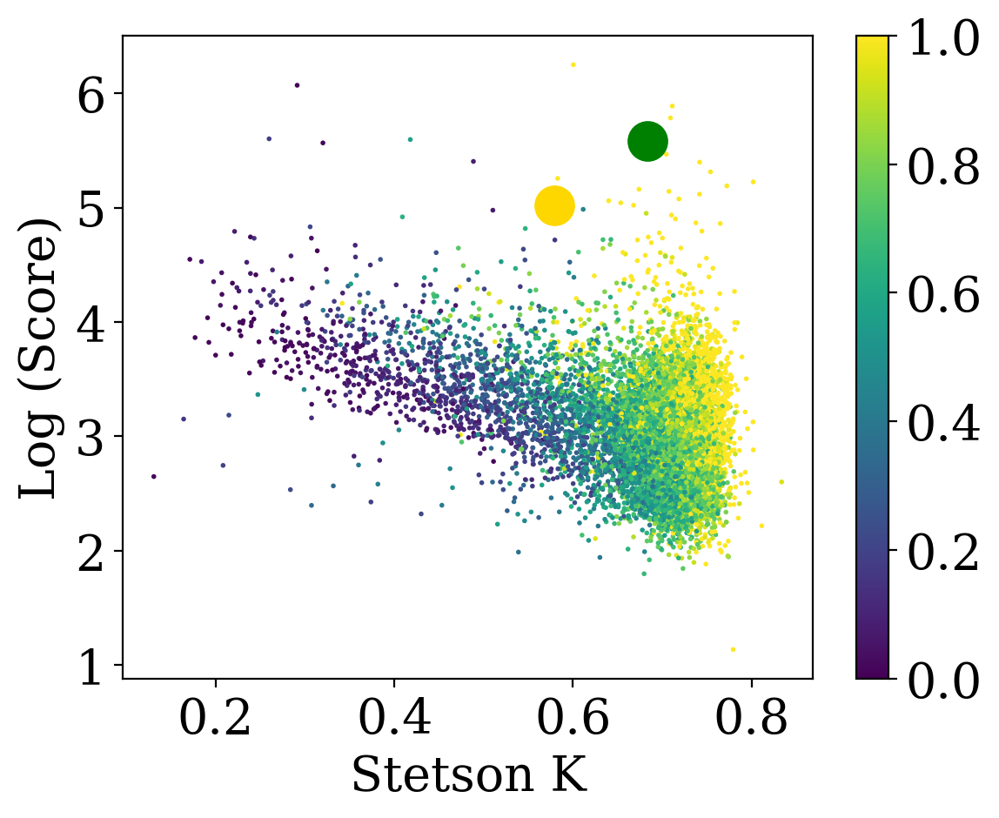

In [174]:
plt.scatter(samp['stetson_k'], np.log10(samp['lc_score']), c=samp['invNeumann'], vmin=0, vmax=0.5, s=1)

plt.scatter(0.579310, np.log10(1.041275e+05), s=250, color='gold')
plt.scatter(0.683569, np.log10(3.804467e+05), s=250, color='green')
plt.xlabel("Stetson K")
plt.ylabel("Log (Score)")
plt.colorbar()

CPU times: user 12.8 s, sys: 3.77 s, total: 16.5 s
Wall time: 21.6 s


(20.67088609198108, 16.320888763200493)

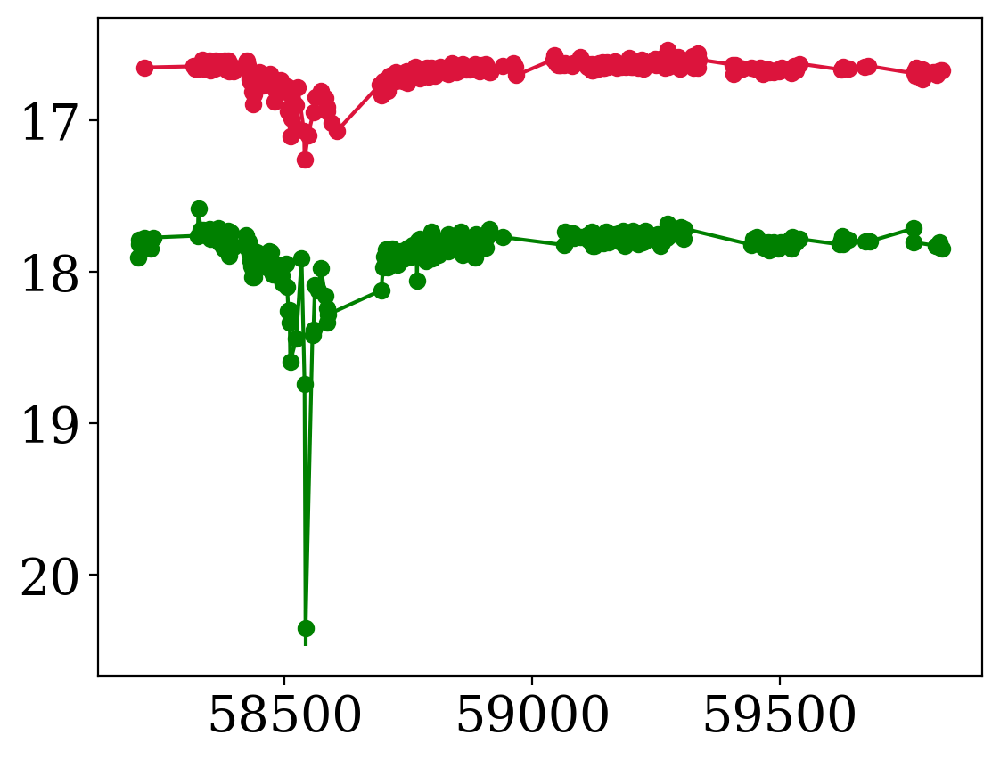

In [147]:
%%time
lc = ens.source.loc[396861565564878848]
lc = lc.compute()

time, mag, magerr = my_tools.prepare_lc(lc['mjd_ztf_zource'].values,
                   lc['mag_ztf_zource'].values, 
                   lc['magerr_ztf_zource'].values, 
                   lc['catflags_ztf_zource'].values,
                   lc['band_ztf_zource'].values, band_of_study='r', flag_good=0)

timeg, magg, magerrg = my_tools.prepare_lc(lc['mjd_ztf_zource'].values,
                   lc['mag_ztf_zource'].values, 
                   lc['magerr_ztf_zource'].values, 
                   lc['catflags_ztf_zource'].values,
                   lc['band_ztf_zource'].values, band_of_study='g', flag_good=0)


plt.errorbar(time, mag, magerr, fmt='-o', color='Crimson')
plt.errorbar(timeg, magg, magerrg, fmt='-o', color='green')

plt.ylim(plt.ylim()[::-1])

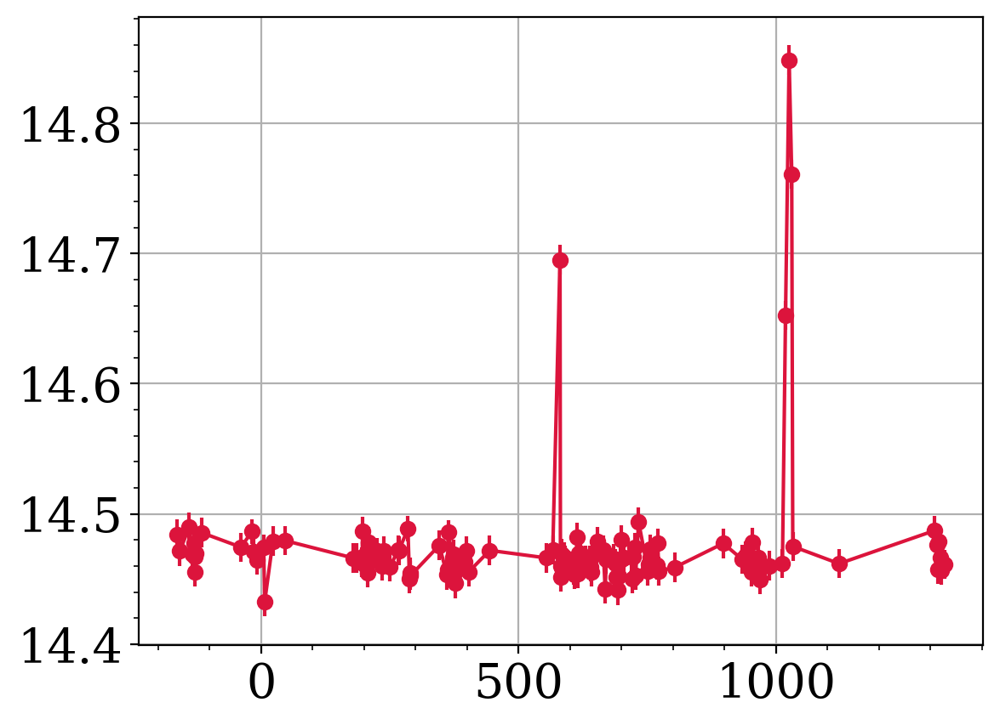

In [74]:
plt.errorbar(time-58_500, mag, magerr, fmt='-o', color='Crimson')


plt.grid()
plt.minorticks_on()